In [1]:
import omicverse as ov
import scanpy as sc
import matplotlib
import matplotlib.pyplot as plt
import gc
import os


   ____            _     _    __                  
  / __ \____ ___  (_)___| |  / /__  _____________ 
 / / / / __ `__ \/ / ___/ | / / _ \/ ___/ ___/ _ \ 
/ /_/ / / / / / / / /__ | |/ /  __/ /  (__  )  __/ 
\____/_/ /_/ /_/_/\___/ |___/\___/_/  /____/\___/                                              

Version: 1.6.3, Tutorials: https://omicverse.readthedocs.io/


In [3]:
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

In [85]:
import pyVIA.core as via

2024-05-22 14:30:12.535176: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-05-22 14:30:18.369914: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda-12.2/lib64:
2024-05-22 14:30:18.370408: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda-12.2/lib64:
2024-05-22 14:30:18.370446: W tensorflow/compiler/tf2tensorrt/utils/py_uti

/mnt/data/env/pyomic/lib/python3.8/site-packages/phate/__init__.py


In [86]:
import pyVIA.core as via
import pyVIA.datasets_via as   datasets

In [87]:
from pyVIA.core import *
import pyVIA.datasets_via as datasets_via

## photoreceptor cell extraction

In [4]:
rna=sc.read_h5ad('/mnt/home/yihanzhao/RB/data_new/rna_anno.h5ad')

In [11]:
adata=rna

In [12]:
adata = adata[adata.obs['celltype']!='AC']
adata = adata[adata.obs['celltype']!='BC']
adata = adata[adata.obs['celltype']!='FB']
adata = adata[adata.obs['celltype']!='HC']
adata = adata[adata.obs['celltype']!='LC']
adata = adata[adata.obs['celltype']!='MC']
adata =adata[adata.obs['celltype']!='MG']
adata =adata[adata.obs['celltype']!='Müller']
adata =adata[adata.obs['celltype']!='RPE']
adata =adata[adata.obs['celltype']!='RBC']
adata =adata[adata.obs['celltype']!='VC']
adata =adata[adata.obs['celltype']!='Cone-T']
adata =adata[adata.obs['celltype']!='RGC']

<AxesSubplot: title={'center': 'celltype'}, xlabel='X_mde_scVI1', ylabel='X_mde_scVI2'>

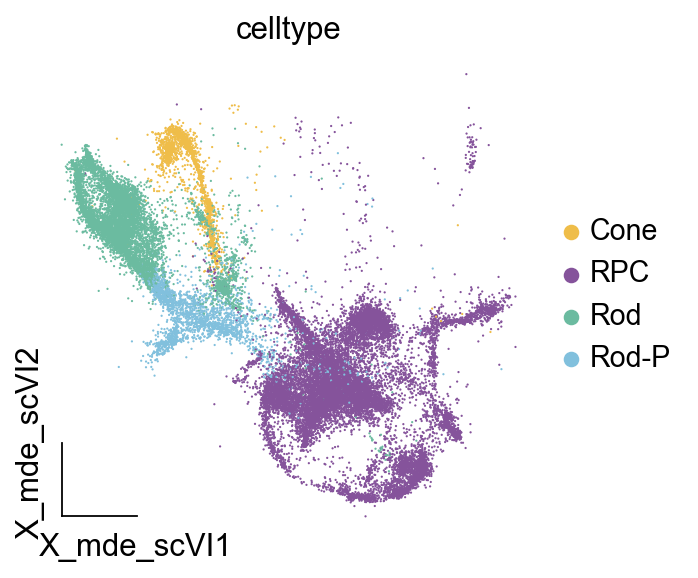

In [15]:
ov.utils.embedding(adata,
                basis='X_mde_scVI',frameon='small',#palette=ov.utils.orange_color[:2]+ov.utils.red_color[7:8]+ov.utils.blue_color[1:],
                color=['celltype'],show=False)

## re-annotation

In [24]:
sc.pp.neighbors(adata, use_rep="X_scVI", metric="cosine",n_neighbors=20, random_state = 112)
sc.tl.leiden(adata)
sc.tl.paga(adata)
sc.pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(adata,init_pos='paga')

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
running Leiden clustering
    finished: found 18 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:04)
running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)


In [26]:
small_marker_dict={
    'Rod': ['NRL','NR2E3','GNAT1','GRM8'],
    'Rod pre': ['CRX','RCVRN'],
    #'Tumor cells':['HELLS','MCM3','PCNA'],
    'CPC':['ARR3','GUCA1A','RXRG'],
 'P-photoreceptor':['APOLD1','ASMP','CENPF'],
    'RPC': ['SOX2','CCND1','SFRP2'],
'Middle':['EGFLAM','CAMK1D'],
    #'STER':['BASP1','EHMT2'],
    'TCR':['USPL1','ZFAS1'],
    'Cone': ['PDE6H','GUCA1C','ARR3','GNAT2'],
'photo':['SYT1','PDC'],
    'stem':['TUBA1A','RBP1']
}
# check if the markers are in the data
smarker_genes_in_data = dict()
for ct, markers in small_marker_dict.items():
    markers_found = list()
    for marker in markers:
        if marker in adata.raw.var_names:
            markers_found.append(marker)
    smarker_genes_in_data[ct] = markers_found
#del [] # remove the last marker
del_markers = list()
for ct, markers in smarker_genes_in_data.items():
    if markers==[]:
        del_markers.append(ct)
for ct in del_markers:
    del smarker_genes_in_data[ct]

Storing dendrogram info using `.uns['dendrogram_leiden']`
categories: 0, 1, 2, etc.
var_group_labels: Rod, Rod pre, CPC, etc.


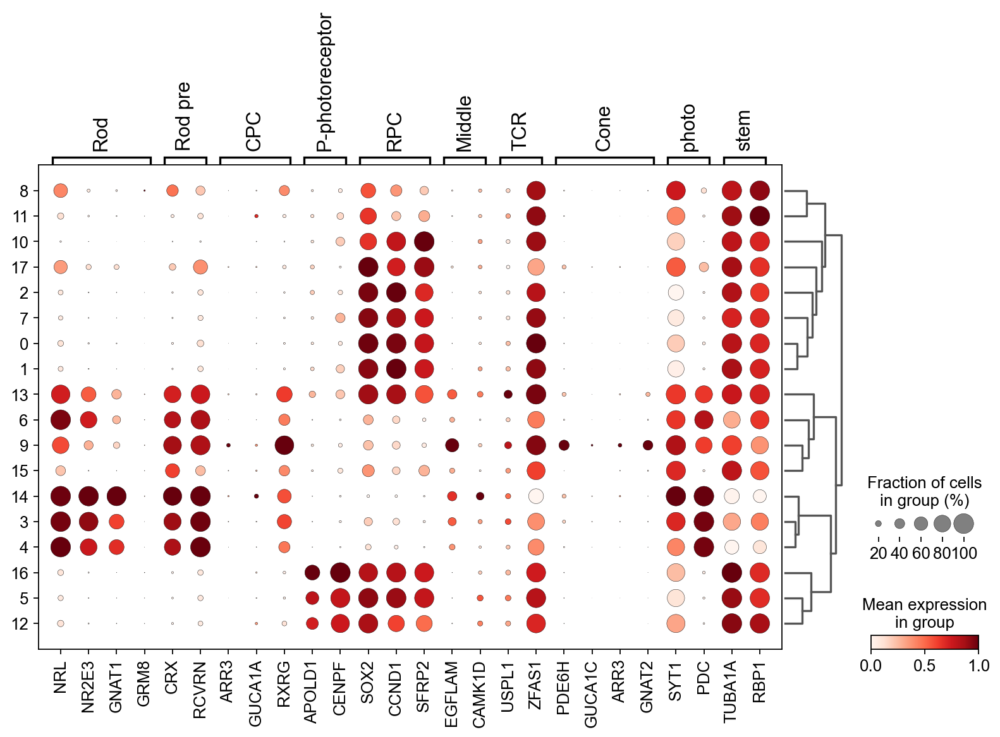

In [27]:
sc.tl.dendrogram(adata,groupby='leiden',use_rep='X_scVI')
sc.pl.dotplot(
    adata,
    groupby="leiden",
    var_names=smarker_genes_in_data,
    dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
)

In [37]:
cluster2annotation = {
    '0': 'RPC',#1
    '1': 'RPC',#1
    '2': 'RPC',#1
    '3': 'Rod pre',#1
    '4': 'Rod pre',#1
    '5': 'P-p',#1
    '6': 'Rod pre',#1
    '7': 'RPC',#1
    '8': 'RSC',#
    '9': 'Cone',#1
    '10': 'RPC',#1
    '11': 'RSC',#1
    '12': 'P-p',#1
    '13': 'CPC',#1
    '14': 'Rod',#1
    '15': 'Cone',#
    '16': 'P-p',#1
    '17': 'RPC',#1
}
adata.obs['celltype'] = adata.obs['leiden'].map(cluster2annotation).astype('category')

<AxesSubplot: title={'center': 'celltype'}, xlabel='X_mde_scVI1', ylabel='X_mde_scVI2'>

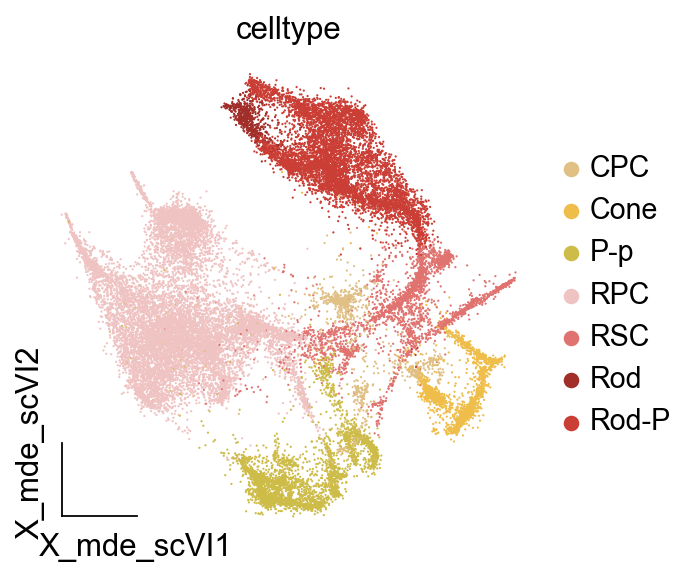

In [18]:
ov.utils.embedding(retina,
                basis='X_mde_scVI',frameon='small',palette=ov.utils.orange_color[5:6]+ov.utils.orange_color[0:1]+ov.utils.orange_color[6:7]+ov.utils.red_color[:2]+ov.utils.red_color[3:4]+ov.utils.red_color[2:3],
                color=['celltype'],show=False)

In [44]:
adata.write_h5ad('/mnt/home/yihanzhao/RB/data_new/retina_rna_ganguang.h5ad',compression='gzip')

In [10]:
retina.uns['celltype_colors']

array(['#e1c085', '#efbd49', '#cebc49', '#f0c3c3', '#e07370', '#a22e2a',
       '#cb3e35'], dtype=object)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_celltype']`


{'mainplot_ax': <AxesSubplot: >,
 'group_extra_ax': <AxesSubplot: >,
 'gene_group_ax': <AxesSubplot: >,
 'size_legend_ax': <AxesSubplot: title={'center': 'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot: title={'center': 'Mean expression\nin group'}>}

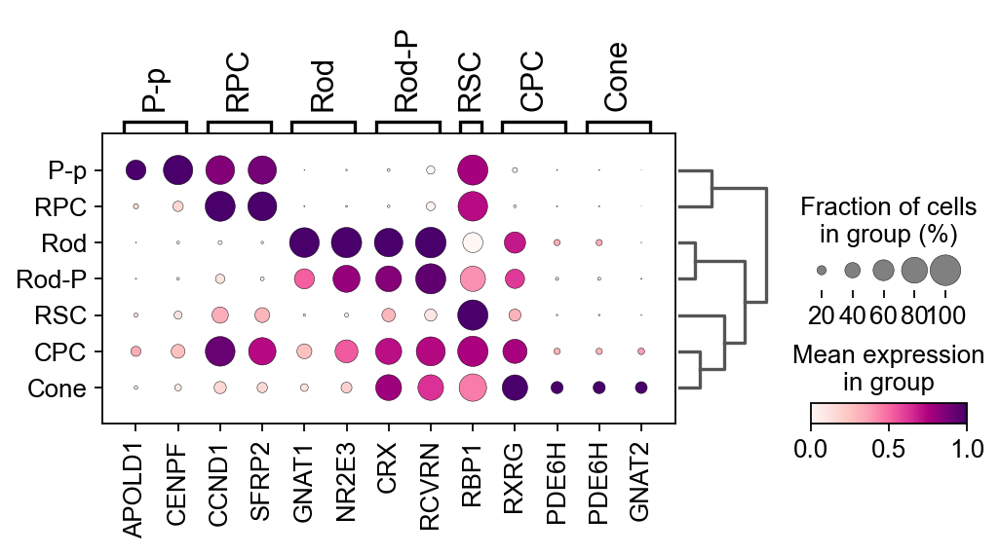

In [19]:
retina_dict={
    'P-p':['APOLD1','CENPF'],
    'RPC': ['CCND1','SFRP2'],
    'Rod': ['GNAT1','NR2E3'],
    'Rod-P': ['CRX','RCVRN'],
    'RSC':['RBP1'],
    'CPC':['RXRG','PDE6H'],
    'Cone': ['PDE6H','GNAT2'],
    
}

sc.tl.dendrogram(retina,'celltype')
sc.pl.dotplot(retina, retina_dict, 'celltype', dendrogram=True,standard_scale='var',show=False,cmap= 'RdPu')

## retina-meta-VIA

In [13]:
from scvi.model.utils import mde
retina.obsm["X_mde_scVI"] = mde(retina.obsm["X_scVI"])

In [4]:
retina=sc.read_h5ad('/mnt/home/yihanzhao/RB/data_new/retina_rna_ganguang.h5ad')

In [5]:
meta_obj=ov.single.MetaCell(retina,use_rep='X_scVI',
                            n_metacells=None,
                           use_gpu=False)

Welcome to SEACells!


In [ ]:
%%time
meta_obj.initialize_archetypes()

In [ ]:
%%time
meta_obj.train(min_iter=10, max_iter=50)

In [23]:
meta_obj.save('/mnt/home/yihanzhao/RB/data/retina_model.pkl')

In [19]:
ad=meta_obj.predicted(method='soft',celltype_label='celltype',
                     summarize_layer='lognorm')

100%|████████████████████████████████████████████████████████████████████████████████████| 400/400 [22:31<00:00,  3.38s/it]


In [23]:
ad.write_h5ad('/mnt/home/yihanzhao/RB/data_new/retina_rna_ganguang_soft.h5ad',compression='gzip')

In [24]:
SEACell_purity = meta_obj.compute_celltype_purity('celltype')

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
ov.plot_set()
fig, axes = plt.subplots(1,3,figsize=(4,4))
sns.boxplot(data=SEACell_purity, y='celltype_purity',ax=axes[0],
           color=ov.utils.blue_color[3])
sns.boxplot(data=compactness, y='compactness',ax=axes[1],
           color=ov.utils.blue_color[4])
sns.boxplot(data=separation, y='separation',ax=axes[2],
           color=ov.utils.blue_color[4])
plt.tight_layout()
plt.suptitle('Evaluate of MetaCells',fontsize=13,y=1.05)
for ax in axes:
    ax.grid(False)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['left'].set_visible(True)

In [ ]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4,4))
ov.utils.embedding(
    meta_obj.adata,
    basis="X_mde_scVI",
    color=['celltype'],
    frameon='small',
    title="Meta cells",
    #legend_loc='on data',
    legend_fontsize=14,
    legend_fontoutline=2,
    size=10,
    ax=ax,
    alpha=0.2,
    #legend_loc='', 
    add_outline=False, 
    #add_outline=True,
    outline_color='black',
    outline_width=1,
    show=False,
    #palette=ov.utils.blue_color[:],
    #legend_fontweight='normal'
)
ov.single.plot_metacells(ax,meta_obj.adata,color='#CB3E35',
                                  )

In [22]:
retina_soft

AnnData object with n_obs × n_vars = 400 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap'
    obsm: 'X_umap', 'scaled|original|X_pca'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled'
    obsp: 'connectivities', 'distances'

<AxesSubplot: title={'center': 'Meta Celltype'}, xlabel='X_umap1', ylabel='X_umap2'>

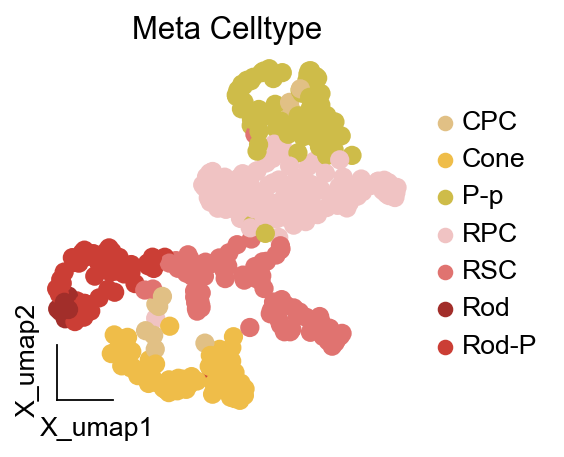

In [21]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(3,3))
ov.utils.embedding(retina_soft,
                   basis='X_umap',
                   color=["celltype"],
                   title='Meta Celltype',
                   frameon='small',
                   legend_fontsize=12,
                   #palette=ov.utils.palette()[11:],
                   ax=ax,
                   show=False)

In [ ]:
v0 = ov.single.pyVIA(adata=retina_soft,adata_key='scaled|original|X_pca',adata_ncomps=15, basis='X_umap',
                         clusters='celltype',knn=20,random_seed=4,root_user=['RSC'],)

v0.run()

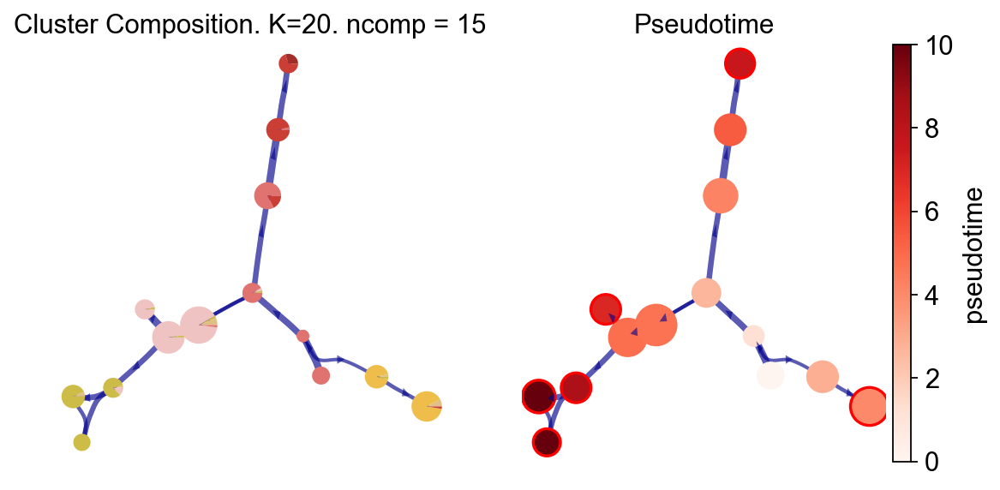

In [32]:
fig, ax, ax1 = v0.plot_piechart_graph(clusters='celltype',cmap='Reds',dpi=80,
                                   show_legend=False,ax_text=False,fontsize=4)

In [260]:
v0.get_pseudotime(v0.adata)
v0.adata

...the pseudotime of VIA added to AnnData obs named `pt_via`


AnnData object with n_obs × n_vars = 400 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap'
    obsm: 'X_umap', 'scaled|original|X_pca'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled'
    obsp: 'connectivities', 'distances'

In [35]:
cfg_obj=ov.single.cellfategenie(retina_soft,pseudotime='pt_via')
cfg_obj.model_init()

$MSE|RMSE|MAE|R^2$:0.003|0.055|0.04|0.95


,coef,abs(coef),values
PTN,-0.015672,0.015672,1.188624
CADPS,-0.013872,0.013872,1.896357
RRM2,0.012770,0.012770,0.499868
LAPTM4B,0.012528,0.012528,2.943801
RASSF4,-0.012065,0.012065,1.339718
...,...,...,...
SAMD12,-0.000011,0.000011,0.203719
DPYS,-0.000011,0.000011,0.077435
GABRA1,-0.000009,0.000009,0.109419
ADCYAP1,-0.000006,0.000006,0.035100


In [36]:
cfg_obj.ATR(stop=500,flux=0.01)

coef_threshold:0.0042374469339847565, r2:0.9436604181905981


,coef_threshold,r2
0,0.013872,0.188017
1,0.012770,0.424037
2,0.012528,0.660211
3,0.012065,0.718668
4,0.011569,0.693957
...,...,...
495,0.003323,0.955038
496,0.003319,0.954915
497,0.003319,0.954827
498,0.003316,0.955114


Text(0.5, 1.0, 'Dentategyrus Metacells\nCellFateGenie')

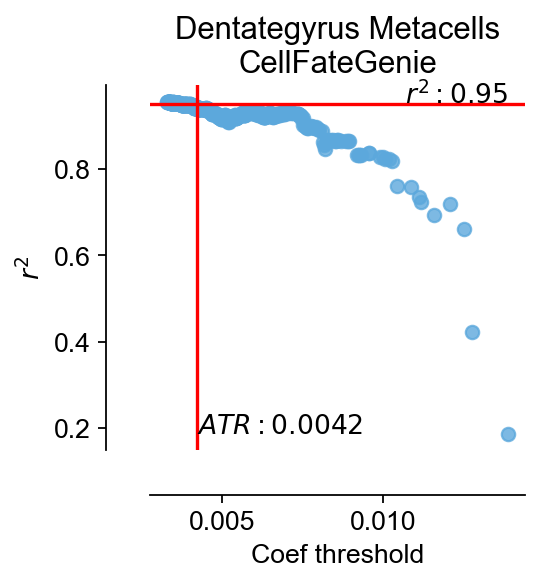

In [37]:
fig,ax=cfg_obj.plot_filtering(color='#5ca8dc')
ax.set_title('Dentategyrus Metacells\nCellFateGenie')

In [38]:
res=cfg_obj.model_fit()

$MSE|RMSE|MAE|R^2$:0.0045|0.067|0.049|0.93


(<Figure size 240x240 with 1 Axes>,
 <AxesSubplot: title={'center': 'Regression RNA\nDimension: 2000'}, xlabel='True pseudotime', ylabel='Predicted pseudotime'>)

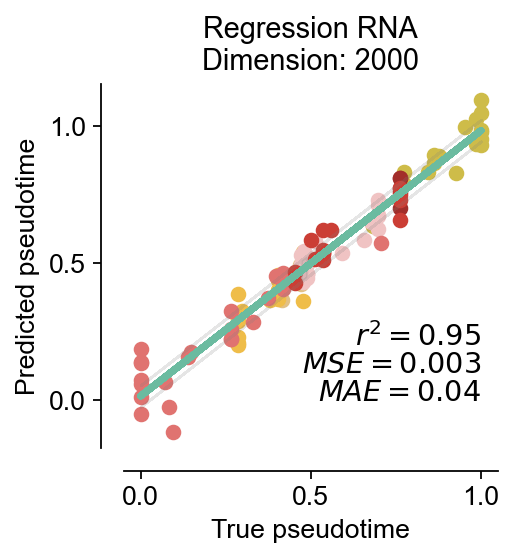

In [39]:
cfg_obj.plot_color_fitting(type='raw',cluster_key='celltype')

(<Figure size 240x240 with 1 Axes>,
 <AxesSubplot: title={'center': 'Regression RNA\nDimension: 308'}, xlabel='True pseudotime', ylabel='Predicted pseudotime'>)

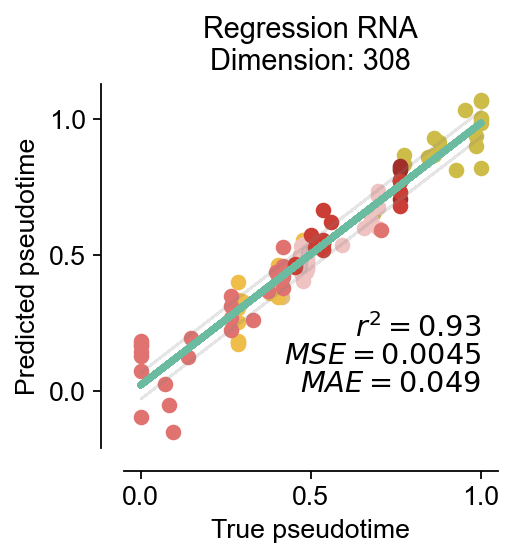

In [40]:
cfg_obj.plot_color_fitting(type='filter',cluster_key='celltype')

In [41]:
kt_filter=cfg_obj.kendalltau_filter()
kt_filter.head()

,kendalltau_sta,pvalue
TRIP13,0.398681,1.822157e-31
RRM2,0.359915,7.692296e-26
INHBB,-0.122403,3.648947e-04
MCM8,0.346522,2.031418e-24
MME,-0.009464,7.893903e-01


In [42]:
var_name=kt_filter.loc[kt_filter['pvalue']<kt_filter['pvalue'].mean()].index.tolist()
gt_obj=ov.single.gene_trends(retina_soft,'pt_via',var_name)
gt_obj.calculate(n_convolve=10)

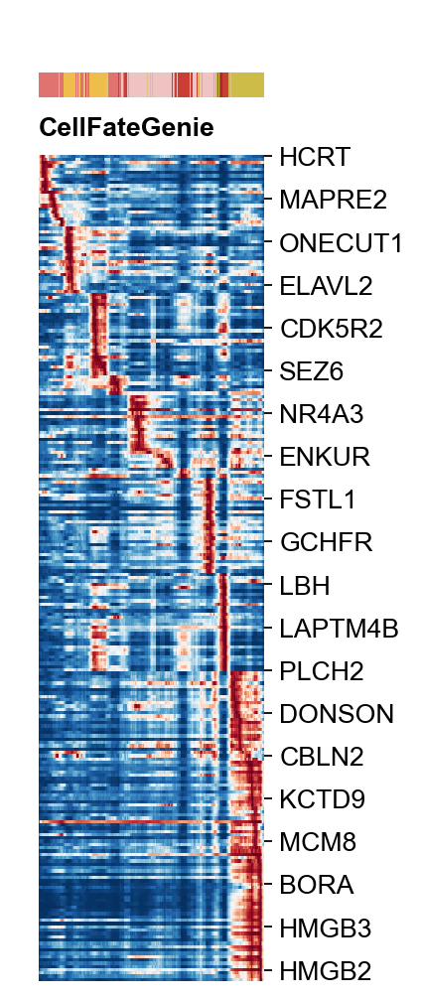

In [43]:
g=ov.utils.plot_heatmap(retina_soft,var_names=var_name,
                  sortby='pt_via',col_color='celltype',
                 n_convolve=10,figsize=(1,6),show=False)

g.fig.set_size_inches(2, 8)
g.fig.suptitle('CellFateGenie',x=0.25,y=0.83,
               horizontalalignment='left',fontsize=12,fontweight='bold')
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(),fontsize=12)
plt.show()

In [73]:
retina_soft.write_h5ad('/mnt/home/yihanzhao/RB/data_new/retina_soft_via.h5ad',compression='gzip')

## Mellon

In [4]:
import numpy as np

import matplotlib
import matplotlib.pyplot as plt

from sklearn.cluster import k_means
import palantir
import mellon
import scanpy as sc

import warnings
from numba.core.errors import NumbaDeprecationWarning

warnings.simplefilter("ignore", category=NumbaDeprecationWarning)

In [5]:
%matplotlib inline

matplotlib.rcParams["figure.figsize"] = [4, 4]
matplotlib.rcParams["figure.dpi"] = 125
matplotlib.rcParams["image.cmap"] = "Spectral_r"
# no bounding boxes or axis:
matplotlib.rcParams["axes.spines.bottom"] = "on"
matplotlib.rcParams["axes.spines.top"] = "off"
matplotlib.rcParams["axes.spines.left"] = "on"
matplotlib.rcParams["axes.spines.right"] = "off"

In [6]:
%matplotlib inline
import omicverse as ov
ov.utils.ov_plot_set()

Dependency error: (numpy 1.26.4 (/mnt/home/yihanzhao/miniconda3/envs/zyh/lib/python3.10/site-packages), Requirement.parse('numpy<1.24,>=1.22'))


In [7]:
retina_soft=sc.read('/mnt/home/yihanzhao/RB/data_new/retina_soft.h5ad')

In [7]:
retina_soft=sc.read_h5ad('/mnt/home/yihanzhao/RB/data_new/retina_soft_via.h5ad')

In [8]:
retina_soft

AnnData object with n_obs × n_vars = 400 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap'
    obsm: 'X_umap', 'scaled|original|X_pca'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled'
    obsp: 'connectivities', 'distances'

In [10]:
ad=retina_soft

In [12]:
%%time
dm_res = palantir.utils.run_diffusion_maps(ad, pca_key="scaled|original|X_pca", n_components=20)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
CPU times: user 5.25 s, sys: 73.5 ms, total: 5.32 s
Wall time: 5.02 s


In [13]:
%%time
model = mellon.DensityEstimator()
log_density = model.fit_predict(ad.obsm["DM_EigenVectors"])

predictor = model.predict

ad.obs["mellon_log_density"] = log_density
ad.obs["mellon_log_density_clipped"] = np.clip(
    log_density, *np.quantile(log_density, [0.05, 1])
)

An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


[2024-10-22 16:47:34,933] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (400) >= n_samples (400) and rank = 1.0.
[2024-10-22 16:47:34,934] [INFO    ] Computing nearest neighbor distances.
[2024-10-22 16:47:35,070] [INFO    ] Using embedding dimensionality d=20. Use d_method="fractal" to enable effective density normalization.
[2024-10-22 16:47:35,219] [INFO    ] Using covariance function Matern52(ls=0.6398522738291597).
[2024-10-22 16:47:35,666] [INFO    ] Using rank 400 covariance representation.
[2024-10-22 16:47:35,796] [INFO    ] Running inference using L-BFGS-B.
[2024-10-22 16:47:36,591] [INFO    ] Computing predictive function.
CPU times: user 2.54 s, sys: 1.17 s, total: 3.72 s
Wall time: 1.74 s


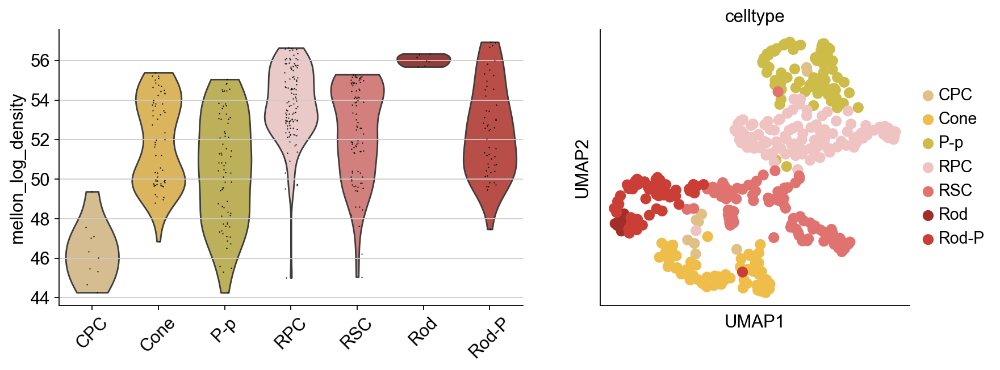

In [16]:
fig, (ax1, ax2) = plt.subplots(1, 2, width_ratios=[3, 2], figsize=[12, 4])
sc.pl.violin(ad, "mellon_log_density", "celltype", rotation=45, ax=ax1, show=False)
sc.pl.scatter(ad, color="celltype", basis="umap", ax=ax2, show=False)
plt.show()

In [17]:
imputed_X = palantir.utils.run_magic_imputation(ad)

In [18]:
ms_data = palantir.utils.determine_multiscale_space(ad)

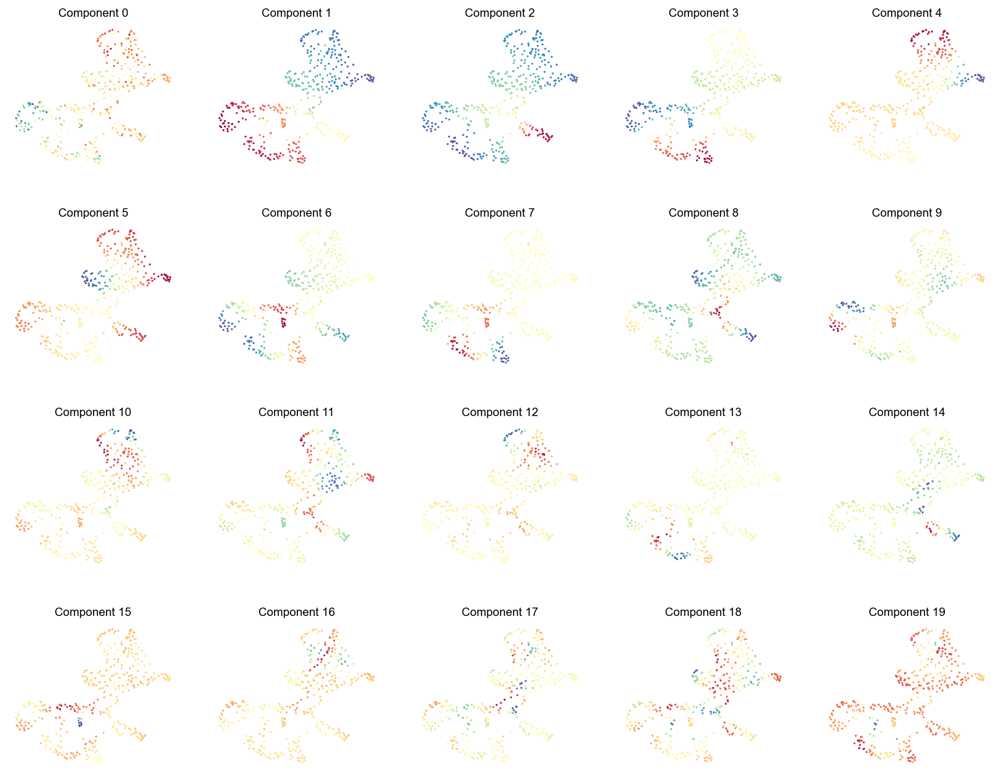

In [21]:
palantir.plot.plot_diffusion_components(ad)
plt.show()

In [22]:
ad.obs['palantir_pseudotime']=retina_soft.obs['pt_via']

In [24]:
import pandas as pd

celltypes_of_branch_1 = ["RSC", "RPC","P-p"]
celltypes_of_branch_2 = ["RSC", "Rod-P","Rod"]
celltypes_of_branch_3 = ["RSC", "CPC","Cone"]

ad.obsm["palantir_lineage_cells"] = pd.DataFrame({
    "branch_1": ad.obs["celltype"].isin(celltypes_of_branch_1),
    "branch_2": ad.obs["celltype"].isin(celltypes_of_branch_2),
    "branch_3": ad.obs["celltype"].isin(celltypes_of_branch_3),
})

In [25]:
ad.obs["palantir_pseudotime"], ad.obsm["palantir_lineage_cells"]

(0      0.984524
 1      0.329068
 2      0.404457
 3      0.484328
 4      0.761785
          ...   
 395    0.487916
 396    0.404457
 397    0.484328
 398    0.404457
 399    0.860719
 Name: palantir_pseudotime, Length: 400, dtype: float64,
      branch_1  branch_2  branch_3
 0        True     False     False
 1        True      True      True
 2       False     False      True
 3        True     False     False
 4       False      True     False
 ..        ...       ...       ...
 395      True     False     False
 396     False     False      True
 397      True     False     False
 398     False     False      True
 399      True     False     False
 
 [400 rows x 3 columns])

In [29]:
# Local variability of genes
palantir.utils.run_local_variability(ad)

# This will add `local_variability` as a layer to anndata
ad

AnnData object with n_obs × n_vars = 400 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via', 'mellon_log_density', 'mellon_log_density_clipped', 'palantir_pseudotime'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap', 'DM_EigenValues'
    obsm: 'X_umap', 'scaled|original|X_pca', 'DM_EigenVectors', 'DM_EigenVectors_multiscaled', 'palantir_lineage_cells'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled', 'MAGIC_imputed_data', 'local_variability'
    obsp: 'connectivities', 'distances', 'DM_Kernel', 'DM_Similarity'

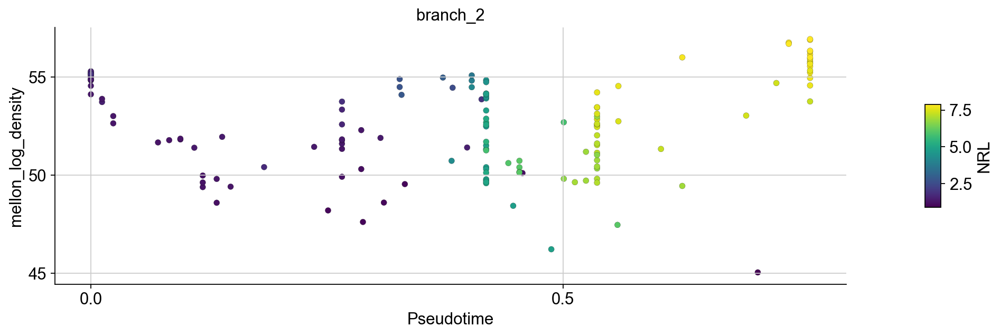

In [31]:
# Local variability  can also be visualized using `plot_branch` function
palantir.plot.plot_branch(
    ad,
    branch_name="branch_2",
    position="mellon_log_density",
    color="NRL",
    color_layer="MAGIC_imputed_data",
    masks_key="palantir_lineage_cells",
    s=100,
    #cmap=matplotlib.cm.Blues,
    edgecolor="black",
    linewidth=0.1,
)
plt.show()

In [32]:
ad.obsm["palantir_lineage_cells"]

,branch_1,branch_2,branch_3
0,True,False,False
1,True,True,True
2,False,False,True
3,True,False,False
4,False,True,False
...,...,...,...
395,True,False,False
396,False,False,True
397,True,False,False
398,False,False,True


### pp

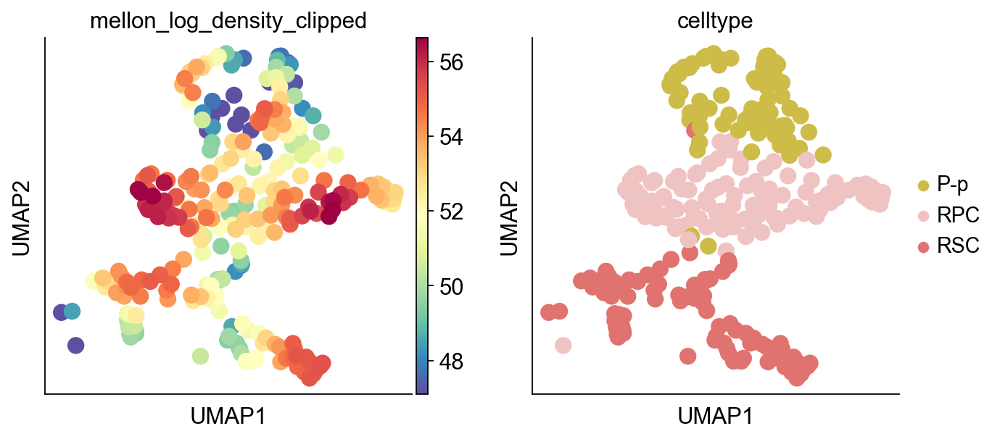

In [33]:
# Plot of UMAP
sc.pl.embedding(
    ad[ad.obsm["palantir_lineage_cells"]["branch_1"]],
    basis="umap",
    color=["mellon_log_density_clipped", "celltype"],
)
plt.show()

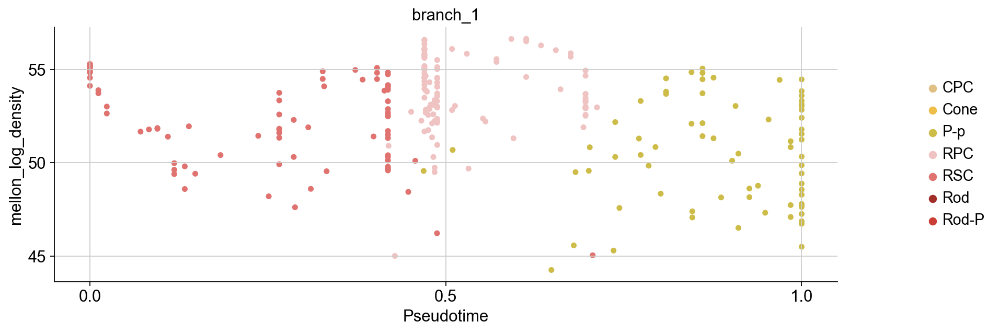

In [34]:
# Compare pseudotime to log density
palantir.plot.plot_branch(
    ad,
    branch_name="branch_1",
    position="mellon_log_density",
    color="celltype",
    masks_key="palantir_lineage_cells",
    s=100,
)
plt.show()

In [39]:
pp_specification_cells = (
    ad.obs["celltype"].isin(["RSC", "RPC", "P-p"])
    & ad.obsm["palantir_lineage_cells"]["branch_1"]
)
ad.obsm["specification"] = pd.DataFrame({"P-p": pp_specification_cells})

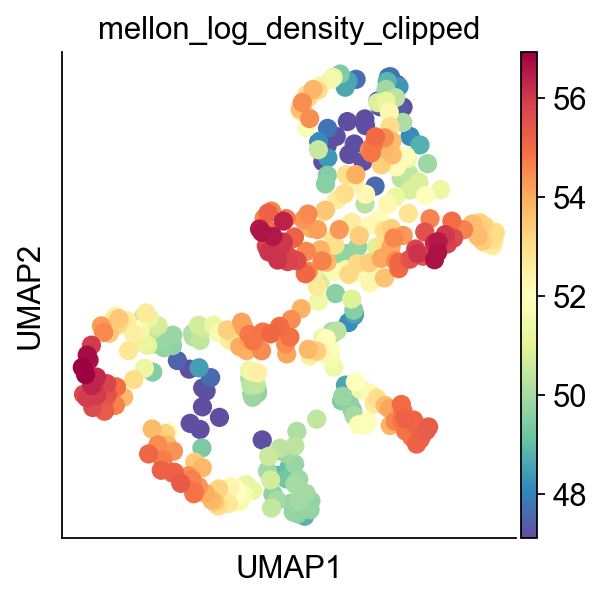

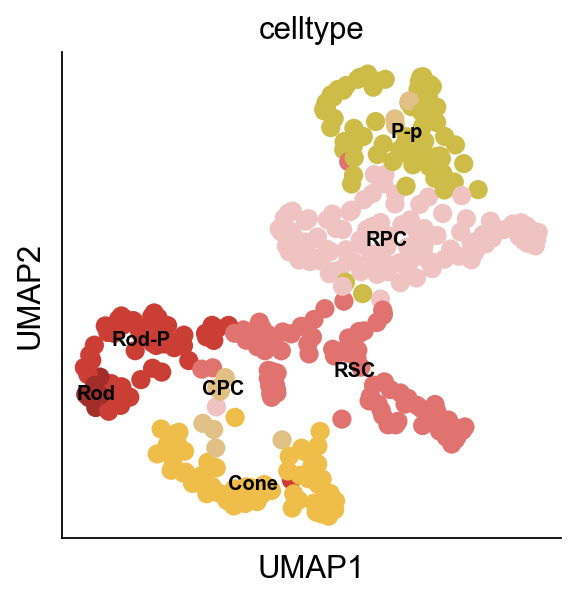

In [42]:
sc.pl.embedding(ad, basis="umap", color=["mellon_log_density_clipped"])
sc.pl.embedding(
    ad,
    basis="umap",
    color=["celltype"],
    legend_loc="on data",
    legend_fontsize=9,
)
plt.show()

In [44]:
ad

AnnData object with n_obs × n_vars = 400 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via', 'mellon_log_density', 'mellon_log_density_clipped', 'palantir_pseudotime', 'mellon_log_density_lowd'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'change_scores_P-p'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap', 'DM_EigenValues'
    obsm: 'X_umap', 'scaled|original|X_pca', 'DM_EigenVectors', 'DM_EigenVectors_multiscaled', 'palantir_lineage_cells', 'specification'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled', 'MAGIC_imputed_data', 'local_variability'
    obsp: 'connectivities', 'distances', 'DM_Kernel', 'DM_Similarity'

In [37]:
# 1. Re-computing density with low intrinsic dimensionality to make sure weights are representative
dm_res = palantir.utils.run_diffusion_maps(ad, pca_key="scaled|original|X_pca", n_components=20)
model = mellon.DensityEstimator(d_method="fractal")
log_density = model.fit_predict(ad.obsm["DM_EigenVectors"])

ad.obs["mellon_log_density_lowd"] = log_density

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
[2024-10-22 18:12:27,700] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (400) >= n_samples (400) and rank = 1.0.
[2024-10-22 18:12:27,701] [INFO    ] Computing nearest neighbor distances.
[2024-10-22 18:12:28,411] [INFO    ] Using d=1.7377184184894936.
[2024-10-22 18:12:28,422] [INFO    ] Using covariance function Matern52(ls=0.6398522738291597).
[2024-10-22 18:12:28,428] [INFO    ] Using rank 400 covariance representation.
[2024-10-22 18:12:28,494] [INFO    ] Running inference using L-BFGS-B.


In [43]:
# 2. Computing scores for each gene
score_key = "change_scores"
palantir.utils.run_low_density_variability(
    ad,
    cell_mask="specification",
    density_key="mellon_log_density_lowd",
    score_key=score_key,
)
plt.show()

In [45]:
scores = ad.var["change_scores_P-p"]
scores.sort_values(ascending=False)

ATOH7     6.922512e-04
HES1      5.052608e-04
RCVRN     4.278104e-04
NRL       4.275809e-04
HES6      4.217257e-04
              ...     
CACNG3    3.994060e-08
PRDM6     2.428304e-08
DPP4      6.695024e-09
OPN1MW    4.257683e-09
GRK7      2.383018e-09
Name: change_scores_P-p, Length: 2000, dtype: float64

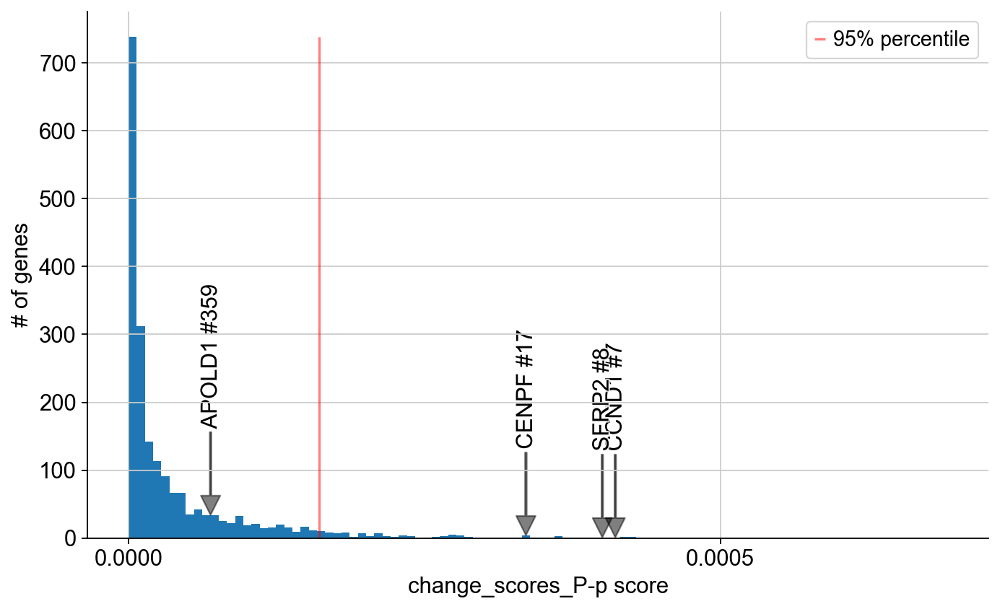

In [47]:
# The scores can be visualized as a histogram. Some important genes are highlgited below
highlight_gene = [ "CCND1", "SFRP2", "APOLD1", "CENPF"]

palantir.plot.gene_score_histogram(ad, "change_scores_P-p", highlight_gene)
plt.show()

In [48]:
percentile = 0.95
percentile_cutoff = np.quantile(scores, percentile)
scores = scores.sort_values(ascending=False)
pp_change_genes = scores.index[scores >= percentile_cutoff]

In [50]:
_ = palantir.presults.compute_gene_trends(ad, ls=5, masks_key="specification")

P-p
[2024-10-22 18:27:20,859] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (500) >= n_samples (270) and rank = 1.0.
[2024-10-22 18:27:20,860] [INFO    ] Using covariance function Matern52(ls=5.0).


In [52]:
ad

AnnData object with n_obs × n_vars = 400 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via', 'mellon_log_density', 'mellon_log_density_clipped', 'palantir_pseudotime', 'mellon_log_density_lowd'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'change_scores_P-p'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap', 'DM_EigenValues'
    obsm: 'X_umap', 'scaled|original|X_pca', 'DM_EigenVectors', 'DM_EigenVectors_multiscaled', 'palantir_lineage_cells', 'specification'
    varm: 'scaled|original|pca_loadings', 'gene_trends_P-p'
    layers: 'lognorm', 'scaled', 'MAGIC_imputed_data', 'local_variability'
    obsp: 'connectivities', 'distances', 'DM_Kernel', 'DM_Similarity'

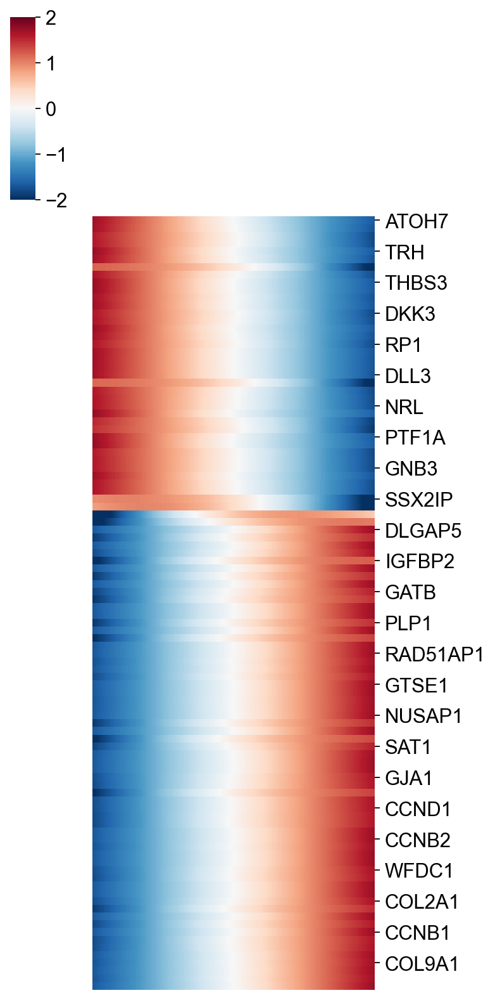

In [70]:
# Alternatively sort by maximum exprression bin for clean visualization
plot_order = selected_trends.idxmax(axis=1).sort_values().index
sns.clustermap(
    selected_trends.loc[plot_order, :],
    z_score=0,
    cmap="RdBu_r",
    col_cluster=False,
    row_cluster=False,
    vmin=-2,
    vmax=2,
    figsize=[5, 10],
    xticklabels=0,
)
plt.show()

### rod

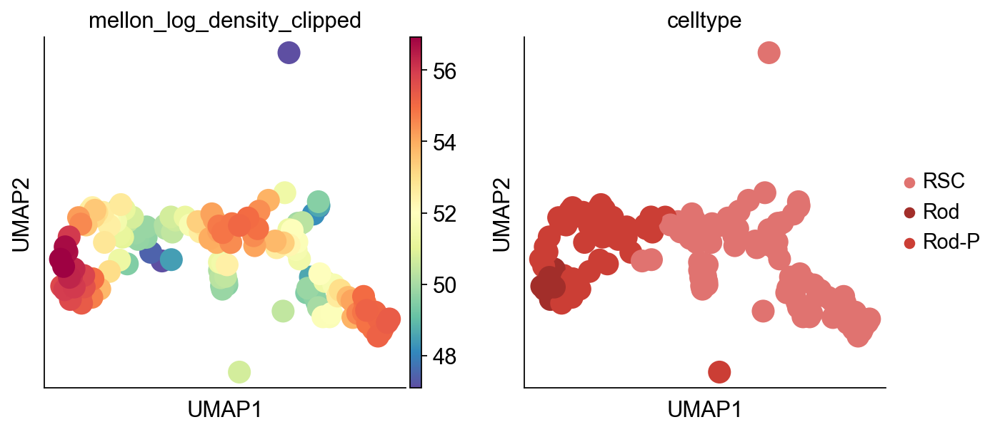

In [71]:
# Plot of UMAP
sc.pl.embedding(
    ad[ad.obsm["palantir_lineage_cells"]["branch_2"]],
    basis="umap",
    color=["mellon_log_density_clipped", "celltype"],
)
plt.show()

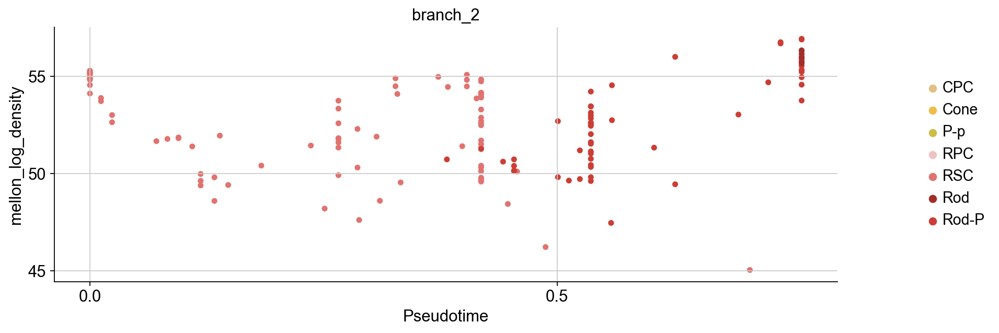

In [72]:
# Compare pseudotime to log density
palantir.plot.plot_branch(
    ad,
    branch_name="branch_2",
    position="mellon_log_density",
    color="celltype",
    masks_key="palantir_lineage_cells",
    s=100,
)
plt.show()

In [73]:
rod_specification_cells = (
    ad.obs["celltype"].isin(["RSC", "Rod-P", "Rod"])
    & ad.obsm["palantir_lineage_cells"]["branch_2"]
)
ad.obsm["specification"] = pd.DataFrame({"Rod": rod_specification_cells})

In [78]:
# 1. Re-computing density with low intrinsic dimensionality to make sure weights are representative
dm_res = palantir.utils.run_diffusion_maps(ad, pca_key="scaled|original|X_pca", n_components=20)
model = mellon.DensityEstimator(d_method="fractal")
log_density = model.fit_predict(ad.obsm["DM_EigenVectors"])

ad.obs["mellon_log_density_lowd"] = log_density

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
[2024-10-22 19:32:47,364] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (400) >= n_samples (400) and rank = 1.0.
[2024-10-22 19:32:47,367] [INFO    ] Computing nearest neighbor distances.
[2024-10-22 19:32:50,214] [INFO    ] Using d=1.7377184184894936.
[2024-10-22 19:32:50,592] [INFO    ] Using covariance function Matern52(ls=0.6398522738291597).
[2024-10-22 19:32:52,117] [INFO    ] Using rank 400 covariance representation.
[2024-10-22 19:32:52,787] [INFO    ] Running inference using L-BFGS-B.


In [79]:
# 2. Computing scores for each gene
score_key = "change_scores"
palantir.utils.run_low_density_variability(
    ad,
    cell_mask="specification",
    density_key="mellon_log_density_lowd",
    score_key=score_key,
)
plt.show()

In [81]:
scores = ad.var["change_scores_Rod"]
scores.sort_values(ascending=False)

DCT         5.033157e-04
FABP7       5.023226e-04
ATOH7       4.905137e-04
RCVRN       4.783526e-04
NRL         4.637677e-04
                ...     
IDI2-AS1    1.860833e-08
OPN1MW      1.829522e-08
ZPLD1       1.419321e-08
PRDM6       1.339367e-08
LMX1A       9.975407e-09
Name: change_scores_Rod, Length: 2000, dtype: float64

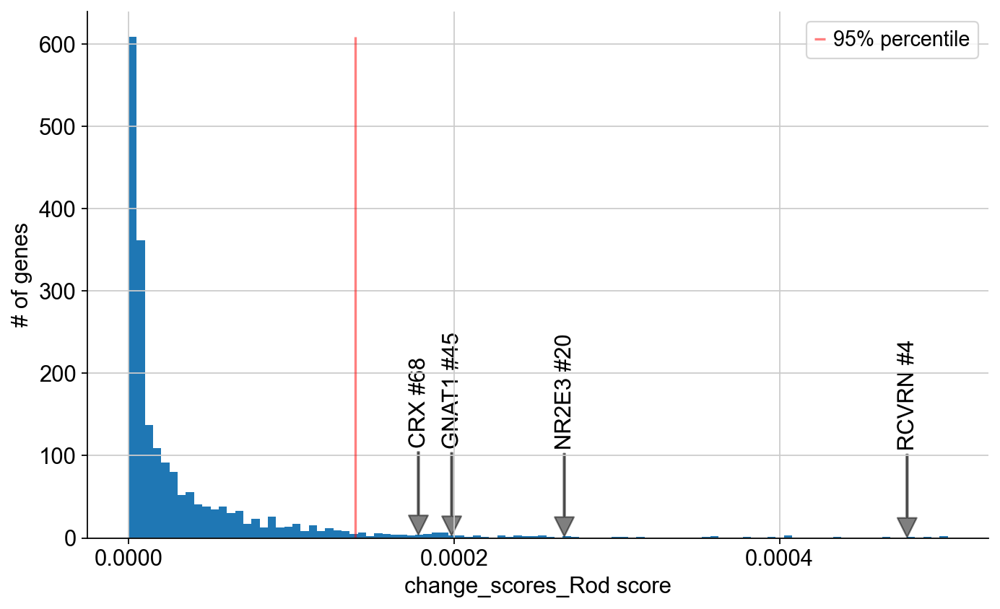

In [82]:
# The scores can be visualized as a histogram. Some important genes are highlgited below
highlight_gene = [ "GNAT1", "NR2E3", "CRX", "RCVRN"]

palantir.plot.gene_score_histogram(ad, "change_scores_Rod", highlight_gene)
plt.show()

In [84]:
percentile = 0.95
percentile_cutoff = np.quantile(scores, percentile)
scores = scores.sort_values(ascending=False)
rod_change_genes = scores.index[scores >= percentile_cutoff]

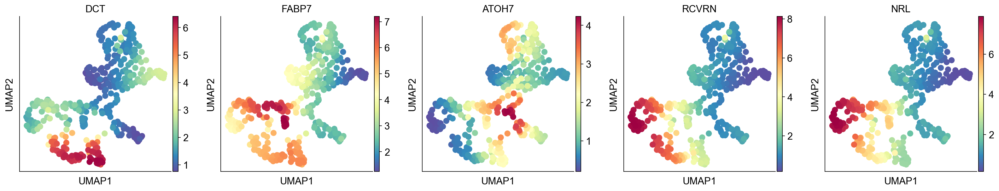

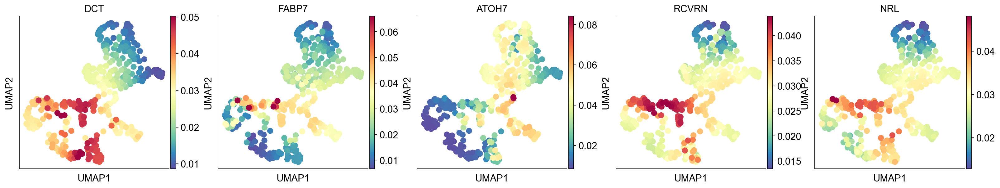

In [85]:
# Visualize the expression and variability of top 5 genes
sc.pl.embedding(
    ad,
    basis="umap",
    color=rod_change_genes[:5],
    layer="MAGIC_imputed_data",
    ncols=5,
)
sc.pl.embedding(
    ad,
    basis="umap",
    color=rod_change_genes[:5],
    layer="local_variability",
    ncols=5,
)
plt.show()

In [86]:
_ = palantir.presults.compute_gene_trends(ad, ls=5, masks_key="specification")

Rod
[2024-10-22 19:36:03,440] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (500) >= n_samples (144) and rank = 1.0.
[2024-10-22 19:36:03,441] [INFO    ] Using covariance function Matern52(ls=5.0).


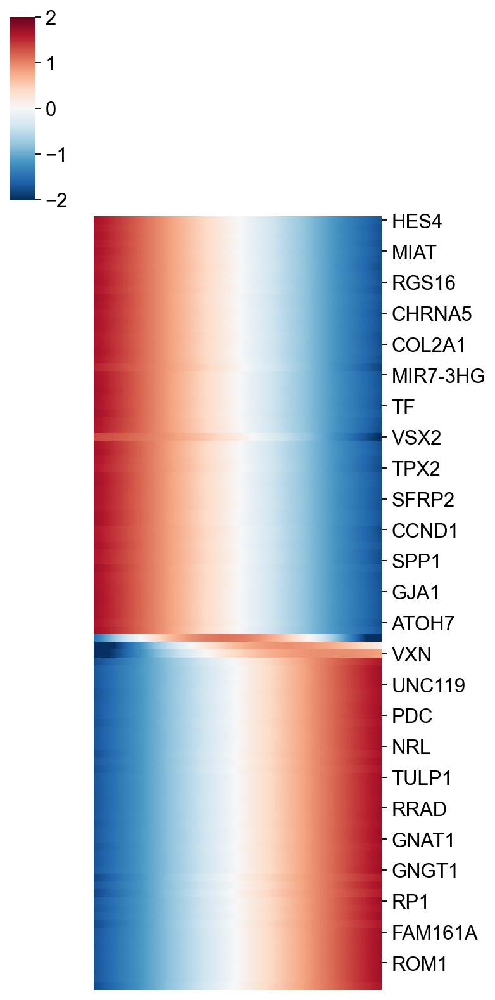

In [90]:
# Alternatively sort by maximum exprression bin for clean visualization
plot_order = selected_trends.idxmax(axis=1).sort_values().index
sns.clustermap(
    selected_trends.loc[plot_order, :],
    z_score=0,
    cmap="RdBu_r",
    col_cluster=False,
    row_cluster=False,
    vmin=-2,
    vmax=2,
    figsize=[5, 10],
    xticklabels=0,
)
plt.show()

### cone

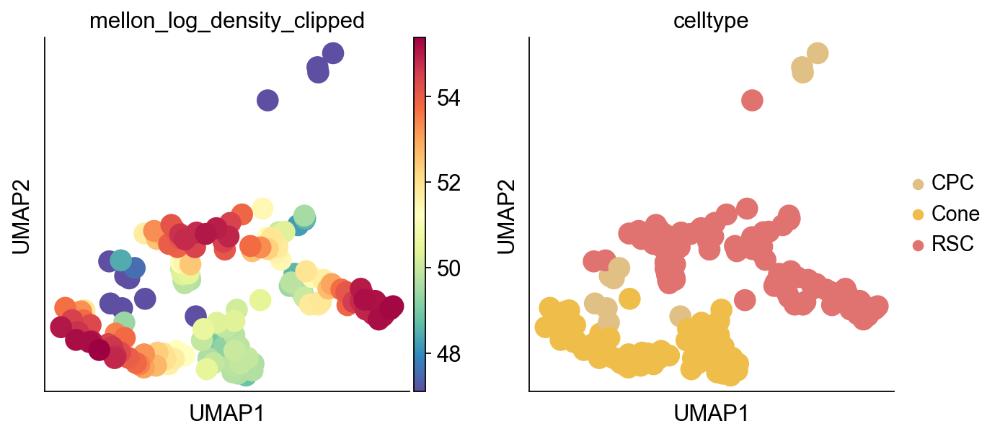

In [93]:
# Plot of UMAP
sc.pl.embedding(
    ad[ad.obsm["palantir_lineage_cells"]["branch_3"]],
    basis="umap",
    color=["mellon_log_density_clipped", "celltype"],
)
plt.show()

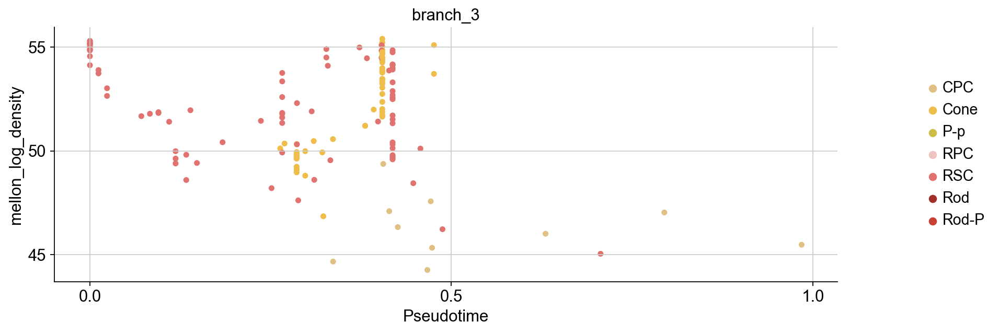

In [94]:
# Compare pseudotime to log density
palantir.plot.plot_branch(
    ad,
    branch_name="branch_3",
    position="mellon_log_density",
    color="celltype",
    masks_key="palantir_lineage_cells",
    s=100,
)
plt.show()

In [96]:
cone_specification_cells = (
    ad.obs["celltype"].isin(["RSC", "CPC", "Cone"])
    & ad.obsm["palantir_lineage_cells"]["branch_3"]
)
ad.obsm["specification"] = pd.DataFrame({"Cone": cone_specification_cells})

In [98]:
# 1. Re-computing density with low intrinsic dimensionality to make sure weights are representative
dm_res = palantir.utils.run_diffusion_maps(ad, pca_key="scaled|original|X_pca", n_components=20)
model = mellon.DensityEstimator(d_method="fractal")
log_density = model.fit_predict(ad.obsm["DM_EigenVectors"])

ad.obs["mellon_log_density_lowd"] = log_density

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
[2024-10-22 22:02:46,010] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (400) >= n_samples (400) and rank = 1.0.
[2024-10-22 22:02:46,011] [INFO    ] Computing nearest neighbor distances.
[2024-10-22 22:02:46,048] [INFO    ] Using d=1.7377184184894936.
[2024-10-22 22:02:46,050] [INFO    ] Using covariance function Matern52(ls=0.6398522738291597).
[2024-10-22 22:02:46,065] [INFO    ] Using rank 400 covariance representation.
[2024-10-22 22:02:46,094] [INFO    ] Running inference using L-BFGS-B.


In [99]:
# 2. Computing scores for each gene
score_key = "change_scores"
palantir.utils.run_low_density_variability(
    ad,
    cell_mask="specification",
    density_key="mellon_log_density_lowd",
    score_key=score_key,
)
plt.show()

In [100]:
scores = ad.var["change_scores_Cone"]
scores.sort_values(ascending=False)

DCT         5.709480e-04
ATOH7       5.687537e-04
RCVRN       4.949180e-04
NRL         4.892739e-04
CCND1       4.425904e-04
                ...     
IDI2-AS1    3.085184e-08
GRK7        2.836067e-08
ZPLD1       2.347221e-08
PRDM6       1.850398e-08
LMX1A       1.341890e-08
Name: change_scores_Cone, Length: 2000, dtype: float64

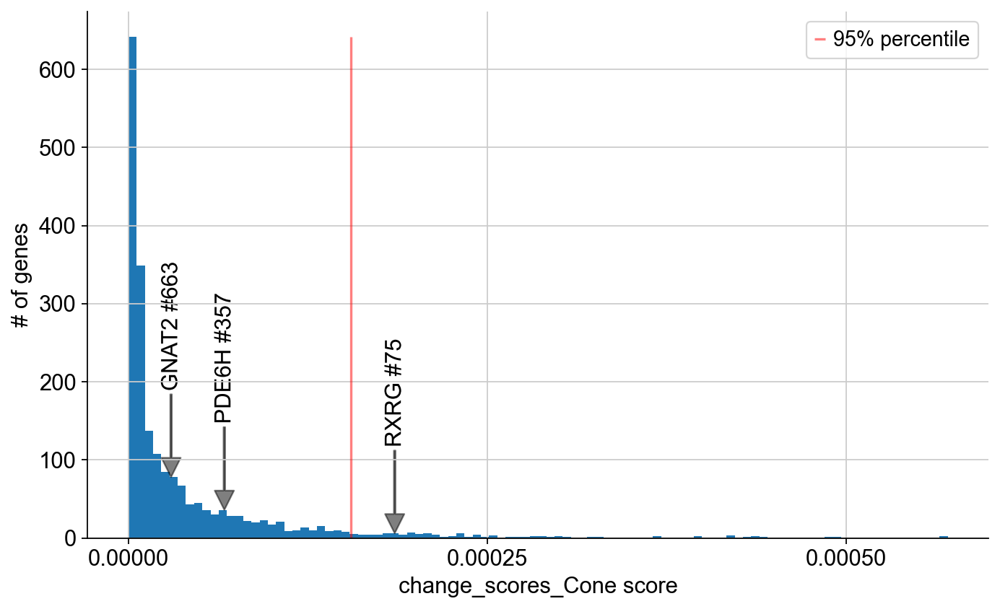

In [101]:
# The scores can be visualized as a histogram. Some important genes are highlgited below
highlight_gene = [ "RXRG", "PDE6H", "GNAT2"]

palantir.plot.gene_score_histogram(ad, "change_scores_Cone", highlight_gene)
plt.show()

In [102]:
percentile = 0.95
percentile_cutoff = np.quantile(scores, percentile)
scores = scores.sort_values(ascending=False)
cone_change_genes = scores.index[scores >= percentile_cutoff]

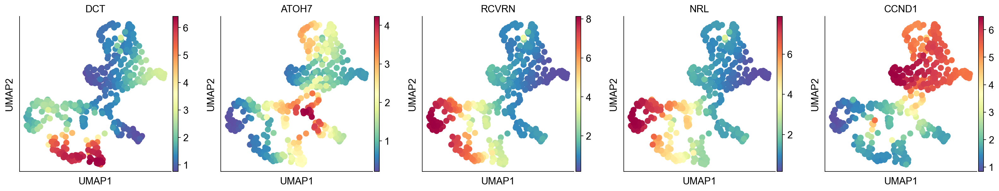

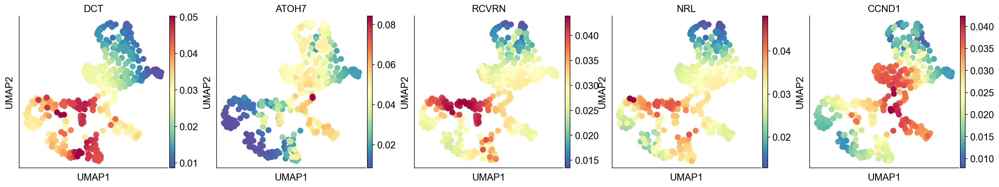

In [103]:
# Visualize the expression and variability of top 5 genes
sc.pl.embedding(
    ad,
    basis="umap",
    color=cone_change_genes[:5],
    layer="MAGIC_imputed_data",
    ncols=5,
)
sc.pl.embedding(
    ad,
    basis="umap",
    color=cone_change_genes[:5],
    layer="local_variability",
    ncols=5,
)
plt.show()

In [104]:
_ = palantir.presults.compute_gene_trends(ad, ls=5, masks_key="specification")

Cone
[2024-10-22 22:05:09,069] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (500) >= n_samples (158) and rank = 1.0.
[2024-10-22 22:05:09,070] [INFO    ] Using covariance function Matern52(ls=5.0).


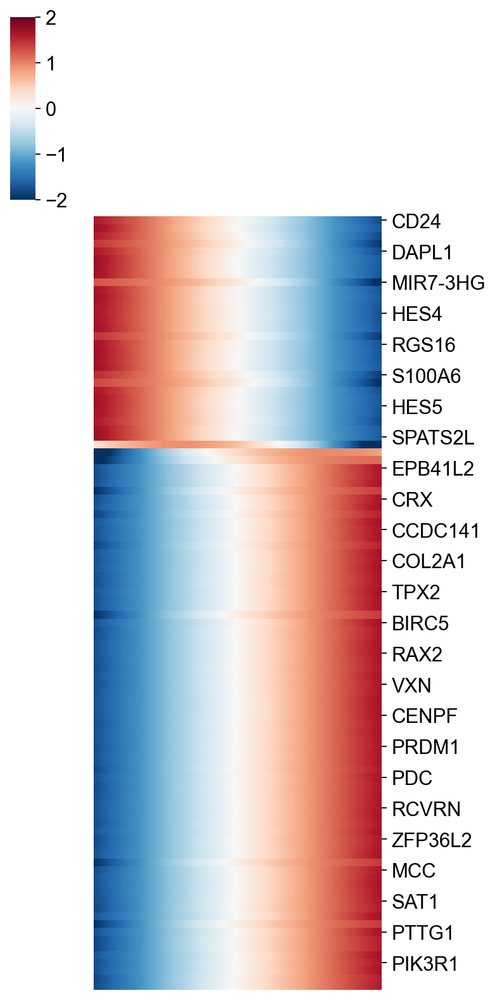

In [106]:
# Alternatively sort by maximum exprression bin for clean visualization
plot_order = selected_trends.idxmax(axis=1).sort_values().index
sns.clustermap(
    selected_trends.loc[plot_order, :],
    z_score=0,
    cmap="RdBu_r",
    col_cluster=False,
    row_cluster=False,
    vmin=-2,
    vmax=2,
    figsize=[5, 10],
    xticklabels=0,
)
plt.show()

## rb-newdata-anno

In [89]:
rb=sc.read_h5ad('/mnt/data/yihan/rna/rna-rb.h5ad')
rb

AnnData object with n_obs × n_vars = 40611 × 20336
    obs: 'tissue', 'domain', 'sample', 'nUMIs', 'mito_perc', 'detected_genes', 'cell_complexity', 'doublet_score', 'predicted_doublet', 'passing_mt', 'passing_nUMIs', 'passing_ngenes', 'n_genes'
    var: 'feature_types', 'mt', 'n_cells', 'percent_cells', 'robust', 'mean', 'var', 'residual_variances', 'highly_variable_rank', 'highly_variable_features'
    uns: 'hvg', 'layers_counts', 'log1p', 'sample_colors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'scrublet'
    obsm: 'X_mde_pca', 'X_mde_scVI', 'X_scVI', 'scaled|original|X_pca'
    varm: 'scaled|original|pca_loadings'
    layers: 'counts', 'lognorm', 'scaled'

In [7]:
sc.pp.neighbors(rb, use_rep="X_scVI", metric="cosine",n_neighbors=20, random_state = 112)
sc.tl.leiden(rb)
sc.tl.paga(rb)
sc.pl.paga(rb, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(rb,init_pos='paga')

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:26)
running Leiden clustering
    finished: found 24 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:10)
running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:01)
--> added 'pos', the PAGA positions (adata.uns['paga'])
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:19)


<AxesSubplot: title={'center': 'leiden'}, xlabel='X_mde_scVI1', ylabel='X_mde_scVI2'>

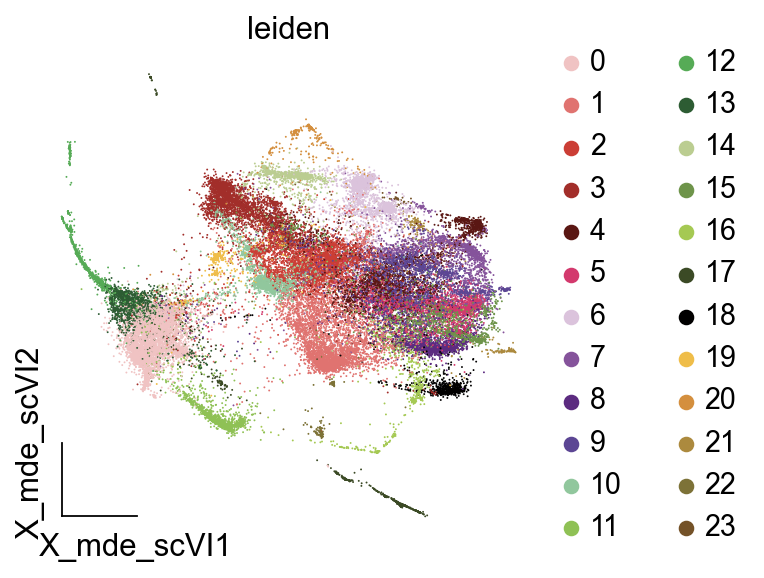

In [16]:
ov.utils.embedding(rb,
                basis='X_mde_scVI',frameon='small',palette=ov.utils.red_color+ov.utils.green_color+ov.utils.orange_color,
                color=['leiden'],show=False)

In [55]:
small_marker_dict={
    'Microglia':['C1QA','HLA-DRA','PTPRC'],
    'AC': ['PAX6'],
    'Rod pre': ['NRL'],
    'LC':['LIM2','CRYAB'],
    'Müller cells': ['VIM','APOE'],
    'Red blood cells':['HBA2','HBA1'],
    'RPC': ['SOX2','CCND1','SFRP2'],
    'RPE':['PMEL','SERPINF1'],
    'FB':['COL1A1','COL1A2','COL3A1'],
    'MC':['CD44'],
    'VC':['TM4SF1','CLDN5'],
    'BC': ['VSX1','CA10'],
    'Cone': ['PDE6H','ARR3','GNB3'],
    'Rod': ['NRL','NR2E3','GNAT1'],
    'HC':['STMN2'],
    'Cone-tumor':['HELLS','MCM3','PCNA'],
    'RGC': ['ISL1','NEFL','GAP43'],
    'CPC':['RXRG','PCNA'],
    'retino':['CDCA7'],
    'MK167+':['MK167']
}
# check if the markers are in the data
smarker_genes_in_data = dict()
for ct, markers in small_marker_dict.items():
    markers_found = list()
    for marker in markers:
        if marker in rb.raw.var_names:
            markers_found.append(marker)
    smarker_genes_in_data[ct] = markers_found
#del [] # remove the last marker
del_markers = list()
for ct, markers in smarker_genes_in_data.items():
    if markers==[]:
        del_markers.append(ct)
for ct in del_markers:
    del smarker_genes_in_data[ct]

In [5]:
cluster2annotation = {
    '0': 'Müller',#?
    '1': 'Cone',#
    '2': 'Rod-T',#
    '3': 'AC',#
    '4': 'Cone-T',#
    '5': 'BC',#
    '6': 'RPE',#
    '7': 'Rod',#
    '8': 'RPC',#
    '9': 'Cone-T',#
    '10': 'Rod-T',#
    '11': 'Müller',#
    '12': 'MG',#
    '13': 'Müller',#
    '14': 'RPE',#
    '15': 'Cone-T',#
    '16': 'Cone',#
    '17': 'FB',#
    '18': 'RPC',#
    '19': 'Rod-T',#
    '20': 'RGC',#
    '21': 'Cone-T',#
    '22': 'Müller',#
    '23': 'RGC',#

}
rb.obs['celltype'] = rb.obs['leiden'].map(cluster2annotation).astype('category')

<AxesSubplot: title={'center': 'leiden'}, xlabel='X_mde_scVI1', ylabel='X_mde_scVI2'>

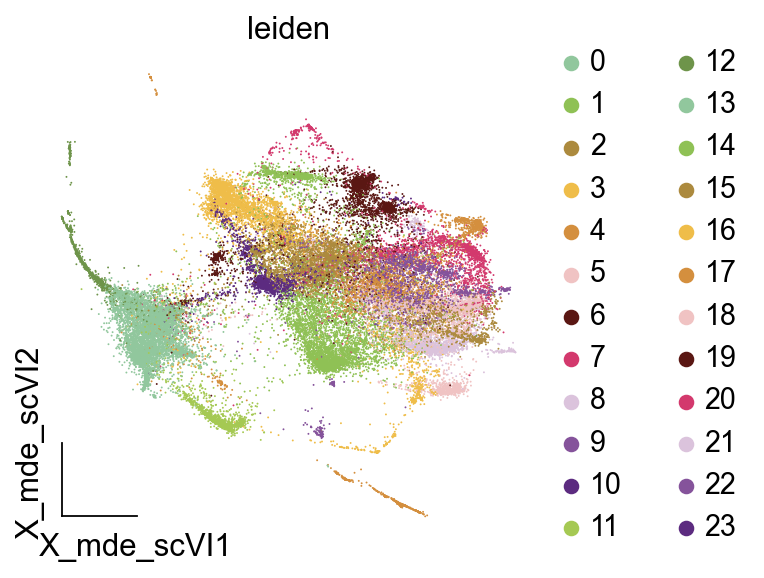

In [11]:
ov.utils.embedding(rb,
                basis='X_mde_scVI',frameon='small',palette=ov.utils.green_color[:2]+ov.utils.orange_color[2:3]+ov.utils.orange_color[:2]+ov.utils.red_color[:1]+ov.utils.red_color[4:9]+ov.utils.green_color[6:7]+ov.utils.green_color[5:6],
                color=['leiden'],show=False)

<AxesSubplot: title={'center': 'celltype'}, xlabel='X_mde_scVI1', ylabel='X_mde_scVI2'>

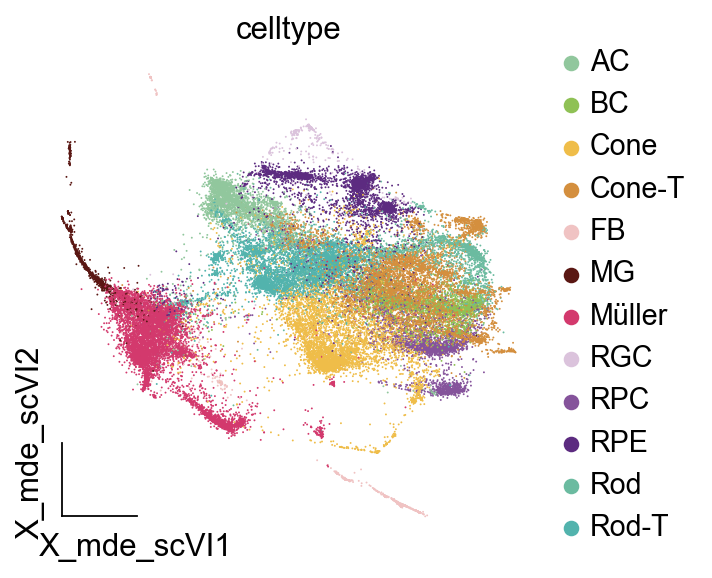

In [6]:
ov.utils.embedding(rb,
                basis='X_mde_scVI',frameon='small',palette=ov.utils.green_color[:2]+ov.utils.orange_color[:2]+ov.utils.red_color[:1]+ov.utils.red_color[4:9]+ov.utils.blue_color[1:2]+ov.utils.blue_color[5:],
                color=['celltype'],show=False)

In [7]:
rb.write_h5ad('/mnt/home/yihanzhao/RB/data_new/rb_anno.h5ad',compression='gzip')

<AxesSubplot: title={'center': 'sample'}, xlabel='X_mde_scVI1', ylabel='X_mde_scVI2'>

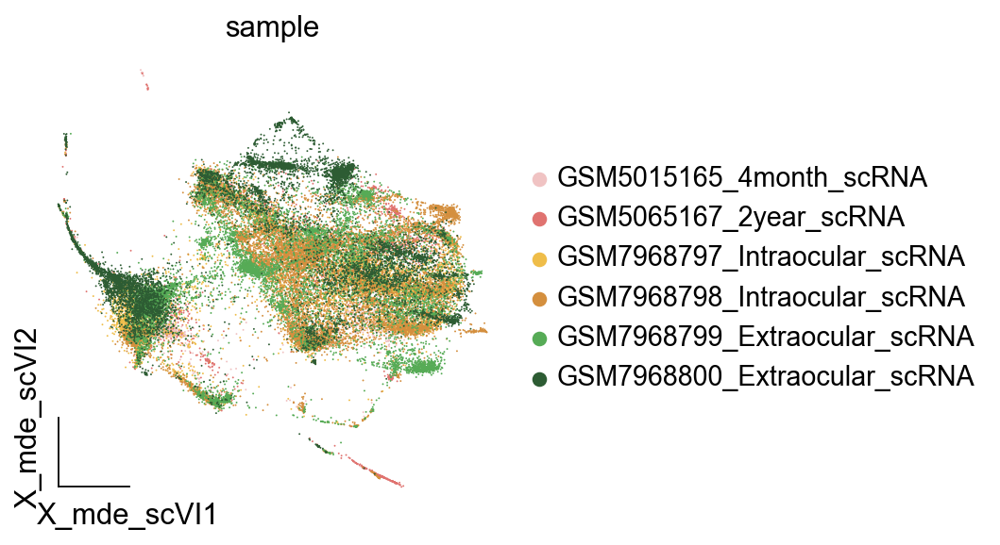

In [22]:
ov.utils.embedding(rb,
                basis='X_mde_scVI',frameon='small',palette=ov.utils.red_color[:2]+ov.utils.orange_color[:2]+ov.utils.green_color[2:],
                color=['sample'],show=False)

## rb-re-anno

In [12]:
adata=rb

In [13]:
adata = adata[adata.obs['celltype']!='AC']
adata = adata[adata.obs['celltype']!='BC']
adata = adata[adata.obs['celltype']!='FB']
adata =adata[adata.obs['celltype']!='Microglia']
adata =adata[adata.obs['celltype']!='Müller cells']
adata =adata[adata.obs['celltype']!='RGC']
adata =adata[adata.obs['celltype']!='RPE']

<AxesSubplot: title={'center': 'celltype'}, xlabel='X_mde_scVI1', ylabel='X_mde_scVI2'>

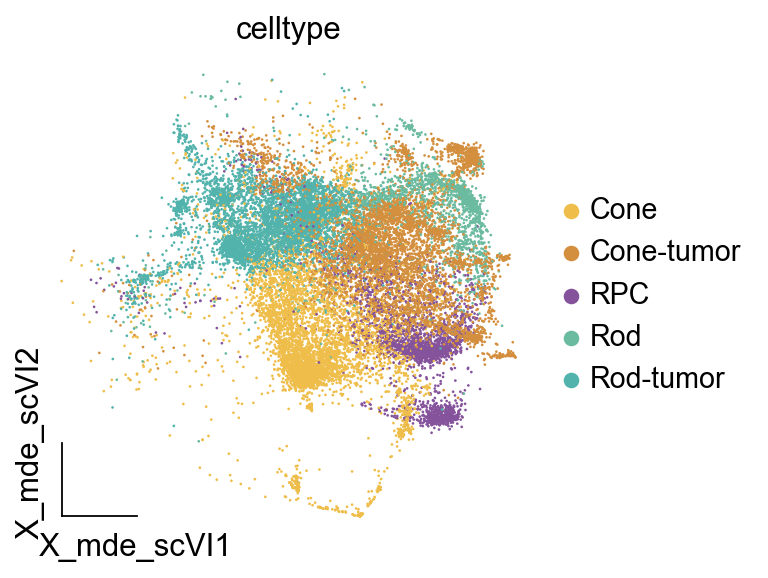

In [15]:
ov.utils.embedding(adata,
                basis='X_mde_scVI',frameon='small',#palette=ov.utils.orange_color[:2]+ov.utils.red_color[7:8]+ov.utils.blue_color[1:2]+ov.utils.blue_color[3:],
                color=['celltype'],show=False)

In [12]:
sc.pp.neighbors(adata, use_rep="X_scVI", metric="cosine",n_neighbors=20, random_state = 112)
sc.tl.leiden(adata)
sc.tl.paga(adata)
sc.pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(adata,init_pos='paga')

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:57)
running Leiden clustering
    finished: found 17 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:08)
running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:01)
--> added 'pos', the PAGA positions (adata.uns['paga'])
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:19)


In [23]:
small_marker_dict={
    'Rod': ['NRL','NR2E3','GNAT1','GRM8','PDC','CA2'],
    'Rod pre': ['CRX','RCVRN'],
    'Tumor cells':['HELLS','MCM3','PCNA'],
    'CPC':['ARR3','GUCA1A','RXRG'],
 'P-photoreceptor':['APOLD1','ASMP','CENPF','GTSE1'],
    'RPC': ['SOX2','CCND1','SFRP2'],
'Middle':['EGFLAM','CAMK1D','ANKRD33B'],
    #'STER':['BASP1','EHMT2','PHACTR1'],
    'TCR':['USPL1','ZFAS1'],
    'Cone': ['PDE6H','GUCA1C','ARR3','GNAT2','STXBP5L','MYO3A','GRM8'],
'photo':['SYT1','PDC'],
    'stem':['TUBA1A','RBP1']
}
# check if the markers are in the data
smarker_genes_in_data = dict()
for ct, markers in small_marker_dict.items():
    markers_found = list()
    for marker in markers:
        if marker in adata.raw.var_names:
            markers_found.append(marker)
    smarker_genes_in_data[ct] = markers_found
#del [] # remove the last marker
del_markers = list()
for ct, markers in smarker_genes_in_data.items():
    if markers==[]:
        del_markers.append(ct)
for ct in del_markers:
    del smarker_genes_in_data[ct]

In [10]:
cluster2annotation = {
    '0': 'TCR',#
    '1': 'Middle',#??
    '2': 'Middle',#
    '3': 'Rod-P',#
    '4': 'CPC',#?
    '5': 'Cone-T',#
    '6': 'Cone-T',#
    '7': 'RSC',#
    '8': 'Cone',#
    '9': 'Rod',#
    '10': 'P-p',#
    '11': 'RSC',#
    '12': 'RSC',#
    '13': 'TCR',#
    '14': 'Rod-P',#
    '15': 'Cone',#
    '16': 'P-p',#
}
adata.obs['celltype'] = adata.obs['leiden'].map(cluster2annotation).astype('category')

<AxesSubplot: title={'center': 'celltype'}, xlabel='X_mde_scVI1', ylabel='X_mde_scVI2'>

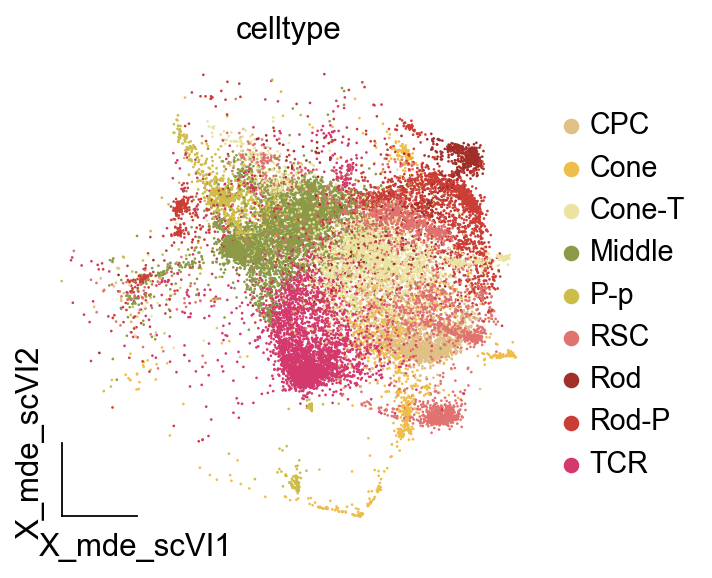

In [11]:
ov.utils.embedding(adata,
                basis='X_mde_scVI',frameon='small',palette=ov.utils.orange_color[5:6]+ov.utils.orange_color[0:1]+ov.utils.orange_color[7:8]+ov.utils.orange_color[9:10]+ov.utils.orange_color[6:7]+ov.utils.red_color[1:2]+ov.utils.red_color[3:4]+ov.utils.red_color[2:3]+ov.utils.red_color[5:],
                color=['celltype'],show=False)

In [12]:
adata.write_h5ad('/mnt/home/yihanzhao/RB/data_new/rb_ganguang_all.h5ad',compression='gzip')

In [13]:
rb=adata

In [6]:
rb.uns['celltype_colors']

array(['#e1c085', '#efbd49', '#ebe3a1', '#8c9a48', '#cebc49', '#e07370',
       '#a22e2a', '#cb3e35', '#d3396d'], dtype=object)

computing PCA
    with n_comps=50
    finished (0:00:31)
Storing dendrogram info using `.uns['dendrogram_celltype']`


{'mainplot_ax': <AxesSubplot: >,
 'group_extra_ax': <AxesSubplot: >,
 'gene_group_ax': <AxesSubplot: >,
 'size_legend_ax': <AxesSubplot: title={'center': 'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot: title={'center': 'Mean expression\nin group'}>}

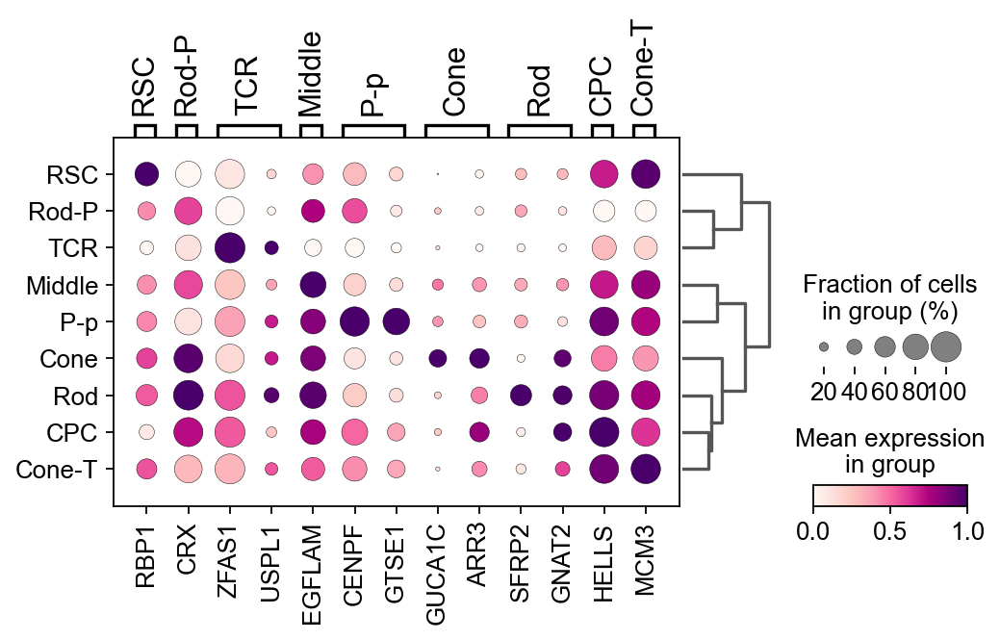

In [14]:
rb_dict={
    'Rod-P': ['CRX'],
    'TCR':['ZFAS1','USPL1'],
    'Cone': ['GUCA1C','ARR3'],
    'Rod': ['SFRP2','GNAT2'],
    'CPC':['HELLS'],
    'Cone-T':['MCM3'],
    'RSC':['RBP1'],
    'Middle':['EGFLAM'],
    'P-p':['CENPF','GTSE1'],

    
    
}

sc.tl.dendrogram(rb,'celltype')
sc.pl.dotplot(rb, rb_dict, 'celltype', dendrogram=True,standard_scale='var',show=False,cmap= 'RdPu')

## rb-meta-VIA

In [7]:
import SEACells

findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.


In [8]:
adata=sc.read_h5ad('/mnt/home/yihanzhao/RB/data_new/rb_via.h5ad')

In [10]:
meta_obj=ov.single.MetaCell(adata,use_rep='X_scVI',
                            n_metacells=None,
                           use_gpu=False)

Welcome to SEACells!


In [ ]:
%%time
meta_obj.initialize_archetypes()

In [ ]:
%%time
meta_obj.train(min_iter=10, max_iter=50)

In [62]:
meta_obj.save('/mnt/home/yihanzhao/RB/data_new/rb_model.pkl')

In [14]:
ad=meta_obj.predicted(method='soft',celltype_label='celltype',
                     summarize_layer='lognorm')

100%|███████████████████████████████████████████████████| 277/277 [12:43<00:00,  2.76s/it]


In [36]:
import omicverse as ov
import scanpy as sc
import scvelo as scv

ov.plot_set()

In [18]:
SEACell_purity = meta_obj.compute_celltype_purity('celltype')
separation = meta_obj.separation(use_rep='X_scVI',nth_nbr=1)
compactness = meta_obj.compactness(use_rep='X_scVI')

Determing nearest neighbor graph...
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
Determing nearest neighbor graph...
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


In [33]:
%matplotlib inline

sns.set_style('ticks')
matplotlib.rcParams['figure.figsize'] = [4, 4]
matplotlib.rcParams['figure.dpi'] = 100

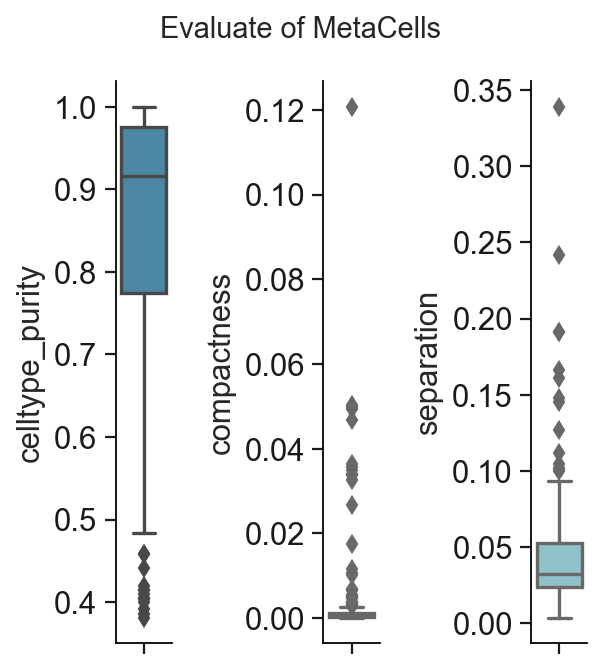

In [25]:
import seaborn as sns
import matplotlib.pyplot as plt
ov.plot_set()
fig, axes = plt.subplots(1,3,figsize=(4,4))
sns.boxplot(data=SEACell_purity, y='celltype_purity',ax=axes[0],
           color=ov.utils.blue_color[3])
sns.boxplot(data=compactness, y='compactness',ax=axes[1],
           color=ov.utils.blue_color[4])
sns.boxplot(data=separation, y='separation',ax=axes[2],
           color=ov.utils.blue_color[4])
plt.tight_layout()
plt.suptitle('Evaluate of MetaCells',fontsize=13,y=1.05)
for ax in axes:
    ax.grid(False)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['left'].set_visible(True)

In [39]:
import scanpy as sc
ad.raw=ad.copy()
sc.pp.highly_variable_genes(ad, n_top_genes=2000, inplace=True)
ad=ad[:,ad.var.highly_variable]

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [40]:
ov.pp.scale(ad)
ov.pp.pca(ad,layer='scaled',n_pcs=30)
sc.pp.neighbors(ad, n_neighbors=15, n_pcs=20,
               use_rep='scaled|original|X_pca')

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


In [41]:
sc.tl.umap(ad)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


In [44]:
ad.obs['celltype']=ad.obs['celltype'].astype('category')
ad.obs['celltype']=ad.obs['celltype'].cat.reorder_categories(adata.obs['celltype'].cat.categories)
ad.uns['celltype_colors']=adata.uns['celltype_colors']

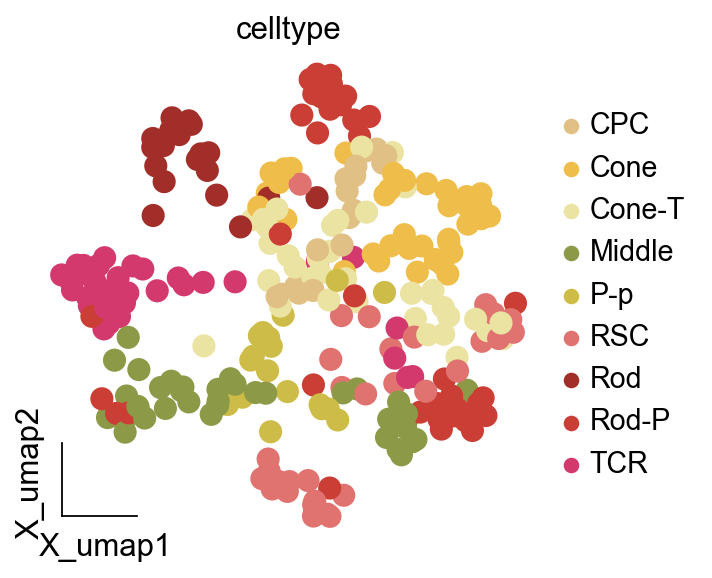

In [9]:
ov.pl.embedding(ad, basis='X_umap',
                color=["celltype"],
                frameon='small',cmap='RdBu_r',
               wspace=0.5)

In [10]:
ad.write_h5ad('/mnt/home/yihanzhao/RB/data_new/rb_soft.h5ad',compression='gzip')

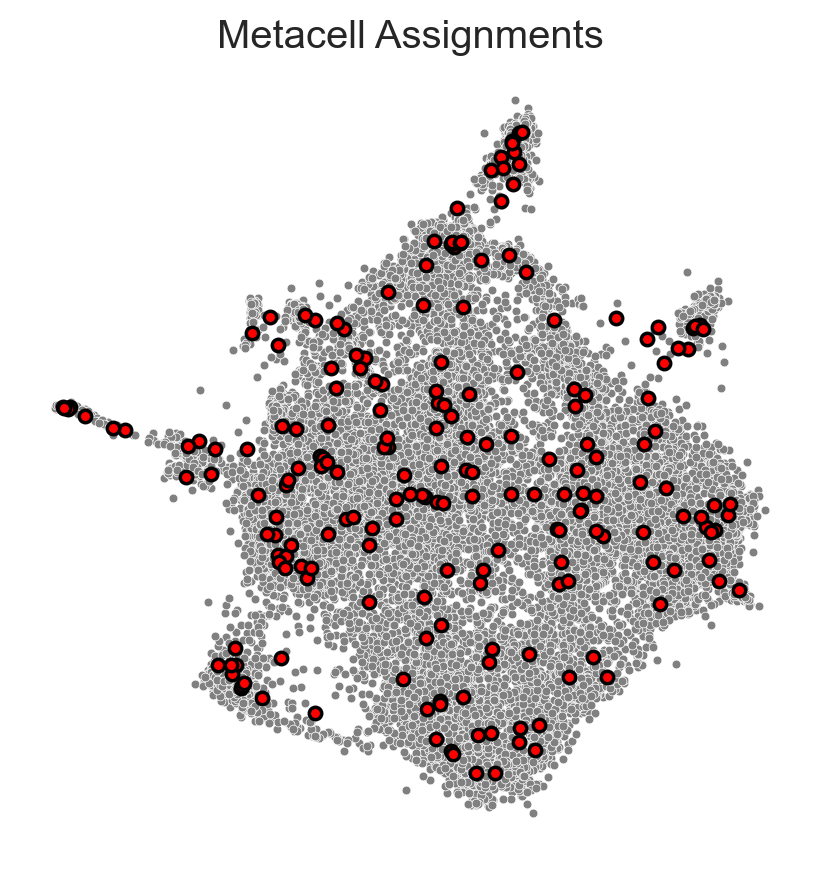

In [174]:
SEACells.plot.plot_2D(adata, key='X_mde_scVI', colour_metacells=False)

In [ ]:
v0 = ov.single.pyVIA(adata=rb_soft,adata_key='scaled|original|X_pca',adata_ncomps=30, basis='X_umap',
                         clusters='celltype',knn=10,random_seed=4,root_user=['RSC'],)

v0.run()

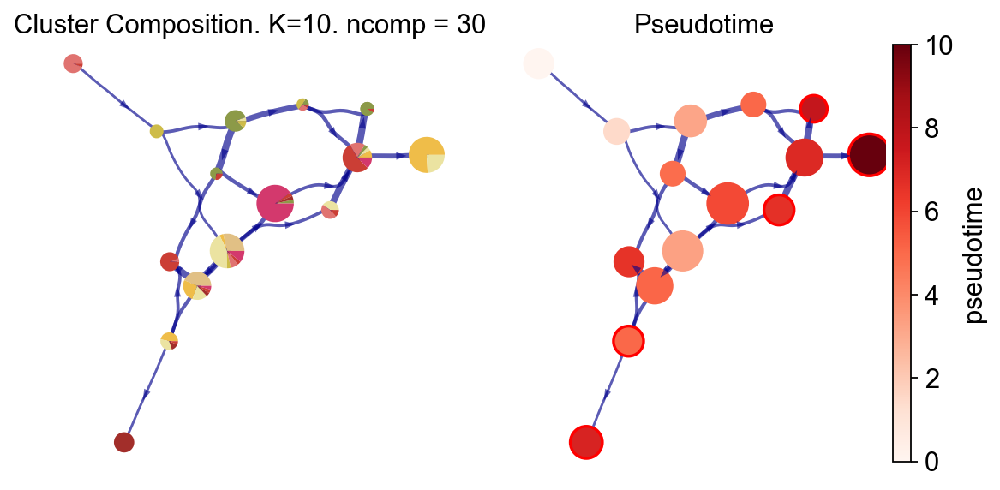

In [58]:
fig, ax, ax1 = v0.plot_piechart_graph(clusters='celltype',cmap='Reds',dpi=80,
                                   show_legend=False,ax_text=False,fontsize=4)

In [59]:
#you can use `v0.model.single_cell_pt_markov` to extract the pseudotime
v0.get_pseudotime(v0.adata)
v0.adata

...the pseudotime of VIA added to AnnData obs named `pt_via`


AnnData object with n_obs × n_vars = 277 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap'
    obsm: 'X_umap', 'scaled|original|X_pca'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled'
    obsp: 'connectivities', 'distances'

In [72]:
cfg_obj=ov.single.cellfategenie(rb_soft,pseudotime='pt_via')
cfg_obj.model_init()

$MSE|RMSE|MAE|R^2$:0.0066|0.081|0.062|0.86


,coef,abs(coef),values
C7orf33,1.691295e-02,1.691295e-02,0.907327
TSPAN7,-1.528476e-02,1.528476e-02,2.189950
HMGA2,-1.431543e-02,1.431543e-02,1.896445
DUSP2,1.392016e-02,1.392016e-02,1.673115
CREG1,1.374143e-02,1.374143e-02,1.152599
...,...,...,...
ZFP36L1,9.091722e-06,9.091722e-06,0.031051
AP001178.3,-8.854468e-06,8.854468e-06,0.025842
NTN4,-7.148557e-06,7.148557e-06,0.024232
MORC4,7.117422e-06,7.117422e-06,0.329336


In [73]:
cfg_obj.ATR(stop=500,flux=0.01)

coef_threshold:0.005134725943207741, r2:0.8532678050359099


,coef_threshold,r2
0,0.015285,0.140714
1,0.014315,0.152258
2,0.013920,0.272606
3,0.013741,0.345500
4,0.013432,0.328993
...,...,...
495,0.003674,0.881704
496,0.003672,0.882096
497,0.003670,0.883214
498,0.003665,0.883030


Text(0.5, 1.0, 'Dentategyrus Metacells\nCellFateGenie')

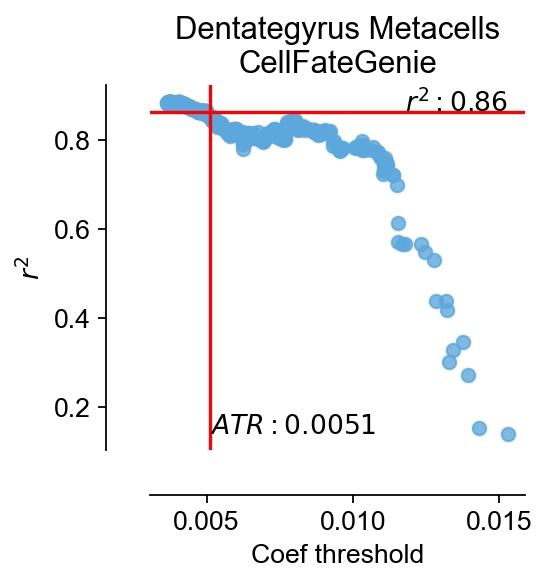

In [74]:
fig,ax=cfg_obj.plot_filtering(color='#5ca8dc')
ax.set_title('Dentategyrus Metacells\nCellFateGenie')

In [75]:
res=cfg_obj.model_fit()

$MSE|RMSE|MAE|R^2$:0.0072|0.085|0.066|0.85


(<Figure size 240x240 with 1 Axes>,
 <AxesSubplot: title={'center': 'Regression RNA\nDimension: 2000'}, xlabel='True pseudotime', ylabel='Predicted pseudotime'>)

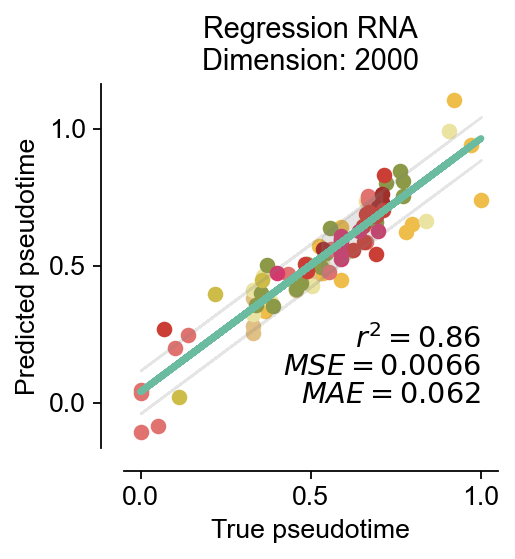

In [76]:
cfg_obj.plot_color_fitting(type='raw',cluster_key='celltype')

(<Figure size 240x240 with 1 Axes>,
 <AxesSubplot: title={'center': 'Regression RNA\nDimension: 286'}, xlabel='True pseudotime', ylabel='Predicted pseudotime'>)

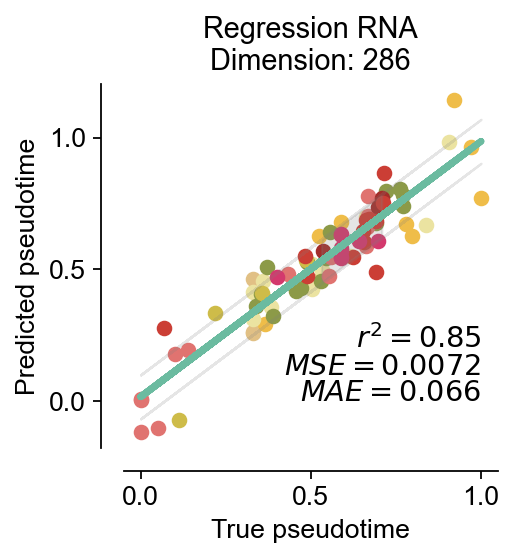

In [77]:
cfg_obj.plot_color_fitting(type='filter',cluster_key='celltype')

In [78]:
kt_filter=cfg_obj.kendalltau_filter()
kt_filter.head()

,kendalltau_sta,pvalue
C7orf33,0.030677,4.498138e-01
TDRG1,0.138714,6.403015e-04
TMEM35A,0.018290,6.522933e-01
CCNE1,-0.281373,4.167410e-12
SLC24A2,-0.086840,3.241340e-02


In [79]:
var_name=kt_filter.loc[kt_filter['pvalue']<kt_filter['pvalue'].mean()].index.tolist()
gt_obj=ov.single.gene_trends(rb_soft,'pt_via',var_name)
gt_obj.calculate(n_convolve=30)

In [80]:
print(f"Dimension: {len(var_name)}")

Dimension: 219


Text(0.5, 1.0, 'Dentategyrus meta\nCellfategenie')

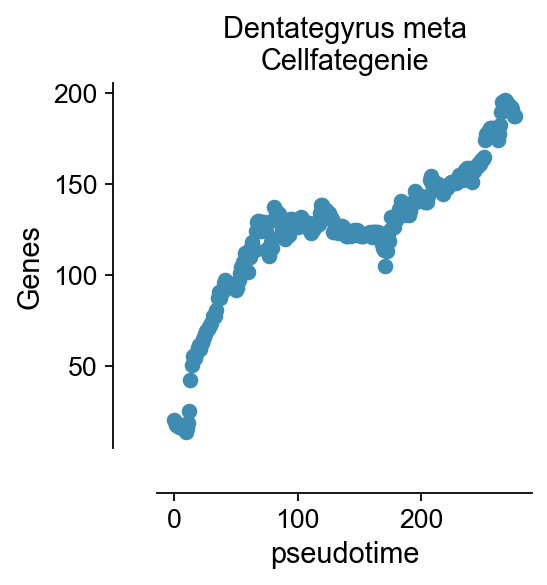

In [81]:
fig,ax=gt_obj.plot_trend(color=ov.utils.blue_color[3])
ax.set_title(f'Dentategyrus meta\nCellfategenie',fontsize=13)

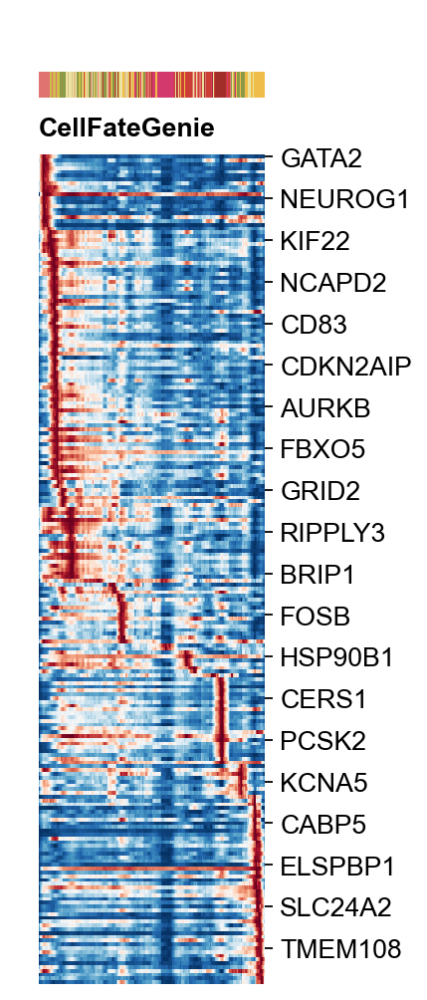

In [82]:
g=ov.utils.plot_heatmap(rb_soft,var_names=var_name,
                  sortby='pt_via',col_color='celltype',
                 n_convolve=10,figsize=(1,6),show=False)

g.fig.set_size_inches(2, 8)
g.fig.suptitle('CellFateGenie',x=0.25,y=0.83,
               horizontalalignment='left',fontsize=12,fontweight='bold')
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(),fontsize=12)
plt.show()

In [25]:
rb_soft.write_h5ad('/mnt/home/yihanzhao/RB/data_new/rb_soft_via.h5ad',compression='gzip')

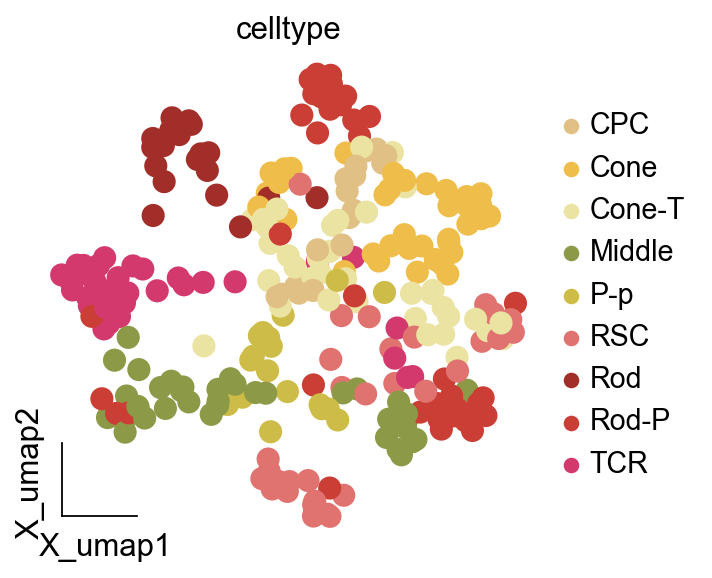

In [24]:
ov.pl.embedding(rb_soft, basis='X_umap',
                color=["celltype"],
                frameon='small',cmap='RdBu_r',
               wspace=0.5)

## Mellon

In [34]:
import numpy as np

import matplotlib
import matplotlib.pyplot as plt

from sklearn.cluster import k_means
import palantir
import mellon
import scanpy as sc

import warnings
from numba.core.errors import NumbaDeprecationWarning

warnings.simplefilter("ignore", category=NumbaDeprecationWarning)

In [35]:
%matplotlib inline

matplotlib.rcParams["figure.figsize"] = [4, 4]
matplotlib.rcParams["figure.dpi"] = 125
matplotlib.rcParams["image.cmap"] = "Spectral_r"
# no bounding boxes or axis:
matplotlib.rcParams["axes.spines.bottom"] = "on"
matplotlib.rcParams["axes.spines.top"] = "off"
matplotlib.rcParams["axes.spines.left"] = "on"
matplotlib.rcParams["axes.spines.right"] = "off"

In [36]:
%matplotlib inline
import omicverse as ov
ov.utils.ov_plot_set()

Dependency error: (numpy 1.26.4 (/mnt/home/yihanzhao/miniconda3/envs/zyh/lib/python3.10/site-packages), Requirement.parse('numpy<1.24,>=1.22'))


In [37]:
rb_soft=sc.read_h5ad('/mnt/home/yihanzhao/RB/data_new/rb_soft_via.h5ad')

In [38]:
rb_soft

AnnData object with n_obs × n_vars = 277 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap'
    obsm: 'X_umap', 'scaled|original|X_pca'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled'
    obsp: 'connectivities', 'distances'

<AxesSubplot: title={'center': 'Meta Celltype'}, xlabel='X_umap1', ylabel='X_umap2'>

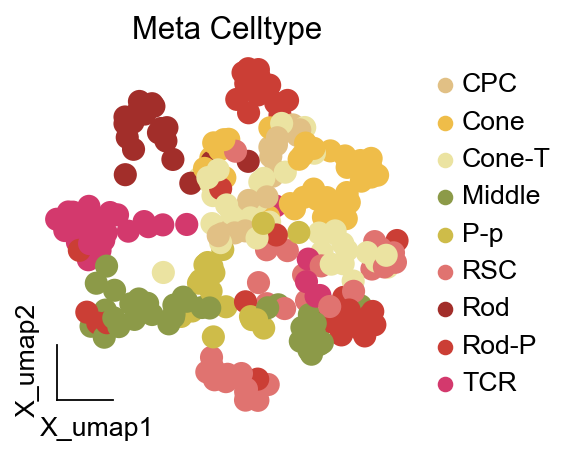

In [39]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(3,3))
ov.utils.embedding(rb_soft,
                   basis='X_umap',
                   color=["celltype"],
                   title='Meta Celltype',
                   frameon='small',
                   legend_fontsize=12,
                   #palette=ov.utils.palette()[11:],
                   ax=ax,
                   show=False)

In [40]:
ad=rb_soft

In [41]:
ad

AnnData object with n_obs × n_vars = 277 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap'
    obsm: 'X_umap', 'scaled|original|X_pca'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled'
    obsp: 'connectivities', 'distances'

In [42]:
%%time
dm_res = palantir.utils.run_diffusion_maps(ad, pca_key="scaled|original|X_pca", n_components=20)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:05)
CPU times: user 5.3 s, sys: 225 ms, total: 5.52 s
Wall time: 5.65 s


In [43]:
%%time
model = mellon.DensityEstimator()
log_density = model.fit_predict(ad.obsm["DM_EigenVectors"])

predictor = model.predict

ad.obs["mellon_log_density"] = log_density
ad.obs["mellon_log_density_clipped"] = np.clip(
    log_density, *np.quantile(log_density, [0.05, 1])
)

An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


[2024-10-23 14:20:13,608] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (277) >= n_samples (277) and rank = 1.0.
[2024-10-23 14:20:13,611] [INFO    ] Computing nearest neighbor distances.
[2024-10-23 14:20:13,965] [INFO    ] Using embedding dimensionality d=20. Use d_method="fractal" to enable effective density normalization.
[2024-10-23 14:20:14,183] [INFO    ] Using covariance function Matern52(ls=1.3341891814222746).
[2024-10-23 14:20:14,729] [INFO    ] Using rank 277 covariance representation.
[2024-10-23 14:20:14,890] [INFO    ] Running inference using L-BFGS-B.
[2024-10-23 14:20:15,545] [INFO    ] Computing predictive function.
CPU times: user 2.53 s, sys: 1.29 s, total: 3.82 s
Wall time: 3.45 s


In [44]:
# The anndata object is updated with `obs['log_density`]` and `obs['log_density_clipped']
ad

AnnData object with n_obs × n_vars = 277 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via', 'mellon_log_density', 'mellon_log_density_clipped'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap', 'DM_EigenValues'
    obsm: 'X_umap', 'scaled|original|X_pca', 'DM_EigenVectors'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled'
    obsp: 'connectivities', 'distances', 'DM_Kernel', 'DM_Similarity'

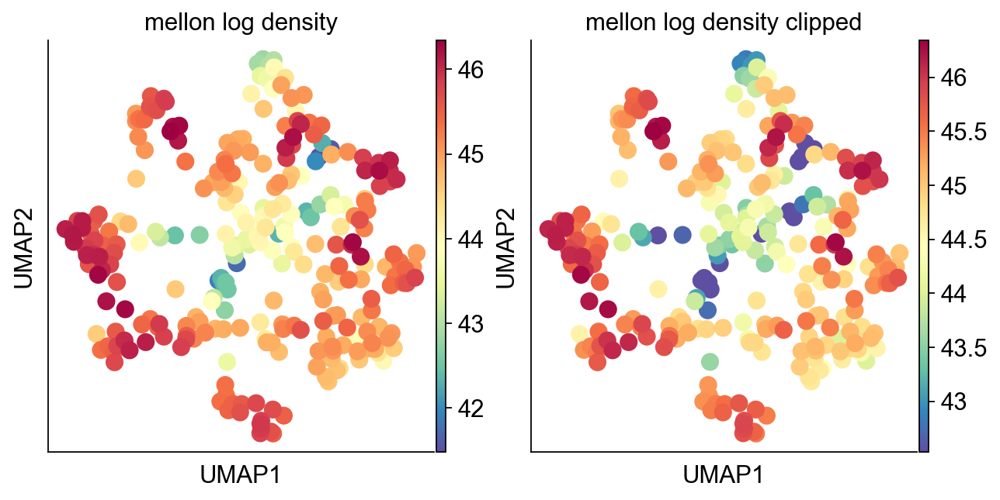

In [45]:
sc.pl.scatter(
    ad, color=["mellon_log_density", "mellon_log_density_clipped"], basis="umap"
)

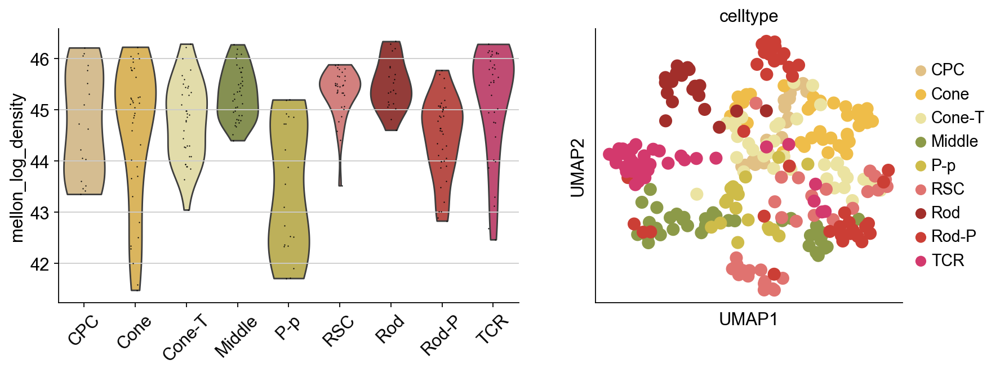

In [46]:
fig, (ax1, ax2) = plt.subplots(1, 2, width_ratios=[3, 2], figsize=[12, 4])
sc.pl.violin(ad, "mellon_log_density", "celltype", rotation=45, ax=ax1, show=False)
sc.pl.scatter(ad, color="celltype", basis="umap", ax=ax2, show=False)
plt.show()

In [47]:
imputed_X = palantir.utils.run_magic_imputation(ad)

In [48]:
ms_data = palantir.utils.determine_multiscale_space(ad)

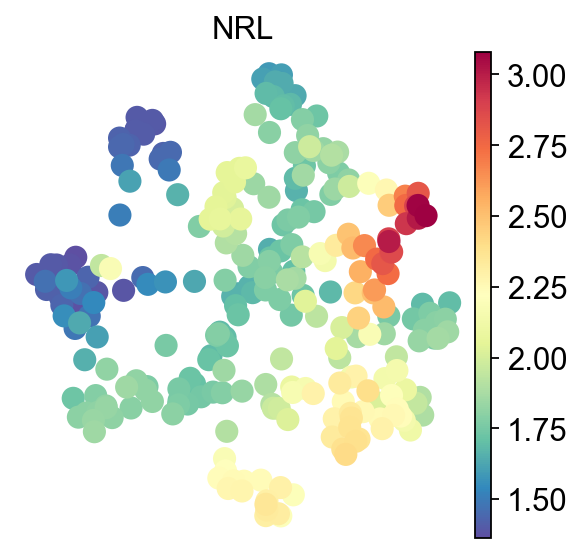

In [49]:
sc.pl.embedding(
    ad,
    basis="umap",
    layer="MAGIC_imputed_data",
    color=[ "NRL"],
    frameon=False,
)
plt.show()

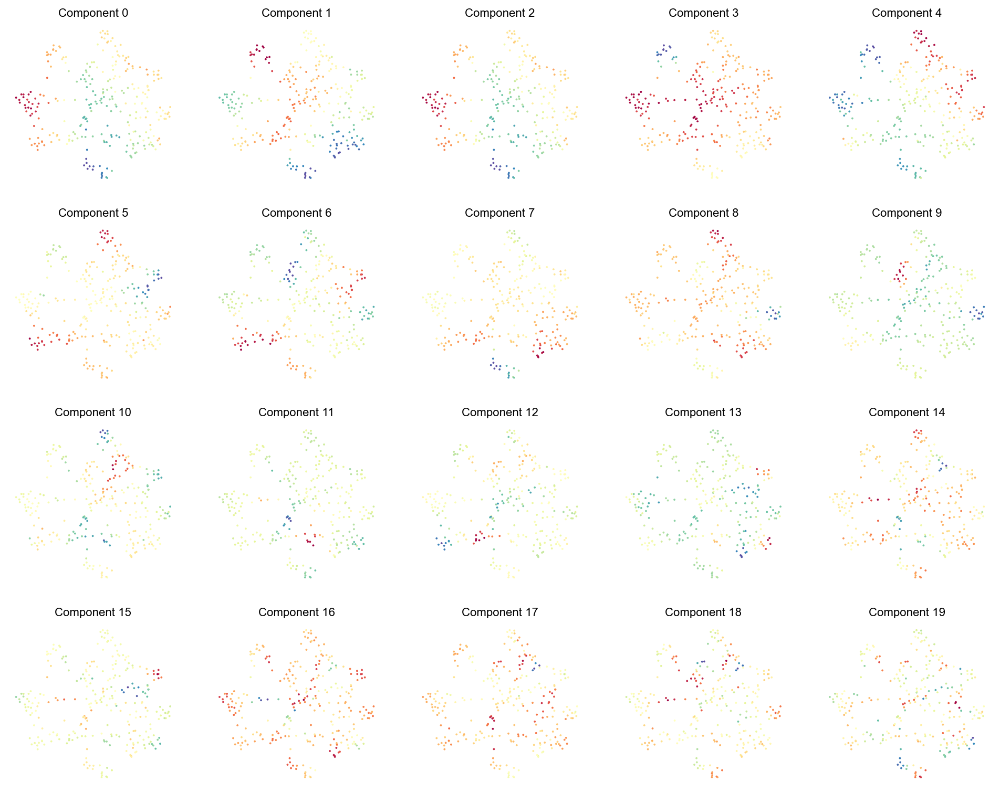

In [50]:
palantir.plot.plot_diffusion_components(ad)
plt.show()

In [52]:
ad.obs['palantir_pseudotime']=rb_soft.obs['pt_via']

In [53]:
ad.obs['celltype']

0         Rod
1         Rod
2      Cone-T
3         CPC
4         TCR
        ...  
272    Middle
273    Cone-T
274       CPC
275      Cone
276     Rod-P
Name: celltype, Length: 277, dtype: category
Categories (9, object): ['CPC' < 'Cone' < 'Cone-T' < 'Middle' ... 'RSC' < 'Rod' < 'Rod-P' < 'TCR']

In [54]:
import pandas as pd

celltypes_of_branch_1 = ["RSC", "P-p","Middle"]
celltypes_of_branch_2 = ["RSC", "P-p","TCR"]
celltypes_of_branch_3 = ["RSC", "P-p","CPC","Cone","Cone-T"]
celltypes_of_branch_4 = ["RSC", "P-p","Rod-P","Rod"]

ad.obsm["palantir_lineage_cells"] = pd.DataFrame({
    "branch_1": ad.obs["celltype"].isin(celltypes_of_branch_1),
    "branch_2": ad.obs["celltype"].isin(celltypes_of_branch_2),
    "branch_3": ad.obs["celltype"].isin(celltypes_of_branch_3),
    "branch_4": ad.obs["celltype"].isin(celltypes_of_branch_4),
})

In [55]:
ad.obs["palantir_pseudotime"], ad.obsm["palantir_lineage_cells"]

(0      0.708188
 1      0.708188
 2      0.838660
 3      0.472872
 4      0.363522
          ...   
 272    0.771304
 273    0.907269
 274    0.508665
 275    0.523195
 276    0.653965
 Name: palantir_pseudotime, Length: 277, dtype: float64,
      branch_1  branch_2  branch_3  branch_4
 0       False     False     False      True
 1       False     False     False      True
 2       False     False      True     False
 3       False     False      True     False
 4       False      True     False     False
 ..        ...       ...       ...       ...
 272      True     False     False     False
 273     False     False      True     False
 274     False     False      True     False
 275     False     False      True     False
 276     False     False     False      True
 
 [277 rows x 4 columns])

In [60]:
# Local variability of genes
palantir.utils.run_local_variability(ad)

# This will add `local_variability` as a layer to anndata
ad

AnnData object with n_obs × n_vars = 277 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via', 'mellon_log_density', 'mellon_log_density_clipped', 'palantir_pseudotime'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap', 'DM_EigenValues'
    obsm: 'X_umap', 'scaled|original|X_pca', 'DM_EigenVectors', 'DM_EigenVectors_multiscaled', 'palantir_lineage_cells'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled', 'MAGIC_imputed_data', 'local_variability'
    obsp: 'connectivities', 'distances', 'DM_Kernel', 'DM_Similarity'

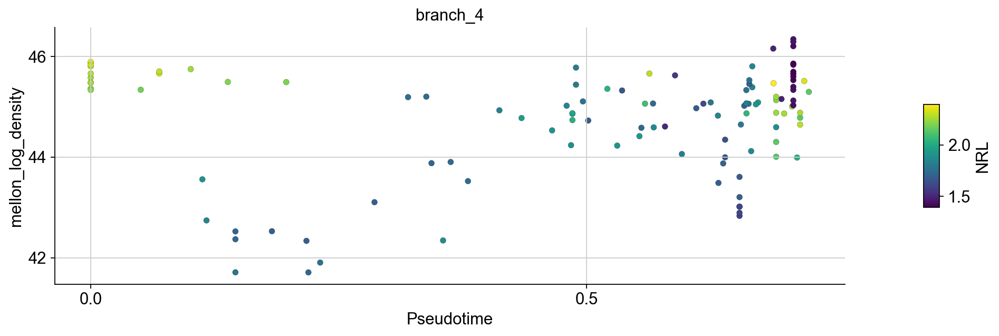

In [62]:
# Local variability  can also be visualized using `plot_branch` function
palantir.plot.plot_branch(
    ad,
    branch_name="branch_4",
    position="mellon_log_density",
    color="NRL",
    color_layer="MAGIC_imputed_data",
    masks_key="palantir_lineage_cells",
    s=100,
    #cmap=matplotlib.cm.Blues,
    edgecolor="black",
    linewidth=0.1,
)
plt.show()

### middle

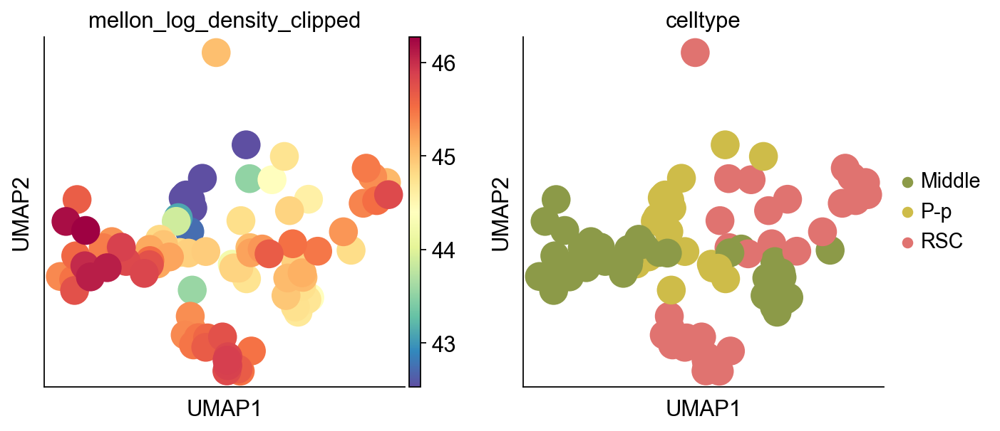

In [63]:
# Plot of UMAP
sc.pl.embedding(
    ad[ad.obsm["palantir_lineage_cells"]["branch_1"]],
    basis="umap",
    color=["mellon_log_density_clipped", "celltype"],
)
plt.show()

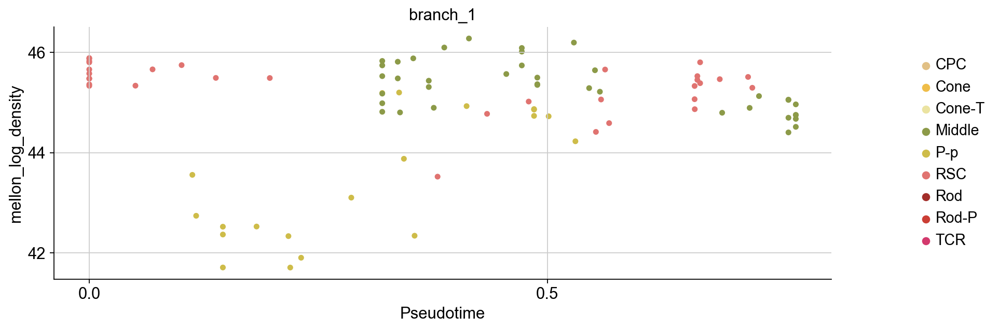

In [64]:
# Compare pseudotime to log density
palantir.plot.plot_branch(
    ad,
    branch_name="branch_1",
    position="mellon_log_density",
    color="celltype",
    masks_key="palantir_lineage_cells",
    s=100,
)
plt.show()

In [65]:
middle_specification_cells = (
    ad.obs["celltype"].isin(["RSC", "P-p", "Middle"])
    & ad.obsm["palantir_lineage_cells"]["branch_1"]
)
ad.obsm["specification"] = pd.DataFrame({"Middle": middle_specification_cells})

In [68]:
ad

AnnData object with n_obs × n_vars = 277 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via', 'mellon_log_density', 'mellon_log_density_clipped', 'palantir_pseudotime'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap', 'DM_EigenValues'
    obsm: 'X_umap', 'scaled|original|X_pca', 'DM_EigenVectors', 'DM_EigenVectors_multiscaled', 'palantir_lineage_cells', 'specification'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled', 'MAGIC_imputed_data', 'local_variability'
    obsp: 'connectivities', 'distances', 'DM_Kernel', 'DM_Similarity'

In [69]:
# 1. Re-computing density with low intrinsic dimensionality to make sure weights are representative
dm_res = palantir.utils.run_diffusion_maps(ad, pca_key="scaled|original|X_pca", n_components=20)
model = mellon.DensityEstimator(d_method="fractal")
log_density = model.fit_predict(ad.obsm["DM_EigenVectors"])

ad.obs["mellon_log_density_lowd"] = log_density

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
[2024-10-23 14:54:01,686] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (277) >= n_samples (277) and rank = 1.0.
[2024-10-23 14:54:01,688] [INFO    ] Computing nearest neighbor distances.
[2024-10-23 14:54:02,404] [INFO    ] Using d=2.1699979979991837.
[2024-10-23 14:54:02,416] [INFO    ] Using covariance function Matern52(ls=1.3341891814222746).
[2024-10-23 14:54:02,422] [INFO    ] Using rank 277 covariance representation.
[2024-10-23 14:54:02,484] [INFO    ] Running inference using L-BFGS-B.


In [70]:
# 2. Computing scores for each gene
score_key = "change_scores"
palantir.utils.run_low_density_variability(
    ad,
    cell_mask="specification",
    density_key="mellon_log_density_lowd",
    score_key=score_key,
)
plt.show()

In [71]:
scores = ad.var["change_scores_Middle"]
scores.sort_values(ascending=False)

ALDOA      4.817231e-04
EEF1G      4.734493e-04
XIST       4.490290e-04
RPS4Y1     4.400236e-04
PDC        4.374201e-04
               ...     
GPAT3      8.168539e-08
CHI3L2     7.909939e-08
MMRN2      7.442863e-08
CCDC170    6.752390e-08
CDH1       0.000000e+00
Name: change_scores_Middle, Length: 2000, dtype: float64

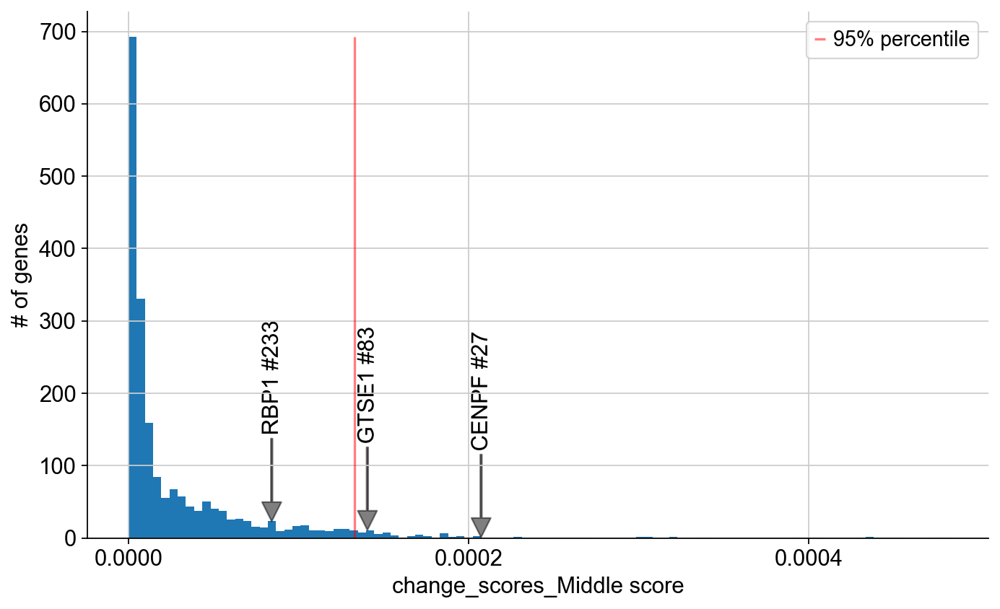

In [75]:
# The scores can be visualized as a histogram. Some important genes are highlgited below
highlight_gene = [ "CENPF", "GTSE1","RBP1"]

palantir.plot.gene_score_histogram(ad, "change_scores_Middle", highlight_gene)
plt.show()

In [77]:
percentile = 0.95
percentile_cutoff = np.quantile(scores, percentile)
scores = scores.sort_values(ascending=False)
middle_change_genes = scores.index[scores >= percentile_cutoff]

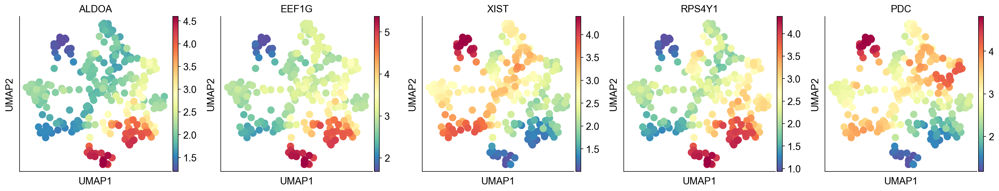

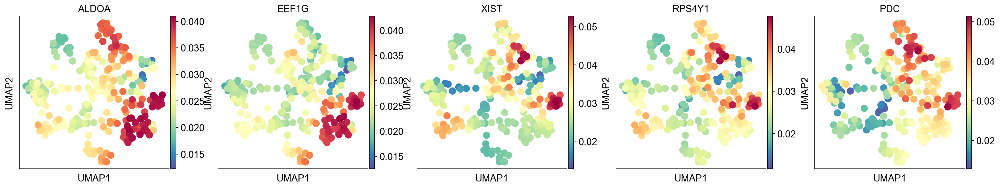

In [78]:
# Visualize the expression and variability of top 5 genes
sc.pl.embedding(
    ad,
    basis="umap",
    color=middle_change_genes[:5],
    layer="MAGIC_imputed_data",
    ncols=5,
)
sc.pl.embedding(
    ad,
    basis="umap",
    color=middle_change_genes[:5],
    layer="local_variability",
    ncols=5,
)
plt.show()

In [79]:
_ = palantir.presults.compute_gene_trends(ad, ls=5, masks_key="specification")

Middle
[2024-10-23 14:58:03,045] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (500) >= n_samples (90) and rank = 1.0.
[2024-10-23 14:58:03,045] [INFO    ] Using covariance function Matern52(ls=5.0).


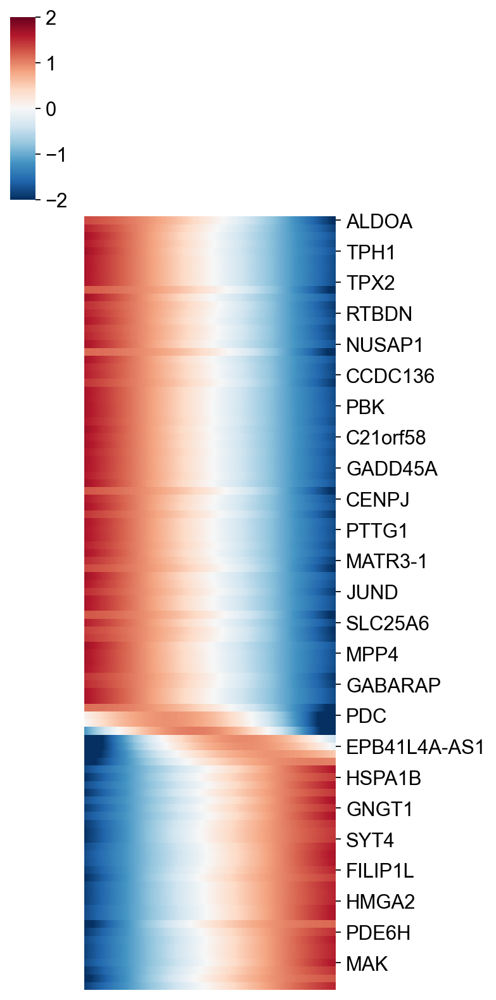

In [81]:
# Alternatively sort by maximum exprression bin for clean visualization
plot_order = selected_trends.idxmax(axis=1).sort_values().index
sns.clustermap(
    selected_trends.loc[plot_order, :],
    z_score=0,
    cmap="RdBu_r",
    col_cluster=False,
    row_cluster=False,
    vmin=-2,
    vmax=2,
    figsize=[5, 10],
    xticklabels=0,
)
plt.show()

### TCR

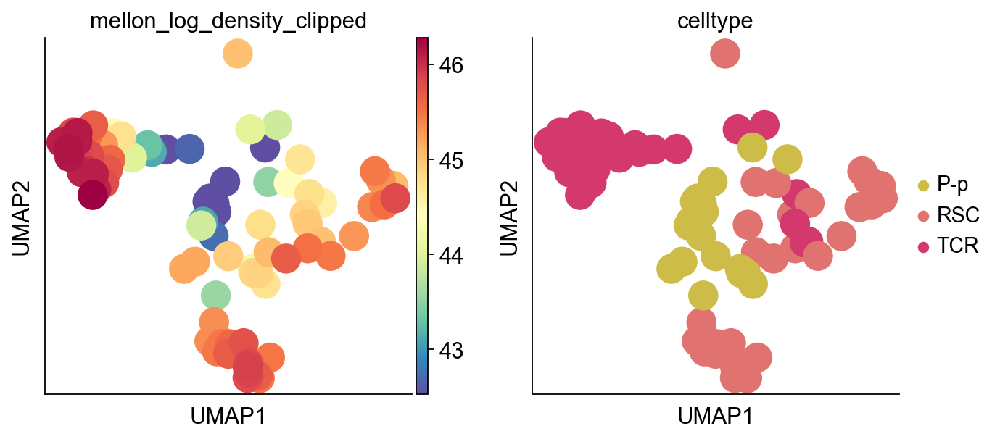

In [82]:
# Plot of UMAP
sc.pl.embedding(
    ad[ad.obsm["palantir_lineage_cells"]["branch_2"]],
    basis="umap",
    color=["mellon_log_density_clipped", "celltype"],
)
plt.show()

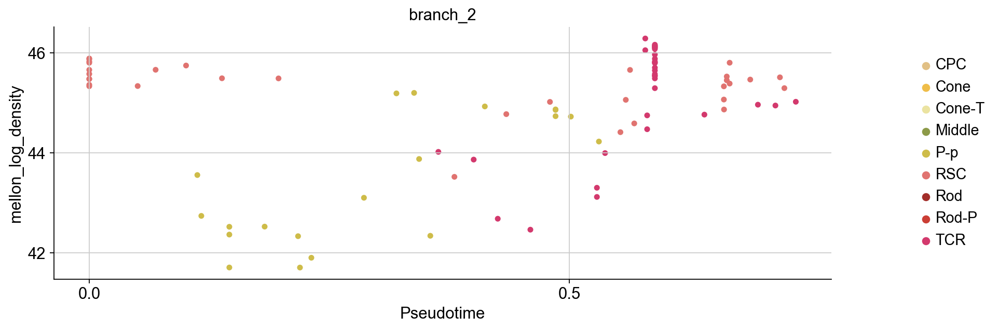

In [83]:
# Compare pseudotime to log density
palantir.plot.plot_branch(
    ad,
    branch_name="branch_2",
    position="mellon_log_density",
    color="celltype",
    masks_key="palantir_lineage_cells",
    s=100,
)
plt.show()

In [84]:
tcr_specification_cells = (
    ad.obs["celltype"].isin(["RSC", "P-p", "TCR"])
    & ad.obsm["palantir_lineage_cells"]["branch_2"]
)
ad.obsm["specification"] = pd.DataFrame({"TCR": tcr_specification_cells})

In [87]:
# 1. Re-computing density with low intrinsic dimensionality to make sure weights are representative
dm_res = palantir.utils.run_diffusion_maps(ad, pca_key="scaled|original|X_pca", n_components=20)
model = mellon.DensityEstimator(d_method="fractal")
log_density = model.fit_predict(ad.obsm["DM_EigenVectors"])

ad.obs["mellon_log_density_lowd"] = log_density

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
[2024-10-23 15:03:26,459] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (277) >= n_samples (277) and rank = 1.0.
[2024-10-23 15:03:26,460] [INFO    ] Computing nearest neighbor distances.
[2024-10-23 15:03:26,483] [INFO    ] Using d=2.1699979979991837.
[2024-10-23 15:03:26,485] [INFO    ] Using covariance function Matern52(ls=1.3341891814222746).
[2024-10-23 15:03:26,496] [INFO    ] Using rank 277 covariance representation.
[2024-10-23 15:03:26,525] [INFO    ] Running inference using L-BFGS-B.


In [88]:
# 2. Computing scores for each gene
score_key = "change_scores"
palantir.utils.run_low_density_variability(
    ad,
    cell_mask="specification",
    density_key="mellon_log_density_lowd",
    score_key=score_key,
)
plt.show()

In [89]:
scores = ad.var["change_scores_TCR"]
scores.sort_values(ascending=False)

ALDOA         4.531233e-04
MT-ATP8       4.358617e-04
EEF1G         4.349173e-04
PDC           4.328368e-04
RPS4Y1        4.174737e-04
                  ...     
MMRN2         8.099345e-08
CHI3L2        7.767425e-08
AC116651.1    7.651489e-08
CCDC170       7.222115e-08
CDH1          0.000000e+00
Name: change_scores_TCR, Length: 2000, dtype: float64

In [93]:
percentile = 0.95
percentile_cutoff = np.quantile(scores, percentile)
scores = scores.sort_values(ascending=False)
tcr_change_genes = scores.index[scores >= percentile_cutoff]

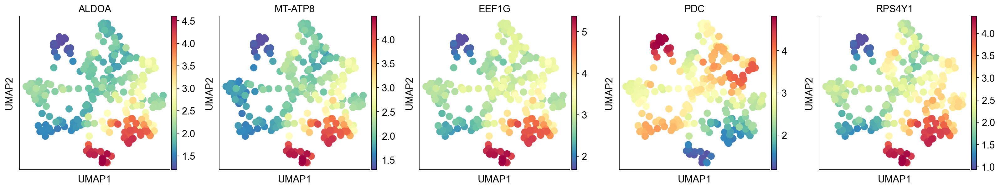

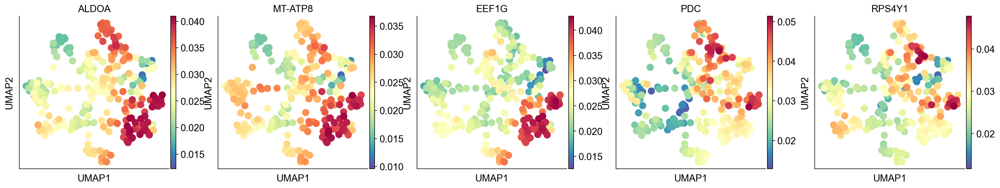

In [94]:
# Visualize the expression and variability of top 5 genes
sc.pl.embedding(
    ad,
    basis="umap",
    color=tcr_change_genes[:5],
    layer="MAGIC_imputed_data",
    ncols=5,
)
sc.pl.embedding(
    ad,
    basis="umap",
    color=tcr_change_genes[:5],
    layer="local_variability",
    ncols=5,
)
plt.show()

In [95]:
_ = palantir.presults.compute_gene_trends(ad, ls=5, masks_key="specification")

TCR
[2024-10-23 15:08:10,465] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (500) >= n_samples (86) and rank = 1.0.
[2024-10-23 15:08:10,465] [INFO    ] Using covariance function Matern52(ls=5.0).


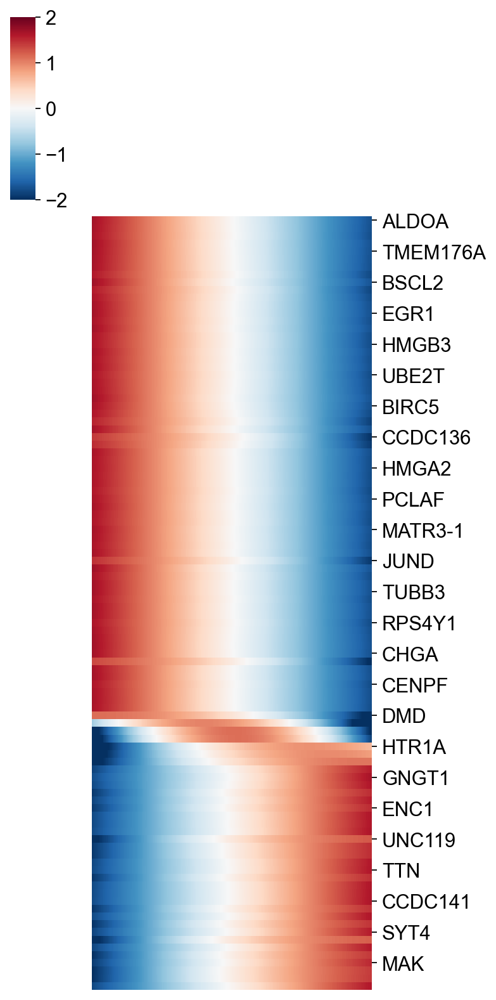

In [97]:
# Alternatively sort by maximum exprression bin for clean visualization
plot_order = selected_trends.idxmax(axis=1).sort_values().index
sns.clustermap(
    selected_trends.loc[plot_order, :],
    z_score=0,
    cmap="RdBu_r",
    col_cluster=False,
    row_cluster=False,
    vmin=-2,
    vmax=2,
    figsize=[5, 10],
    xticklabels=0,
)
plt.show()

### cone

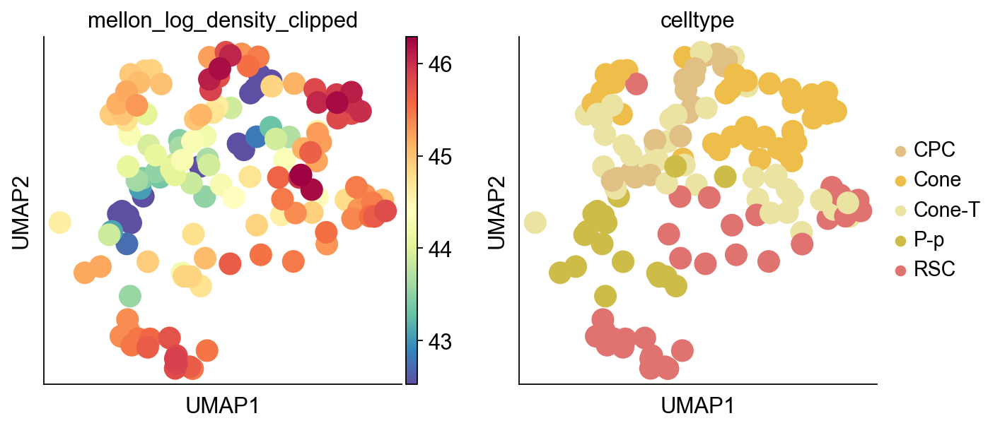

In [98]:
# Plot of UMAP
sc.pl.embedding(
    ad[ad.obsm["palantir_lineage_cells"]["branch_3"]],
    basis="umap",
    color=["mellon_log_density_clipped", "celltype"],
)
plt.show()

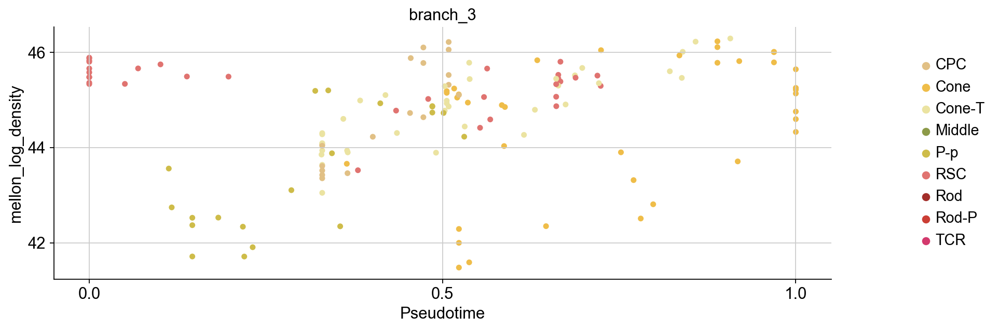

In [99]:
# Compare pseudotime to log density
palantir.plot.plot_branch(
    ad,
    branch_name="branch_3",
    position="mellon_log_density",
    color="celltype",
    masks_key="palantir_lineage_cells",
    s=100,
)
plt.show()

In [101]:
cone_specification_cells = (
    ad.obs["celltype"].isin(["RSC", "P-p", "CPC","Cone","Cone-T"])
    & ad.obsm["palantir_lineage_cells"]["branch_3"]
)
ad.obsm["specification"] = pd.DataFrame({"Cone": cone_specification_cells})

In [103]:
# 1. Re-computing density with low intrinsic dimensionality to make sure weights are representative
dm_res = palantir.utils.run_diffusion_maps(ad, pca_key="scaled|original|X_pca", n_components=20)
model = mellon.DensityEstimator(d_method="fractal")
log_density = model.fit_predict(ad.obsm["DM_EigenVectors"])

ad.obs["mellon_log_density_lowd"] = log_density

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
[2024-10-23 15:12:15,236] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (277) >= n_samples (277) and rank = 1.0.
[2024-10-23 15:12:15,237] [INFO    ] Computing nearest neighbor distances.
[2024-10-23 15:12:15,260] [INFO    ] Using d=2.1699979979991837.
[2024-10-23 15:12:15,262] [INFO    ] Using covariance function Matern52(ls=1.3341891814222746).
[2024-10-23 15:12:15,272] [INFO    ] Using rank 277 covariance representation.
[2024-10-23 15:12:15,301] [INFO    ] Running inference using L-BFGS-B.


In [104]:
# 2. Computing scores for each gene
score_key = "change_scores"
palantir.utils.run_low_density_variability(
    ad,
    cell_mask="specification",
    density_key="mellon_log_density_lowd",
    score_key=score_key,
)
plt.show()

In [105]:
scores = ad.var["change_scores_Cone"]
scores.sort_values(ascending=False)

PDC           5.724242e-04
XIST          5.222253e-04
RPS4Y1        5.050469e-04
ALDOA         4.901843e-04
SLC25A6       4.481044e-04
                  ...     
AC116651.1    1.097544e-07
CREB3L1       7.938661e-08
AC007384.1    7.182047e-08
FOXD3         6.943083e-08
CDH1          0.000000e+00
Name: change_scores_Cone, Length: 2000, dtype: float64

In [106]:
percentile = 0.95
percentile_cutoff = np.quantile(scores, percentile)
scores = scores.sort_values(ascending=False)
cone_change_genes = scores.index[scores >= percentile_cutoff]

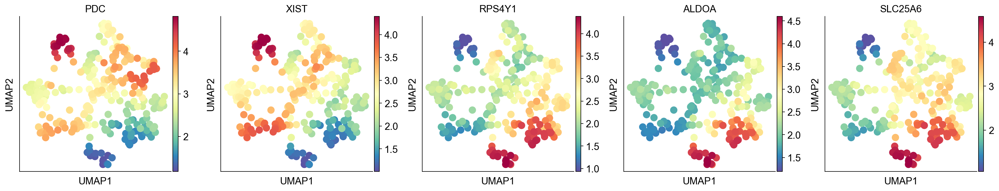

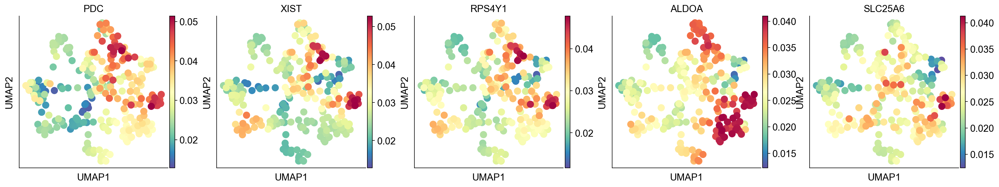

In [107]:
# Visualize the expression and variability of top 5 genes
sc.pl.embedding(
    ad,
    basis="umap",
    color=cone_change_genes[:5],
    layer="MAGIC_imputed_data",
    ncols=5,
)
sc.pl.embedding(
    ad,
    basis="umap",
    color=cone_change_genes[:5],
    layer="local_variability",
    ncols=5,
)
plt.show()

In [108]:
_ = palantir.presults.compute_gene_trends(ad, ls=5, masks_key="specification")

Cone
[2024-10-23 15:15:37,702] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (500) >= n_samples (144) and rank = 1.0.
[2024-10-23 15:15:37,703] [INFO    ] Using covariance function Matern52(ls=5.0).


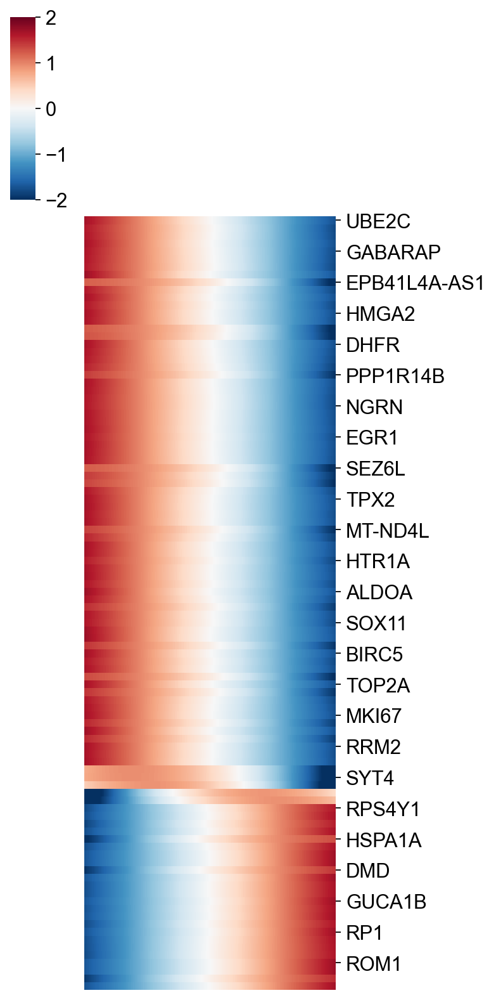

In [110]:
# Alternatively sort by maximum exprression bin for clean visualization
plot_order = selected_trends.idxmax(axis=1).sort_values().index
sns.clustermap(
    selected_trends.loc[plot_order, :],
    z_score=0,
    cmap="RdBu_r",
    col_cluster=False,
    row_cluster=False,
    vmin=-2,
    vmax=2,
    figsize=[5, 10],
    xticklabels=0,
)
plt.show()

### rod

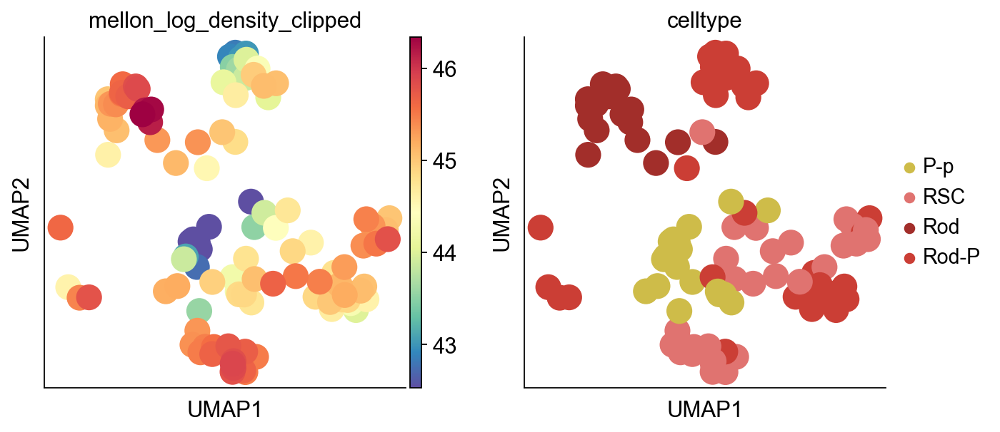

In [111]:
# Plot of UMAP
sc.pl.embedding(
    ad[ad.obsm["palantir_lineage_cells"]["branch_4"]],
    basis="umap",
    color=["mellon_log_density_clipped", "celltype"],
)
plt.show()

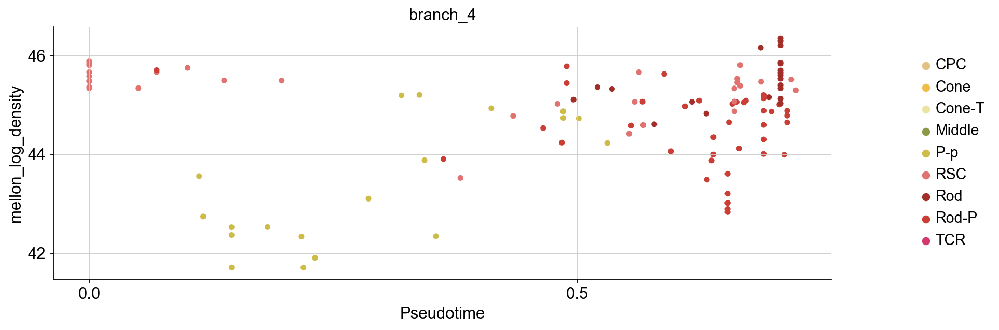

In [112]:
# Compare pseudotime to log density
palantir.plot.plot_branch(
    ad,
    branch_name="branch_4",
    position="mellon_log_density",
    color="celltype",
    masks_key="palantir_lineage_cells",
    s=100,
)
plt.show()

In [113]:
rod_specification_cells = (
    ad.obs["celltype"].isin(["RSC", "P-p", "Rod-P","Rod"])
    & ad.obsm["palantir_lineage_cells"]["branch_4"]
)
ad.obsm["specification"] = pd.DataFrame({"Rod": rod_specification_cells})

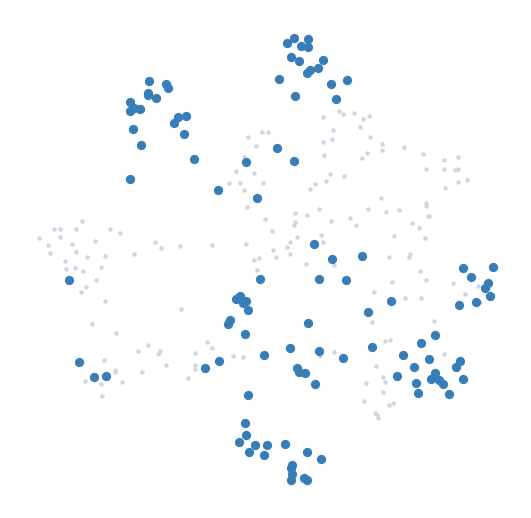

In [114]:
# Verify that the selected set of cells is correct
palantir.plot.highlight_cells_on_umap(ad, rod_specification_cells)
plt.show()

In [115]:
# 1. Re-computing density with low intrinsic dimensionality to make sure weights are representative
dm_res = palantir.utils.run_diffusion_maps(ad, pca_key="scaled|original|X_pca", n_components=20)
model = mellon.DensityEstimator(d_method="fractal")
log_density = model.fit_predict(ad.obsm["DM_EigenVectors"])

ad.obs["mellon_log_density_lowd"] = log_density

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
[2024-10-23 15:20:14,088] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (277) >= n_samples (277) and rank = 1.0.
[2024-10-23 15:20:14,089] [INFO    ] Computing nearest neighbor distances.
[2024-10-23 15:20:14,112] [INFO    ] Using d=2.1699979979991837.
[2024-10-23 15:20:14,114] [INFO    ] Using covariance function Matern52(ls=1.3341891814222746).
[2024-10-23 15:20:14,125] [INFO    ] Using rank 277 covariance representation.
[2024-10-23 15:20:14,153] [INFO    ] Running inference using L-BFGS-B.


In [116]:
# 2. Computing scores for each gene
score_key = "change_scores"
palantir.utils.run_low_density_variability(
    ad,
    cell_mask="specification",
    density_key="mellon_log_density_lowd",
    score_key=score_key,
)
plt.show()

In [117]:
scores = ad.var["change_scores_Rod"]
scores.sort_values(ascending=False)

ALDOA      4.791202e-04
PDC        4.731550e-04
EEF1G      4.443622e-04
XIST       4.346212e-04
RPS4Y1     4.260818e-04
               ...     
GPAT3      6.655999e-08
DNAJB13    6.617219e-08
FOXD3      6.544000e-08
CHI3L2     6.083917e-08
CDH1       0.000000e+00
Name: change_scores_Rod, Length: 2000, dtype: float64

In [118]:
percentile = 0.95
percentile_cutoff = np.quantile(scores, percentile)
scores = scores.sort_values(ascending=False)
rod_change_genes = scores.index[scores >= percentile_cutoff]

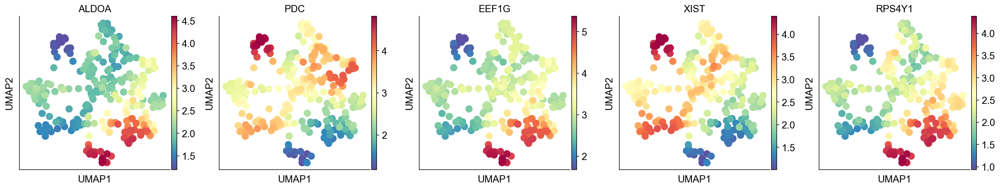

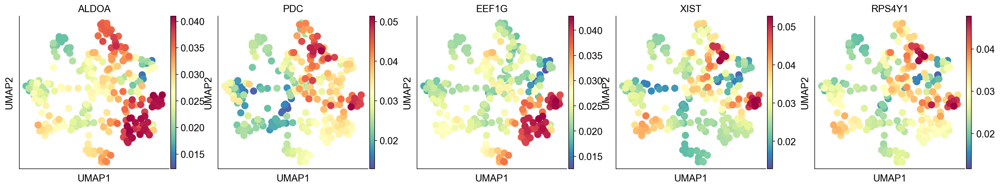

In [119]:
# Visualize the expression and variability of top 5 genes
sc.pl.embedding(
    ad,
    basis="umap",
    color=rod_change_genes[:5],
    layer="MAGIC_imputed_data",
    ncols=5,
)
sc.pl.embedding(
    ad,
    basis="umap",
    color=rod_change_genes[:5],
    layer="local_variability",
    ncols=5,
)
plt.show()

In [120]:
_ = palantir.presults.compute_gene_trends(ad, ls=5, masks_key="specification")

Rod
[2024-10-23 15:21:12,776] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (500) >= n_samples (113) and rank = 1.0.
[2024-10-23 15:21:12,776] [INFO    ] Using covariance function Matern52(ls=5.0).


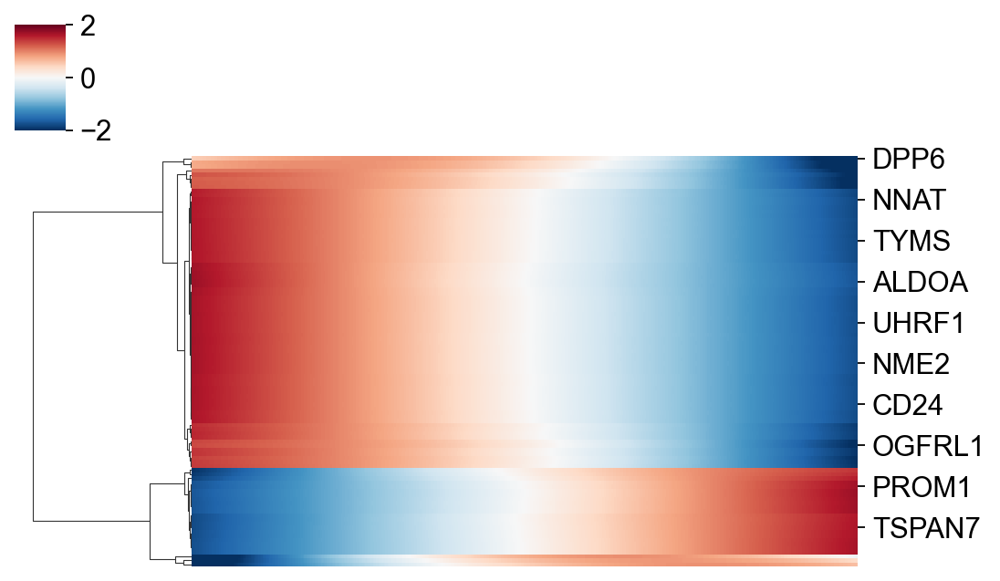

In [121]:
# Plot
import seaborn as sns

selected_trends = ad.varm["gene_trends_Cone"].loc[rod_change_genes, :]

sns.clustermap(
    selected_trends,
    z_score=0,
    cmap="RdBu_r",
    col_cluster=False,
    vmin=-2,
    vmax=2,
    figsize=[7, 4],
    xticklabels=0,
)
plt.show()

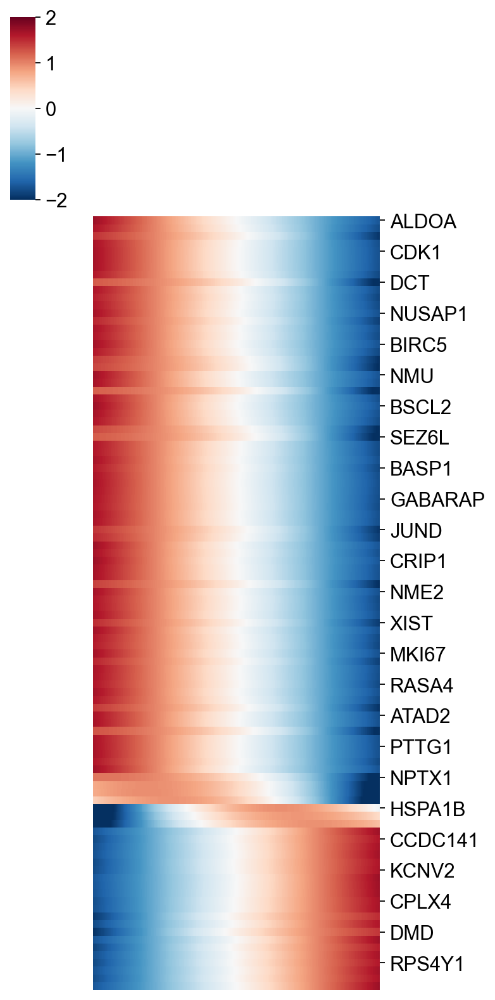

In [122]:
# Alternatively sort by maximum exprression bin for clean visualization
plot_order = selected_trends.idxmax(axis=1).sort_values().index
sns.clustermap(
    selected_trends.loc[plot_order, :],
    z_score=0,
    cmap="RdBu_r",
    col_cluster=False,
    row_cluster=False,
    vmin=-2,
    vmax=2,
    figsize=[5, 10],
    xticklabels=0,
)
plt.show()

## DEG1

<AxesSubplot: title={'center': 'celltype'}, xlabel='X_umap1', ylabel='X_umap2'>

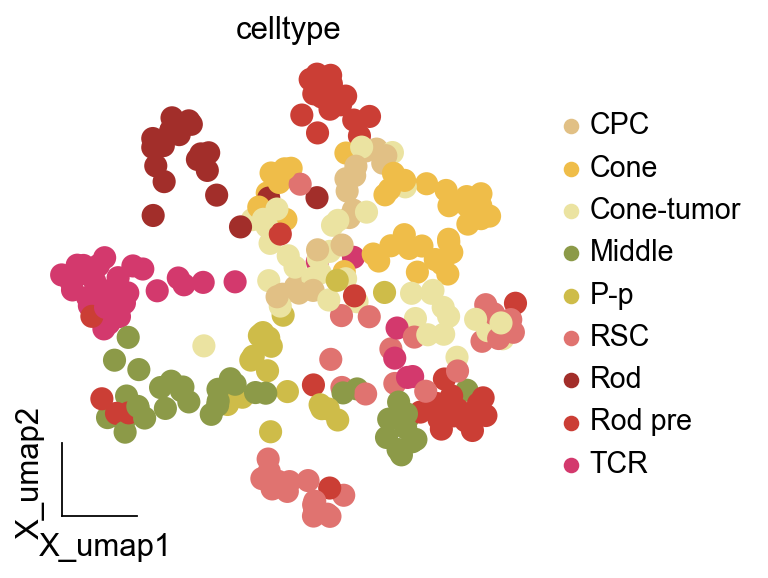

In [5]:
ov.utils.embedding(rb_soft,
                basis='X_umap',frameon='small',#palette=ov.utils.green_color[:2]+ov.utils.orange_color[:2]+ov.utils.red_color+ov.utils.blue_color[1:],
                color=['celltype'],show=False)

In [5]:
rb_soft_gb=rb_soft[:,rb_soft.var['highly_variable']==True]

In [6]:
#p-p
rb_pp=rb_soft_gb[rb_soft_gb.obs.celltype == 'P-p', :]
rb_pp

View of AnnData object with n_obs × n_vars = 20 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap'
    obsm: 'X_umap', 'scaled|original|X_pca'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled'
    obsp: 'connectivities', 'distances'

In [7]:
#cone
rb_cone=rb_soft_gb[rb_soft_gb.obs.celltype == 'Cone', :]
rb_cone

View of AnnData object with n_obs × n_vars = 38 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap'
    obsm: 'X_umap', 'scaled|original|X_pca'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled'
    obsp: 'connectivities', 'distances'

In [8]:
#Cone-tumor
rb_cone_tumor=rb_soft_gb[rb_soft_gb.obs.celltype == 'Cone-tumor', :]
rb_cone_tumor

View of AnnData object with n_obs × n_vars = 36 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'hvg', 'neighbors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'umap'
    obsm: 'X_umap', 'scaled|original|X_pca'
    varm: 'scaled|original|pca_loadings'
    layers: 'lognorm', 'scaled'
    obsp: 'connectivities', 'distances'

In [9]:
rb_pp.X.max(),rb_cone.X.max(),rb_cone_tumor.X.max()

(8.212948, 8.781527, 8.235871)

In [10]:
import anndata
test1=anndata.concat([rb_pp, rb_cone], join="inner")
test1

AnnData object with n_obs × n_vars = 58 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via'
    obsm: 'X_umap', 'scaled|original|X_pca'
    layers: 'lognorm', 'scaled'

In [11]:
dds=ov.bulk.pyDEG(test1.to_df().T)

In [12]:
dds.drop_duplicates_index()
print('... drop_duplicates_index success')

... drop_duplicates_index success


In [13]:
treatment_groups=rb_pp.obs.index.tolist()

In [14]:
control_groups=rb_cone.obs.index.tolist()
result=dds.deg_analysis(treatment_groups,control_groups,method='wilcox')

In [15]:
print(result.shape)
result=result.loc[result['log2(BaseMean)']>1]
print(result.shape)

(2000, 11)
(235, 11)


In [16]:
# -1 means automatically calculates
dds.foldchange_set(fc_threshold=-1,
                   pval_threshold=0.1,
                   logp_max=6)

... Fold change threshold: 3.9853720664978027


<AxesSubplot: title={'center': 'DEG Analysis'}, xlabel='$log_{2}FC$', ylabel='$-log_{10}(qvalue)$'>

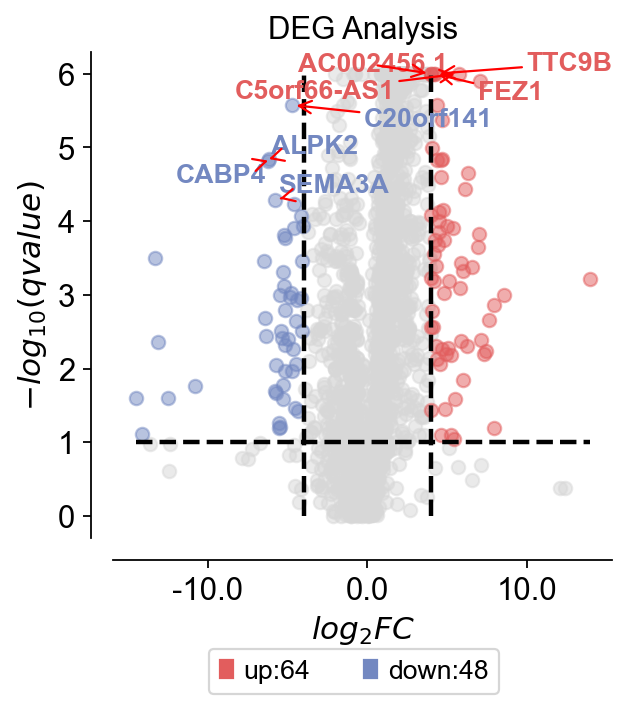

In [17]:
dds.plot_volcano(title='DEG Analysis',figsize=(4,4),
                 plot_genes_num=8,plot_genes_fontsize=12,)

In [21]:
pathway_dict=ov.utils.geneset_prepare('/mnt/home/zehuazeng/analysis/placenta/genesets/WikiPathway_2021_Human.txt',organism='Human')

In [22]:
deg_genes=dds.result.loc[dds.result['sig']!='normal'].index.tolist()
enr=ov.bulk.geneset_enrichment(gene_list=deg_genes,
                                pathways_dict=pathway_dict,
                                pvalue_type='auto',
                                organism='human')

<AxesSubplot: title={'center': 'Wiki Pathway enrichment'}, xlabel='Fractions of genes'>

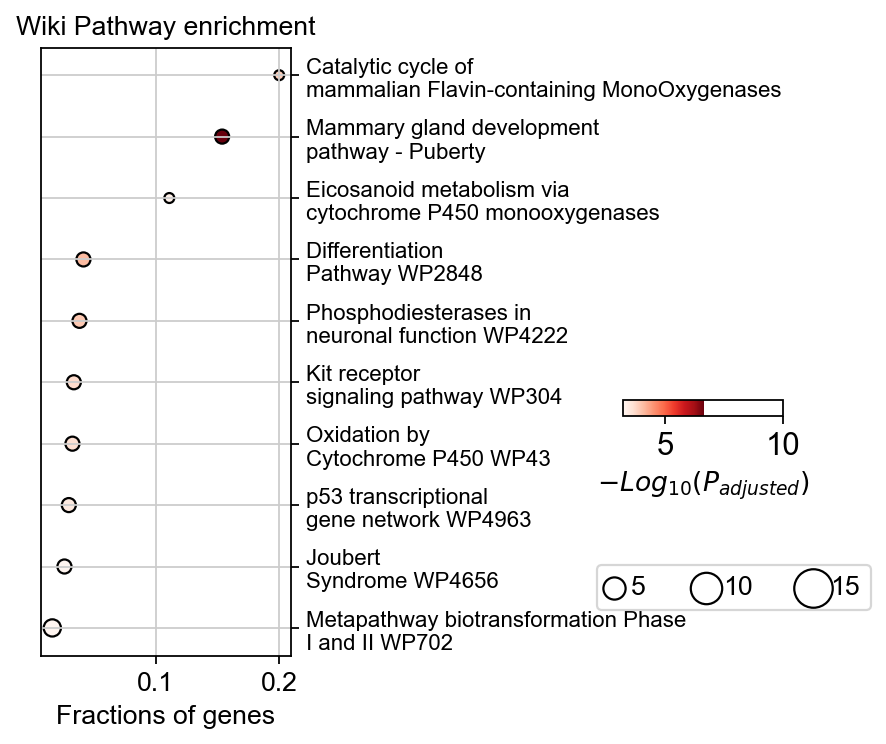

In [29]:
ov.bulk.geneset_plot(enr,figsize=(2,5),fig_title='Wiki Pathway enrichment',
                    cax_loc=[2, 0.45, 0.5, 0.02],
                    bbox_to_anchor_used=(-0.25, -13),node_diameter=20,
                    cmap='Reds')

In [18]:
import numpy as np

In [293]:
result['log(padj)'] = -np.log10(result['pvalue'])
result['sig'] = 'normal'
result.loc[(result.log2FC> 1.5 )&(result.pvalue < 0.1),'sig'] = 'up'
result.loc[(result.log2FC< -1.5 )&(result.pvalue < 0.1),'sig'] = 'down'

result.head()

,pvalue,qvalue,FoldChange,-log(pvalue),-log(qvalue),BaseMean,log2(BaseMean),log2FC,abs(log2FC),size,sig,log(padj)
SAMD11,0.238856,0.299131,0.640383,0.621864,0.524139,1.389763,0.474839,-0.642994,0.642994,0.064038,normal,0.621864
HES4,0.461635,0.521917,1.125269,0.335701,0.282399,2.181755,1.125489,0.170270,0.170270,0.112527,normal,0.335701
B3GALT6,0.020180,0.035065,0.617068,1.695078,1.455124,0.417636,-1.259683,-0.696499,0.696499,0.061707,normal,1.695078
ATAD3A,0.000035,0.000147,2.393101,4.457087,3.831835,1.325484,0.406519,1.258881,1.258881,0.239310,normal,4.457087
FNDC10,0.179777,0.231821,1.093578,0.745265,0.634847,0.357691,-1.483213,0.129055,0.129055,0.109358,normal,0.745265


In [294]:
up=result[result['sig']=='up']
up

,pvalue,qvalue,FoldChange,-log(pvalue),-log(qvalue),BaseMean,log2(BaseMean),log2FC,abs(log2FC),size,sig,log(padj)
GABRD,9.236851e-05,3.322608e-04,3.799249,4.034476,3.478521,0.330318,-1.598074,1.925714,1.925714,0.379925,up,4.034476
EPHA2,3.592271e-03,7.618814e-03,3.831616,2.444631,2.118113,0.527774,-0.922008,1.937953,1.937953,0.383162,up,2.444631
ALPL,8.461357e-04,2.161266e-03,3.826486,3.072560,2.665292,0.260893,-1.938469,1.936020,1.936020,0.382649,up,3.072560
E2F2,1.931324e-06,1.345870e-05,3.456814,5.714145,4.870997,1.236444,0.306197,1.789443,1.789443,0.345681,up,5.714145
RUNX3,7.529962e-05,2.820210e-04,7.197028,4.123207,3.549718,0.249401,-2.003460,2.847401,2.847401,0.719703,up,4.123207
...,...,...,...,...,...,...,...,...,...,...,...,...
GTSE1,6.342797e-09,2.878777e-07,4.172917,8.197719,6.540792,2.442938,1.288617,2.061056,2.061056,0.417292,up,8.197719
SELENOO,6.562739e-05,2.514459e-04,4.020520,4.182915,3.599555,0.669393,-0.579076,2.007382,2.007382,0.402052,up,4.182915
LINC00158,2.642218e-04,8.055543e-04,57.569824,3.578031,3.093905,0.071793,-3.800019,5.847241,5.847241,5.756982,up,3.578031
CLIC6,1.915853e-04,6.140554e-04,15877.050781,3.717638,3.211792,0.079380,-3.655076,13.954656,13.954656,1587.705078,up,3.717638


In [295]:
down=result[result['sig']=='down']
down

,pvalue,qvalue,FoldChange,-log(pvalue),-log(qvalue),BaseMean,log2(BaseMean),log2FC,abs(log2FC),size,sig,log(padj)
PADI2,0.074564,0.109252,0.244473,1.127469,0.961572,0.062631,-3.996973,-2.032254,2.032254,0.024447,down,1.127469
PLA2G5,0.001638,0.003853,0.081567,2.785777,2.414166,0.411473,-1.281131,-3.615863,3.615863,0.008157,down,2.785777
AL391650.1,0.000050,0.000198,0.158173,4.303660,3.704198,0.163126,-2.615944,-2.660429,2.660429,0.015817,down,4.303660
IFI6,0.000078,0.000291,0.093113,4.108350,3.535673,0.495564,-1.012857,-3.424876,3.424876,0.009311,down,4.108350
SLC6A9,0.000628,0.001669,0.181431,3.201746,2.777511,0.140438,-2.831997,-2.462505,2.462505,0.018143,down,3.201746
...,...,...,...,...,...,...,...,...,...,...,...,...
PLA2G4C-AS1,0.049636,0.077075,0.000056,1.304200,1.113086,0.088538,-3.497564,-14.112158,14.112158,0.000006,down,1.304200
KLK11,0.071941,0.105873,0.000191,1.143027,0.975216,0.026164,-5.256273,-12.353643,12.353643,0.000019,down,1.143027
SEC14L2,0.000017,0.000083,0.333786,4.772276,4.078701,0.554881,-0.849749,-1.583006,1.583006,0.033379,down,4.772276
PRR34-AS1,0.085851,0.123350,0.006725,1.066252,0.908861,0.038619,-4.694551,-7.216193,7.216193,0.000673,down,1.066252


In [296]:
# -1 means automatically calculates
dds.foldchange_set(fc_threshold=-1,
                   pval_threshold=0.05,
                   logp_max=6)

... Fold change threshold: 3.9853720664978027


<AxesSubplot: title={'center': 'DEG Analysis'}, xlabel='$log_{2}FC$', ylabel='$-log_{10}(qvalue)$'>

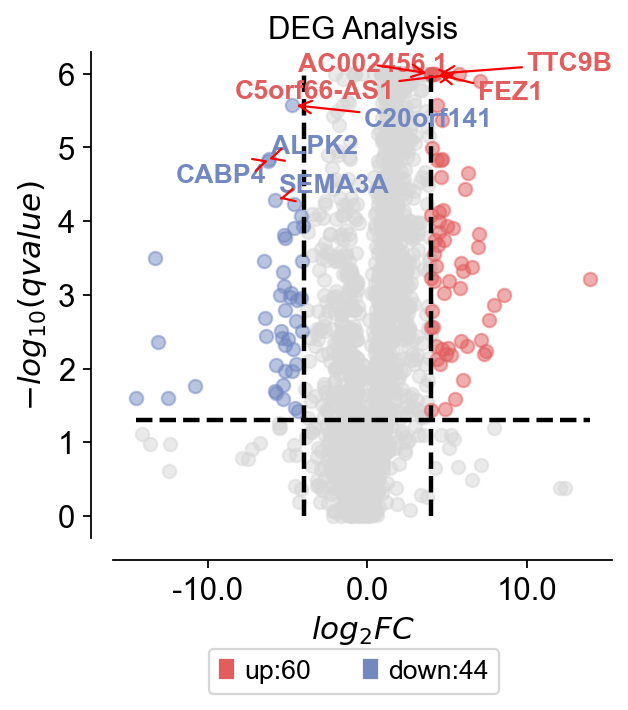

In [297]:
#rod与cpc
dds.plot_volcano(title='DEG Analysis',figsize=(4,4),
                 plot_genes_num=8,plot_genes_fontsize=12,)

In [23]:
import anndata
test2=anndata.concat([rb_cone, rb_cone_tumor], join="inner")
test2

AnnData object with n_obs × n_vars = 74 × 2000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity', 'pt_via'
    obsm: 'X_umap', 'scaled|original|X_pca'
    layers: 'lognorm', 'scaled'

In [24]:
dds=ov.bulk.pyDEG(test2.to_df().T)

In [25]:
dds.drop_duplicates_index()
print('... drop_duplicates_index success')

... drop_duplicates_index success


In [26]:
treatment_groups=rb_cone.obs.index.tolist()

In [27]:
control_groups=rb_cone_tumor.obs.index.tolist()
result=dds.deg_analysis(treatment_groups,control_groups,method='wilcox')

In [28]:
result['log(padj)'] = -np.log10(result['pvalue'])
result['sig'] = 'normal'
result.loc[(result.log2FC> 1.5 )&(result.pvalue < 0.1),'sig'] = 'up'
result.loc[(result.log2FC< -1.5 )&(result.pvalue < 0.1),'sig'] = 'down'

result.head()

,pvalue,qvalue,FoldChange,-log(pvalue),-log(qvalue),BaseMean,log2(BaseMean),log2FC,abs(log2FC),size,sig,log(padj)
SAMD11,0.004605,0.012916,2.048494,2.336808,1.888868,1.260799,0.334339,1.034564,1.034564,0.204849,normal,2.336808
HES4,0.611247,0.676159,1.085375,0.213783,0.169951,1.972405,0.979956,0.118194,0.118194,0.108538,normal,0.213783
B3GALT6,0.179911,0.250921,1.237245,0.744943,0.600462,0.467012,-1.098468,0.307131,0.307131,0.123725,normal,0.744943
ATAD3A,0.000561,0.002762,0.682514,3.251211,2.558707,0.962994,-0.054401,-0.551069,0.551069,0.068251,normal,3.251211
FNDC10,0.004451,0.012574,0.675695,2.351527,1.900530,0.423707,-1.238861,-0.565556,0.565556,0.067570,normal,2.351527


In [29]:
up=result[result['sig']=='up']
up

,pvalue,qvalue,FoldChange,-log(pvalue),-log(qvalue),BaseMean,log2(BaseMean),log2FC,abs(log2FC),size,sig,log(padj)
ESPN,5.496477e-04,0.002741,23.574440,3.259916,2.562030,0.272949,-1.873299,4.559152,4.559152,2.357444,up,3.259916
PADI2,3.138652e-02,0.060533,16.412754,1.503257,1.218006,0.053392,-4.227221,4.036746,4.036746,1.641275,up,1.503257
PLA2G5,2.505091e-03,0.007940,17.726919,2.601176,2.100176,0.401902,-1.315083,4.147870,4.147870,1.772692,up,2.601176
IFI6,8.997497e-04,0.003829,5.462923,3.045878,2.416946,0.536339,-0.898783,2.449673,2.449673,0.546292,up,3.045878
SLC6A9,7.317015e-03,0.018270,4.112401,2.135666,1.738269,0.147777,-2.758508,2.039981,2.039981,0.411240,up,2.135666
...,...,...,...,...,...,...,...,...,...,...,...,...
PLA2G4C,1.860967e-07,0.000010,7.562540,6.730261,4.985534,0.481345,-1.054856,2.918871,2.918871,0.756254,up,6.730261
PLA2G4C-AS1,1.949184e-02,0.041560,17708.542969,1.710147,1.381320,0.088538,-3.497564,14.112158,14.112158,1770.854248,up,1.710147
KCNJ14,7.793320e-02,0.128497,3.669911,1.108278,0.891108,0.183274,-2.447922,1.875745,1.875745,0.366991,up,1.108278
KLK11,9.474526e-02,0.149913,25.060366,1.023443,0.824160,0.027203,-5.200078,4.647336,4.647336,2.506037,up,1.023443


In [30]:
down=result[result['sig']=='down']
down

,pvalue,qvalue,FoldChange,-log(pvalue),-log(qvalue),BaseMean,log2(BaseMean),log2FC,abs(log2FC),size,sig,log(padj)
AL591848.2,4.179743e-08,3.215187e-06,0.319684,7.378850,5.492794,0.345210,-1.534456,-1.645283,1.645283,0.031968,down,7.378850
LINC01795,4.685162e-10,1.338618e-07,0.200050,9.329275,6.873343,0.261034,-1.937690,-2.321565,2.321565,0.020005,down,9.329275
LRRTM1,4.083465e-06,9.608153e-05,0.100432,5.388971,4.017360,0.181597,-2.461184,-3.315709,3.315709,0.010043,down,5.388971
MAP3K19,1.289656e-04,1.023537e-03,0.248073,3.889526,2.989897,0.105397,-3.246092,-2.011161,2.011161,0.024807,down,3.889526
LINC01305,3.491980e-06,8.517024e-05,0.325654,5.456928,4.069712,0.121414,-3.041991,-1.618586,1.618586,0.032565,down,5.456928
...,...,...,...,...,...,...,...,...,...,...,...,...
CDH26,4.892556e-09,5.755948e-07,0.176636,8.310464,6.239883,0.099610,-3.327563,-2.501148,2.501148,0.017664,down,8.310464
PCP2,5.760132e-10,1.440033e-07,0.294873,9.239568,6.841628,1.231744,0.300703,-1.761834,1.761834,0.029487,down,9.239568
KLK1,1.310474e-05,2.000723e-04,0.244821,4.882572,3.698813,0.211051,-2.244338,-2.030202,2.030202,0.024482,down,4.882572
TIMP3,1.010139e-03,4.016458e-03,0.343006,2.995619,2.396157,0.352641,-1.503727,-1.543694,1.543694,0.034301,down,2.995619


In [31]:
dds.foldchange_set(fc_threshold=-1,
                   pval_threshold=0.05,
                   logp_max=6)

... Fold change threshold: 2.0204689502716064


<AxesSubplot: title={'center': 'DEG Analysis'}, xlabel='$log_{2}FC$', ylabel='$-log_{10}(qvalue)$'>

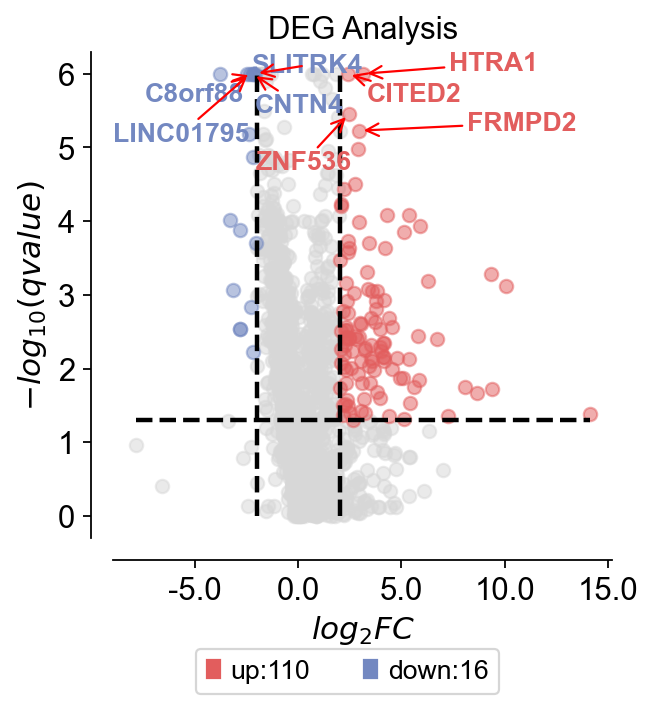

In [32]:
#rod与cpc
dds.plot_volcano(title='DEG Analysis',figsize=(4,4),
                 plot_genes_num=8,plot_genes_fontsize=12,)

## CNV

In [88]:
import infercnvpy as cnv

In [19]:
rb

AnnData object with n_obs × n_vars = 40611 × 20336
    obs: 'tissue', 'domain', 'sample', 'nUMIs', 'mito_perc', 'detected_genes', 'cell_complexity', 'doublet_score', 'predicted_doublet', 'passing_mt', 'passing_nUMIs', 'passing_ngenes', 'n_genes', 'leiden', 'celltype'
    var: 'feature_types', 'mt', 'n_cells', 'percent_cells', 'robust', 'mean', 'var', 'residual_variances', 'highly_variable_rank', 'highly_variable_features'
    uns: 'celltype_colors', 'cosg', 'dendrogram_leiden', 'hvg', 'layers_counts', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'rank_genes_groups', 'sample_colors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'scrublet', 'umap'
    obsm: 'X_mde_pca', 'X_mde_scVI', 'X_scVI', 'X_umap', 'scaled|original|X_pca'
    varm: 'scaled|original|pca_loadings'
    layers: 'counts', 'lognorm', 'scaled'
    obsp: 'connectivities', 'distances'

In [5]:
import scglue

In [7]:
scglue.data.get_gene_annotation(
    rb, gtf="/mnt/data/yihan/gencode.v45.basic.annotation.gtf.gz",
    gtf_by="gene_name"
)
rb.var.loc[:, ["chrom", "chromStart", "chromEnd"]].head()

,chrom,chromStart,chromEnd
MIR1302-2HG,chr1,29553.0,31109.0
AL627309.1,NaN,NaN,NaN
LINC00115,chr1,824227.0,827539.0
FAM41C,chr1,868070.0,876903.0
AL645608.7,NaN,NaN,NaN


In [8]:
import numpy as np
rb.var['dell']=np.zeros(len(rb.var))
a=rb.var[~rb.var['chromStart'].isnull()].index
rb.var.loc[a,'dell']=1
rb=rb[:,rb.var.dell==1]
rb.var = rb.var.astype({"chromStart": int, "chromEnd": int})
rb.var.loc[:, ["chrom", "chromStart", "chromEnd"]].head()

,chrom,chromStart,chromEnd
MIR1302-2HG,chr1,29553,31109
LINC00115,chr1,824227,827539
FAM41C,chr1,868070,876903
SAMD11,chr1,923922,944575
NOC2L,chr1,944202,959309


In [9]:
print('Raw adata.var.columns:',len(rb.var.columns))
for i in rb.var.columns:
    if rb.var[i].isnull().any():
        del rb.var[i]
print('Filtered adata.var.columns:',len(rb.var.columns))

Raw adata.var.columns: 29
Filtered adata.var.columns: 24


In [10]:
rb.var.rename(columns={"chrom":"chromosome","chromStart":"start","chromEnd":"end"},inplace=True)

In [11]:
rb.obs['celltype']

AAACCCACACACTTAG-1    Müller cells
AAACGCTAGGGTTGCA-1    Müller cells
AAAGGGCAGCCTTTCC-1            Cone
AAAGGTACAGCATACT-1             RPC
AAAGGTATCAGTGTGT-1            Cone
                          ...     
TTTGTTGTCCACATAG-1    Müller cells
TTTGTTGTCCCAACTC-1    Müller cells
TTTGTTGTCGAGATGG-1    Müller cells
TTTGTTGTCGTTCTGC-1             RPE
TTTGTTGTCTAGCCAA-1    Müller cells
Name: celltype, Length: 40611, dtype: category
Categories (12, object): ['AC', 'BC', 'Cone', 'Cone-tumor', ..., 'RPC', 'RPE', 'Rod', 'Rod-tumor']

In [12]:
rb.write_h5ad('/mnt/home/yihanzhao/RB/data_new/rb_chr.h5ad',compression='gzip')

... storing 'chromosome' as categorical
... storing 'score' as categorical
... storing 'strand' as categorical
... storing 'thickStart' as categorical
... storing 'thickEnd' as categorical
... storing 'itemRgb' as categorical
... storing 'blockCount' as categorical
... storing 'blockSizes' as categorical
... storing 'blockStarts' as categorical
... storing 'gene_type' as categorical


In [89]:
rb=sc.read_h5ad('/mnt/home/yihanzhao/RB/data_new/rb_chr.h5ad')

In [90]:
# We provide all immune cell types as "normal cells".
cnv.tl.infercnv(
    rb,
    reference_key="celltype",
    reference_cat=['Microglia'
    ],
    window_size=250,
)

  0%|          | 0/9 [00:00<?, ?it/s]

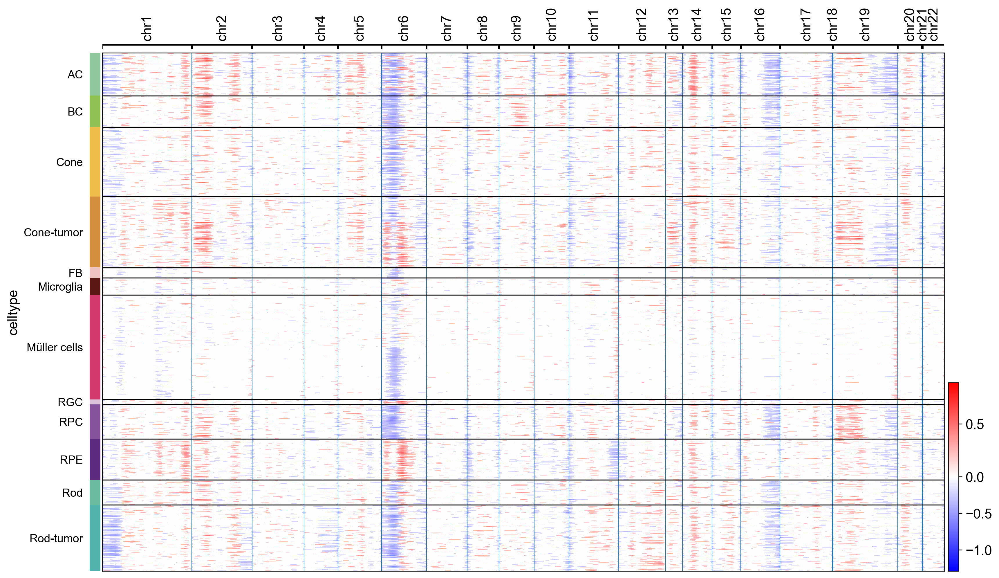

In [91]:
cnv.pl.chromosome_heatmap(rb, groupby="celltype")

In [92]:
rb

AnnData object with n_obs × n_vars = 40611 × 16801
    obs: 'tissue', 'domain', 'sample', 'nUMIs', 'mito_perc', 'detected_genes', 'cell_complexity', 'doublet_score', 'predicted_doublet', 'passing_mt', 'passing_nUMIs', 'passing_ngenes', 'n_genes', 'leiden', 'celltype'
    var: 'feature_types', 'mt', 'n_cells', 'percent_cells', 'robust', 'mean', 'var', 'residual_variances', 'highly_variable_features', 'chromosome', 'start', 'end', 'name', 'score', 'strand', 'thickStart', 'thickEnd', 'itemRgb', 'blockCount', 'blockSizes', 'blockStarts', 'gene_id', 'gene_type', 'dell'
    uns: 'celltype_colors', 'cosg', 'dendrogram_leiden', 'hvg', 'layers_counts', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'rank_genes_groups', 'sample_colors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'scrublet', 'umap', 'cnv'
    obsm: 'X_mde_pca', 'X_mde_scVI', 'X_scVI', 'X_umap', 'scaled|original|X_pca', 'X_cnv'
    varm: 'scaled|original|pca_loadings'
    lay

In [94]:
cnv.tl.pca(rb)
cnv.pp.neighbors(rb)
cnv.tl.leiden(rb)

computing PCA
    with n_comps=50
    finished (0:00:05)
computing neighbors
    finished: added to `.uns['cnv_neighbors']`
    `.obsp['cnv_neighbors_distances']`, distances for each pair of neighbors
    `.obsp['cnv_neighbors_connectivities']`, weighted adjacency matrix (0:00:31)
running Leiden clustering
    finished: found 20 clusters and added
    'cnv_leiden', the cluster labels (adata.obs, categorical) (0:00:04)


         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50
    finished (0:00:06)
Storing dendrogram info using `.uns['dendrogram_cnv_leiden']`
categories: 0, 1, 2, etc.
var_group_labels: chr1, chr2, chr3, etc.


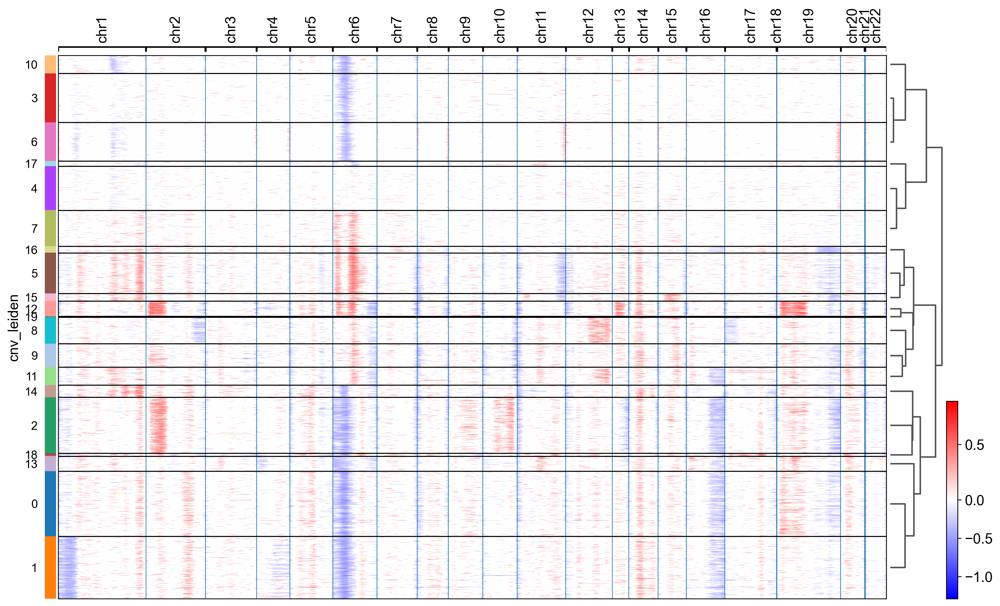

In [95]:
cnv.pl.chromosome_heatmap(rb, groupby="cnv_leiden", dendrogram=True)

In [96]:
cnv.tl.umap(rb)
cnv.tl.cnv_score(rb)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:20)


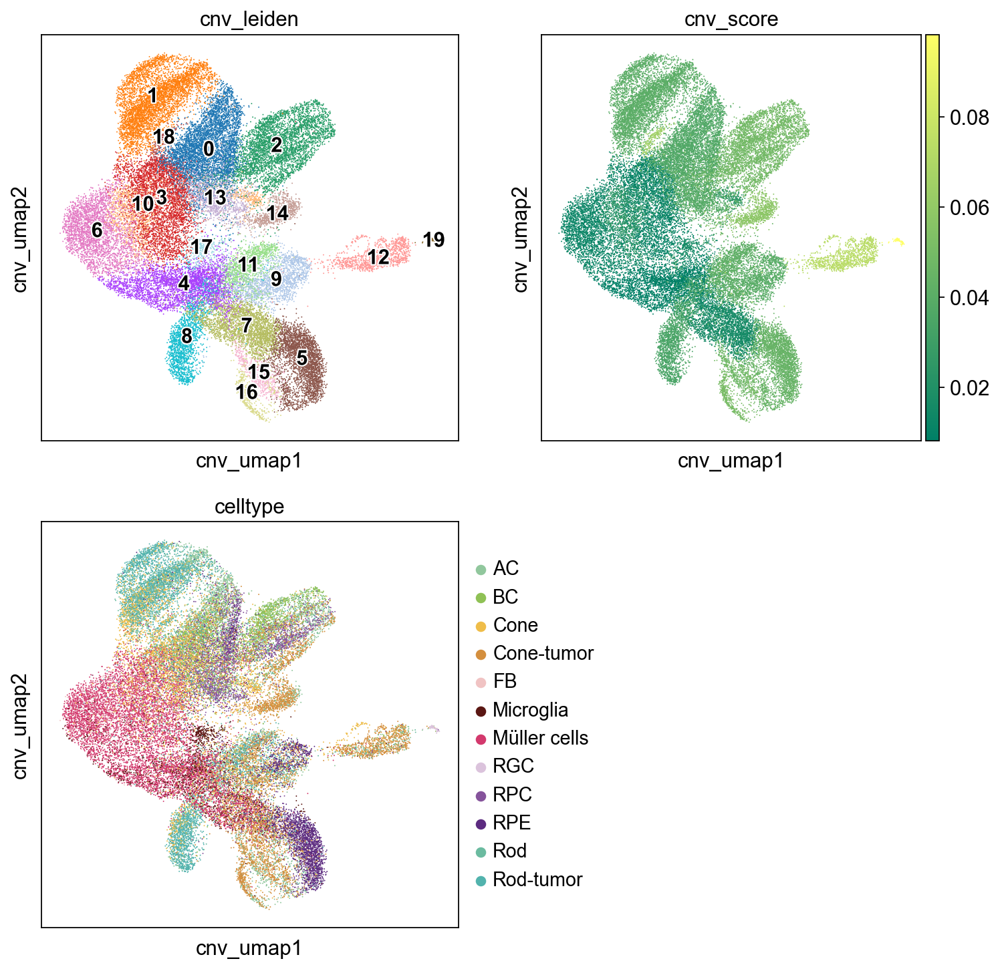

In [99]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(11, 11))
ax4.axis("off")
cnv.pl.umap(
    rb,
    color="cnv_leiden",
    legend_loc="on data",
    legend_fontoutline=2,
    ax=ax1,
    show=False,
)
cnv.pl.umap(rb, color="cnv_score",color_map='summer', ax=ax2, show=False)
cnv.pl.umap(rb, color="celltype", ax=ax3)

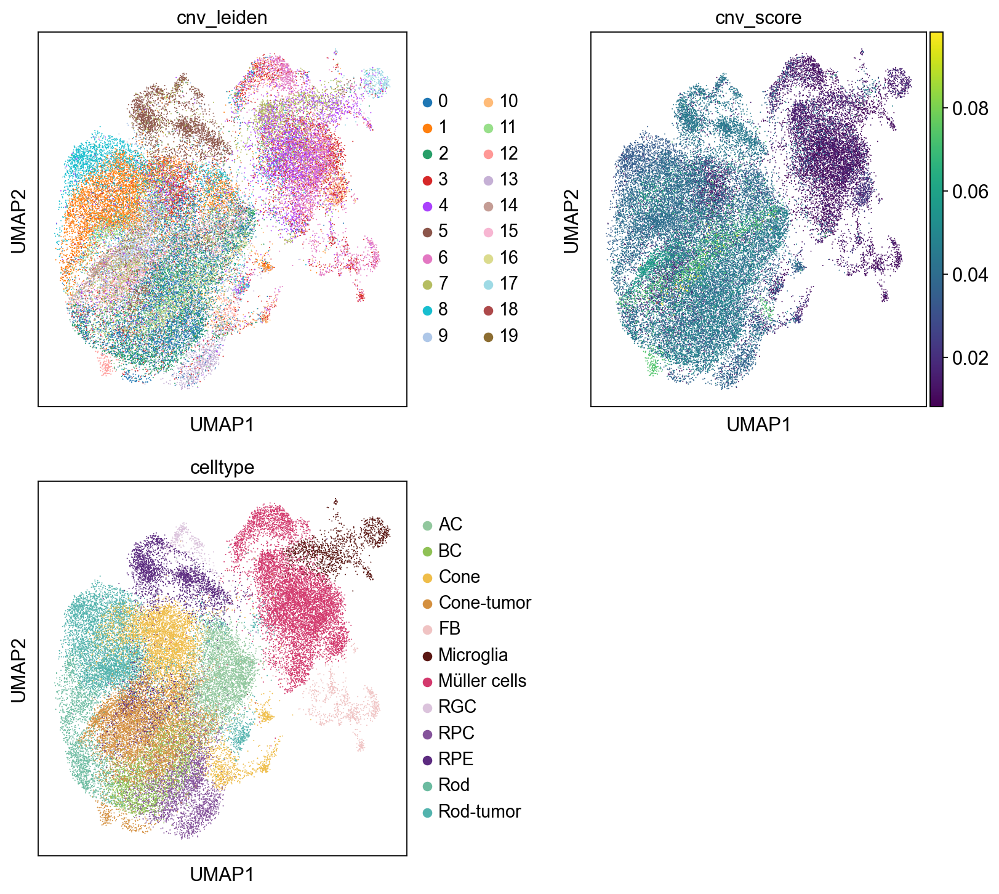

In [100]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(
    2, 2, figsize=(12, 11), gridspec_kw=dict(wspace=0.5)
)
ax4.axis("off")
sc.pl.umap(rb, color="cnv_leiden", ax=ax1, show=False)
sc.pl.umap(rb, color="cnv_score", ax=ax2, show=False)
sc.pl.umap(rb, color="celltype", ax=ax3)

In [101]:
adata=rb

In [110]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, facecolor="white")

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.9.1 pandas==1.5.3 scikit-learn==1.3.2 statsmodels==0.13.2 python-igraph==0.10.6 louvain==0.7.1 pynndescent==0.5.7


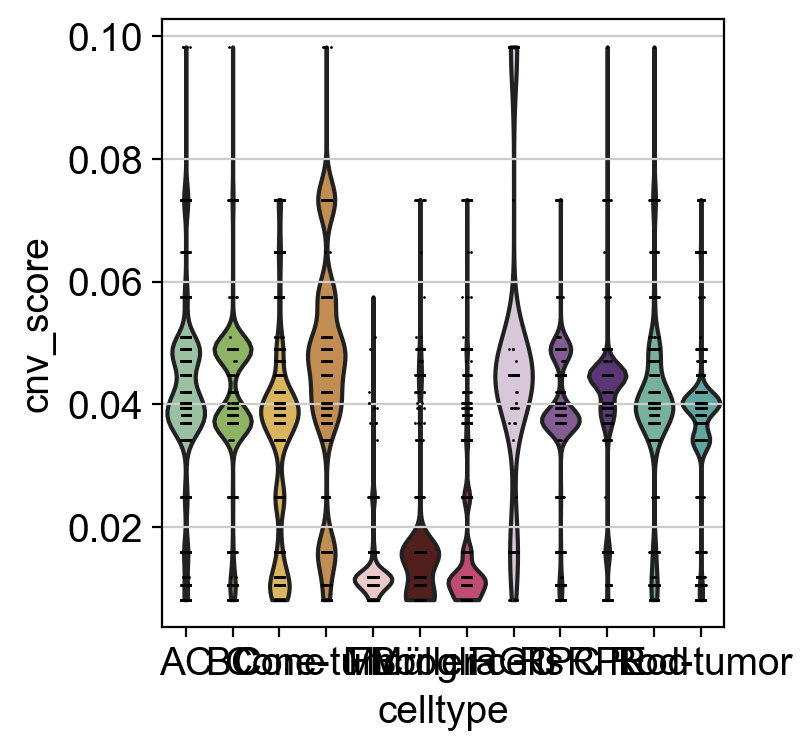

In [111]:
sc.pl.violin(adata, ["cnv_score"], groupby="celltype")

In [112]:
adata = adata[adata.obs['celltype']!='AC']
adata = adata[adata.obs['celltype']!='BC']
adata = adata[adata.obs['celltype']!='FB']
adata =adata[adata.obs['celltype']!='Microglia']
adata =adata[adata.obs['celltype']!='Müller cells']
adata =adata[adata.obs['celltype']!='RGC']
adata =adata[adata.obs['celltype']!='RPE']

In [113]:
rb_ganguang=sc.read_h5ad('/mnt/home/yihanzhao/RB/data_new/rb_via.h5ad')

In [115]:
new_index = ["cell_" + str(i) for i, _ in enumerate(adata.obs.index)]

adata.obs.index = new_index

In [116]:
rb_ganguang.obs['cnv_score']=adata.obs['cnv_score']

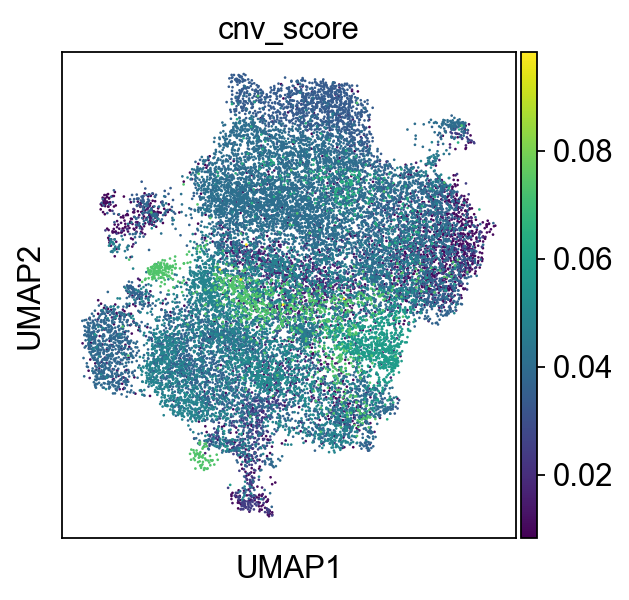

In [22]:
sc.pl.umap(rb_ganguang, color="cnv_score")

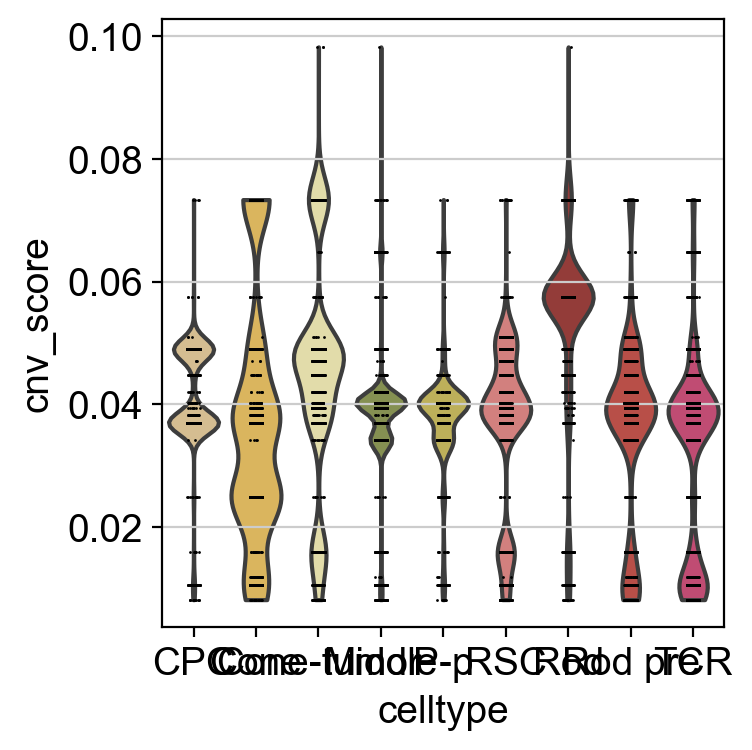

In [117]:
sc.pl.violin(rb_ganguang, ["cnv_score"], groupby="celltype")

In [39]:
rb_ganguang

AnnData object with n_obs × n_vars = 20843 × 20336
    obs: 'tissue', 'domain', 'sample', 'nUMIs', 'mito_perc', 'detected_genes', 'cell_complexity', 'doublet_score', 'predicted_doublet', 'passing_mt', 'passing_nUMIs', 'passing_ngenes', 'n_genes', 'leiden', 'celltype', 'cnv_leiden', 'cnv_score'
    var: 'feature_types', 'mt', 'n_cells', 'percent_cells', 'robust', 'mean', 'var', 'residual_variances', 'highly_variable_rank', 'highly_variable_features'
    uns: 'celltype_colors', 'cosg', 'dendrogram_leiden', 'hvg', 'layers_counts', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'rank_genes_groups', 'sample_colors', 'scaled|original|cum_sum_eigenvalues', 'scaled|original|pca_var_ratios', 'scrublet', 'umap'
    obsm: 'X_mde_pca', 'X_mde_scVI', 'X_scVI', 'X_umap', 'scaled|original|X_pca'
    varm: 'scaled|original|pca_loadings'
    layers: 'counts', 'lognorm', 'scaled'
    obsp: 'connectivities', 'distances'

<AxesSubplot: title={'center': 'celltype'}, xlabel='X_mde_scVI1', ylabel='X_mde_scVI2'>

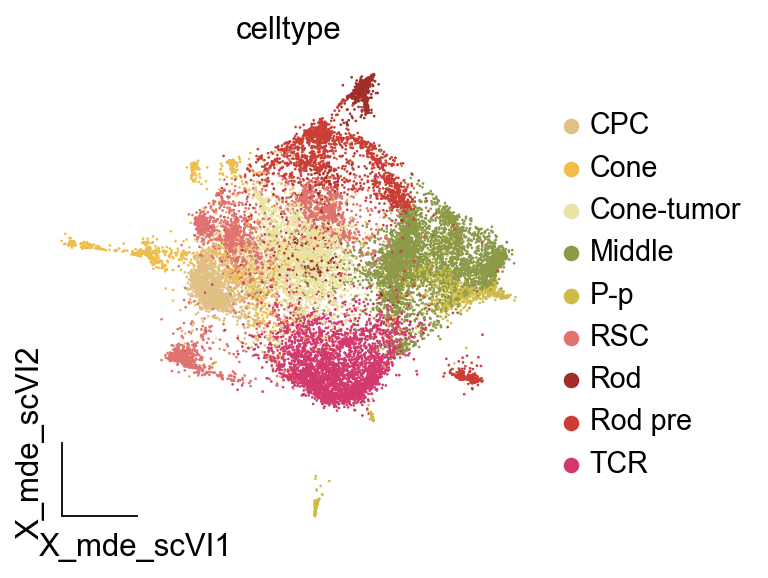

In [23]:
ov.utils.embedding(rb_ganguang,
                basis='X_mde_scVI',frameon='small',palette=ov.utils.orange_color[5:6]+ov.utils.orange_color[0:1]+ov.utils.orange_color[7:8]+ov.utils.orange_color[9:10]+ov.utils.orange_color[6:7]+ov.utils.red_color[1:2]+ov.utils.red_color[3:4]+ov.utils.red_color[2:3]+ov.utils.red_color[5:],
                color=['celltype'],show=False)

<AxesSubplot: title={'center': 'cnv_score'}, xlabel='X_mde_scVI1', ylabel='X_mde_scVI2'>

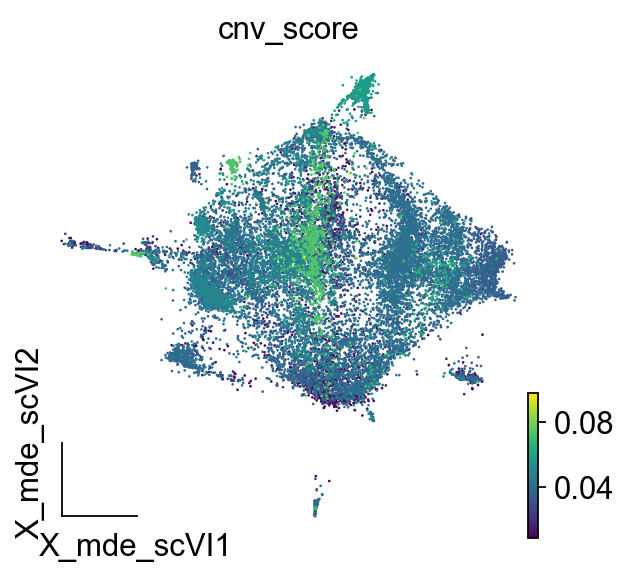

In [24]:
ov.utils.embedding(rb_ganguang,
                basis='X_mde_scVI',frameon='small',palette=ov.utils.orange_color[5:6]+ov.utils.orange_color[0:1]+ov.utils.orange_color[7:8]+ov.utils.orange_color[9:10]+ov.utils.orange_color[6:7]+ov.utils.red_color[1:2]+ov.utils.red_color[3:4]+ov.utils.red_color[2:3]+ov.utils.red_color[5:],
                color=['cnv_score'],show=False)